In [1]:
import numpy as np
import tensorflow as tf

In [2]:
import os
import pandas as pd
import cv2
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
from collections import Counter
import random

print("✅ NumPy:", np.__version__)
print("✅ TensorFlow:", tf.__version__)

✅ NumPy: 1.21.4
✅ TensorFlow: 2.6.0


## 시각화 가시성 개선

In [124]:
from IPython.display import display, HTML

# 주피터 노트북 셀 최대화 및 스크롤 제거
display(HTML("""
<style>
/* 컨테이너 최대화 */
.container {
    width: 100% !important;
    max-width: 100% !important;
}

/* 코드 셀 및 출력 영역 최대화 */
div.CodeMirror, div.output_area {
    max-width: 90% !important;
}

div.output_subarea {
    max-width: 100% !important;
    overflow: visible !important; /* 스크롤 대신 컨텐츠 모두 표시 */
}

/* 출력 영역 특별 처리 */
.output_wrapper {
    width: 100% !important;
    overflow: visible !important;
}

/* 그래프/이미지가 큰 경우에도 모두 표시 */
.output_png {
    display: block !important;
    width: auto !important;
    height: auto !important;
    max-width: 100% !important;
    overflow: visible !important;
}

/* 출력 영역 높이 제한 없애기 */
.output_scroll {
    height: auto !important;
    max-height: none !important;
}
</style>
"""))

# 현재 디렉토리에서 클래스 폴더만 추출하기

In [3]:
# 현재 디렉토리에서 '클래스 폴더'만 추출
exclude_dirs = ['Train_Test_Valid', '__MACOSX', '.ipynb_checkpoints']
class_dirs = [d for d in os.listdir('.') if os.path.isdir(d) and d not in exclude_dirs and not d.endswith('.zip')]

print(f"클래스 개수: {len(class_dirs)}")
print("클래스 목록:")
for cls in class_dirs:
    print(f" - {cls}")

클래스 개수: 8
클래스 목록:
 - blue_jellyfish
 - compass_jellyfish
 - lions_mane_jellyfish
 - Moon_jellyfish
 - models
 - barrel_jellyfish
 - mauve_stinger_jellyfish
 - __pycache__


# 클래스별 이미지 개수 시각화

- 모든 클래스의 이미지 개수가 거의 동일하게 분포
- 클래스 불균형 문제가 거의 없음 → 학습에 유리한 구조

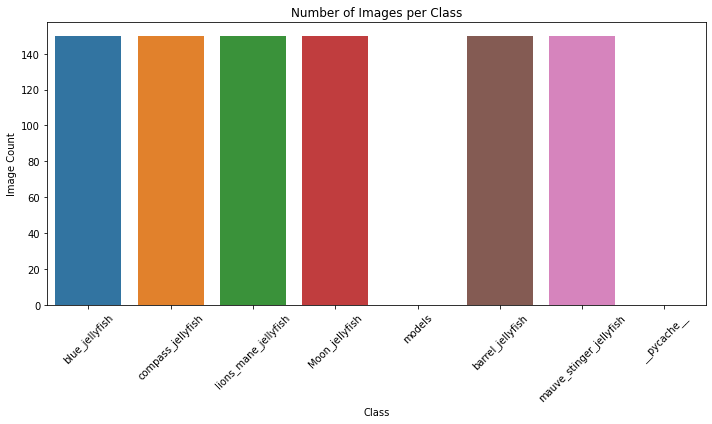

In [4]:
class_counts = {}

for cls in class_dirs:
    img_list = [f for f in os.listdir(cls) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    class_counts[cls] = len(img_list)

# DataFrame으로 변환 후 시각화
df_counts = pd.DataFrame(list(class_counts.items()), columns=['class', 'count'])

plt.figure(figsize=(10,6))
sns.barplot(data=df_counts, x='class', y='count')
plt.xticks(rotation=45)
plt.title("Number of Images per Class")
plt.xlabel("Class")
plt.ylabel("Image Count")
plt.tight_layout()
plt.show()

# 클래스별 샘플 이미지 몇 장씩 보기
- 배경이 다양하고, 일부는 수중 / 일부는 모래 위에 있음
- 각 해파리의 형태가 시각적으로 구별되는 경향이 있음

- 예: lions_mane_jellyfish는 촉수가 길고 풍성함
- blue_jellyfish는 푸른 색감이 뚜렷함
- Moon_jellyfish는 둥글고 반투명한 특징

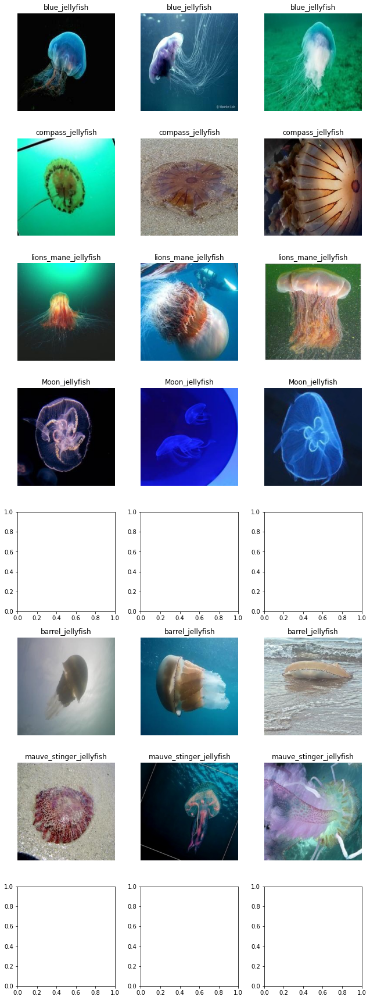

In [5]:
n_samples = 3  # 클래스당 몇 장 볼지
fig, axes = plt.subplots(len(class_dirs), n_samples, figsize=(n_samples*3, len(class_dirs)*3))

for row_idx, cls in enumerate(class_dirs):
    img_list = [f for f in os.listdir(cls) if f.lower().endswith(('.jpg', '.jpeg', '.png'))][:n_samples]
    for col_idx, img_name in enumerate(img_list):
        img_path = os.path.join(cls, img_name)
        image = Image.open(img_path)
        axes[row_idx, col_idx].imshow(image)
        axes[row_idx, col_idx].set_title(f"{cls}")
        axes[row_idx, col_idx].axis("off")

plt.tight_layout()
plt.show()


# 이미지 해상도 분포
- 224x224 해상도의 이미지가 가장 많음.
- 이 크기는 CNN 계열(특히 ResNet, VGG, MobileNet) 모델의 표준 입력 크기.

In [6]:
sizes = []

for cls in class_dirs:
    for img_name in os.listdir(cls):
        if img_name.lower().endswith(('.jpg', '.jpeg', '.png')):
            img_path = os.path.join(cls, img_name)
            try:
                with Image.open(img_path) as img:
                    sizes.append(img.size)
            except:
                print(f"열 수 없는 이미지: {img_path}")

# 가장 흔한 해상도 Top 10
common_sizes = Counter(sizes).most_common(10)
print("가장 흔한 이미지 해상도 Top 10:")
for size, count in common_sizes:
    print(f"{size} - {count}장")

가장 흔한 이미지 해상도 Top 10:
(224, 224) - 632장
(179, 179) - 268장


In [7]:
train_dir = "Train_Test_Valid/Train"
val_dir = "Train_Test_Valid/valid"
test_dir = "Train_Test_Valid/test"

img_size = (224, 224)
batch_size = 32

train_ds = tf.keras.preprocessing.image_dataset_from_directory(
    train_dir,
    image_size=img_size,
    batch_size=batch_size,
    shuffle=True,
    label_mode='categorical'
)

val_ds = tf.keras.preprocessing.image_dataset_from_directory(
    val_dir,
    image_size=img_size,
    batch_size=batch_size,
    label_mode='categorical'
)

test_ds = tf.keras.preprocessing.image_dataset_from_directory(
    test_dir,
    image_size=img_size,
    batch_size=batch_size,
    shuffle=False,
    label_mode='categorical'
)

Found 900 files belonging to 6 classes.
Found 39 files belonging to 6 classes.
Found 40 files belonging to 6 classes.


배치 이미지 shape: (32, 224, 224, 3)


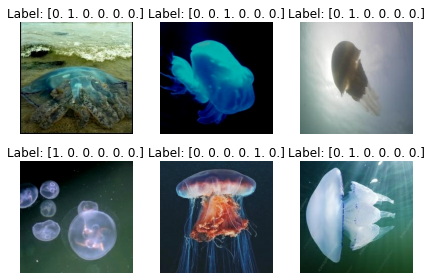

In [8]:
# train_ds에서 하나의 배치를 가져와 확인
for images, labels in train_ds.take(1):
    print(f"배치 이미지 shape: {images.shape}")  # → (batch_size, 224, 224, 3)

    for i in range(6):  # 앞의 6개 이미지만 시각화
        plt.subplot(2, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(f"Label: {labels[i].numpy()}")
        plt.axis("off")

    plt.tight_layout()
    plt.show()


# train/val/test 클래스 불균형 확인
- Valid, Test 매우 적음

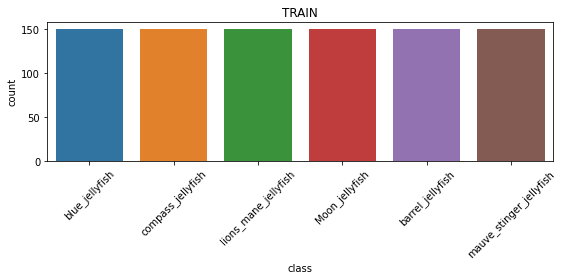

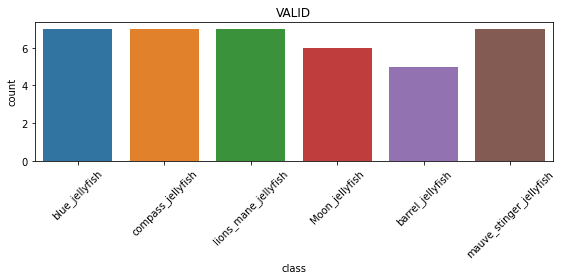

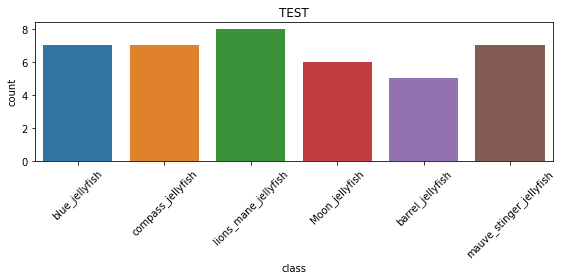

In [9]:
base = 'Train_Test_Valid'
splits = ['Train', 'valid', 'test']

for split in splits:
    split_dir = os.path.join(base, split)
    class_counts = {cls: len(os.listdir(os.path.join(split_dir, cls))) for cls in os.listdir(split_dir)}
    df = pd.DataFrame(list(class_counts.items()), columns=['class', 'count'])

    plt.figure(figsize=(8,4))
    sns.barplot(data=df, x='class', y='count')
    plt.title(f"{split.upper()}")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# 이미지 품질 분석

## 샤프닝

선택된 이미지 경로: blue_jellyfish/aug-39-54.jpg


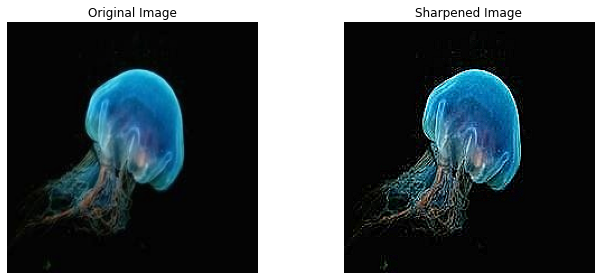

In [10]:
def sharpen_image(img_path, output_path=None):
    img = cv2.imread(img_path)
    if img is None:
        print(f"이미지를 불러오지 못했습니다: {img_path}")
        return

    # 샤프닝 커널 적용
    kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
    sharpened = cv2.filter2D(img, -1, kernel)

    # 결과 저장 여부
    if output_path:
        cv2.imwrite(output_path, sharpened)
        print(f"샤프닝 이미지 저장 완료: {output_path}")

    # BGR → RGB 변환
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    sharpened_rgb = cv2.cvtColor(sharpened, cv2.COLOR_BGR2RGB)

    # 이미지 시각화
    plt.figure(figsize=(10, 4))
    plt.subplot(1, 2, 1)
    plt.imshow(img_rgb)
    plt.title("Original Image")
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(sharpened_rgb)
    plt.title("Sharpened Image")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

cls = class_dirs[0]
img_list = [f for f in os.listdir(cls) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

if img_list:
    img_path = os.path.join(cls, img_list[0])
    print(f"선택된 이미지 경로: {img_path}")
    sharpen_image(img_path)
else:
    print(f"{cls} 폴더에 이미지가 없습니다.")


## 선명도(Blur 여부) 판단
### 값이 클수록 선명한 이미지, 작을수록 흐린 이미지

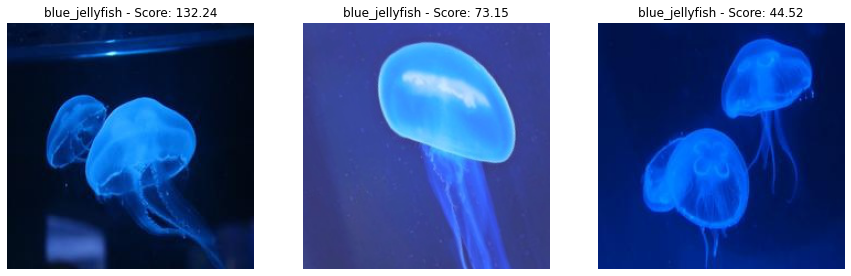

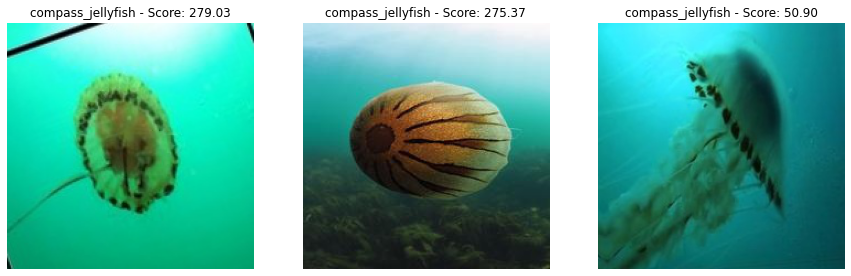

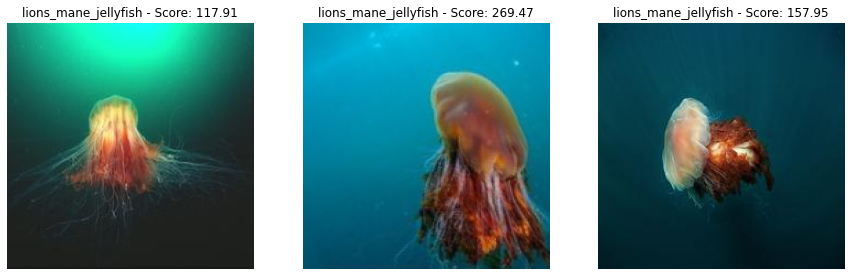

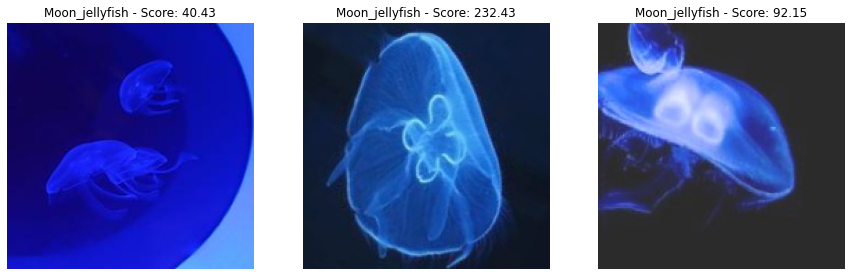

error: OpenCV(4.5.3) /tmp/pip-req-build-agffqapq/opencv/modules/imgproc/src/deriv.cpp:792: error: (-215:Assertion failed) !_src.empty() in function 'Laplacian'


In [11]:
def check_blurriness(img_path):
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    return cv2.Laplacian(img, cv2.CV_64F).var()

def show_blurry_images(species_dir, threshold=300):
    blurry_images = []
    for img_name in os.listdir(species_dir):
        img_path = os.path.join(species_dir, img_name)
        score = check_blurriness(img_path)
        if score < threshold:
            blurry_images.append((img_path, score))
    
    if blurry_images:
        plt.figure(figsize=(15, 5))
        for i, (img_path, score) in enumerate(blurry_images[:3]):
            img = Image.open(img_path)
            plt.subplot(1, 3, i+1)
            plt.imshow(img)
            plt.title(f"{os.path.basename(species_dir)} - Score: {score:.2f}")
            plt.axis('off')
        plt.show()

for species_dir in class_dirs:
    show_blurry_images(species_dir)


## 전경(해파리)과 배경의 선명도를 따로 측정하고 비교

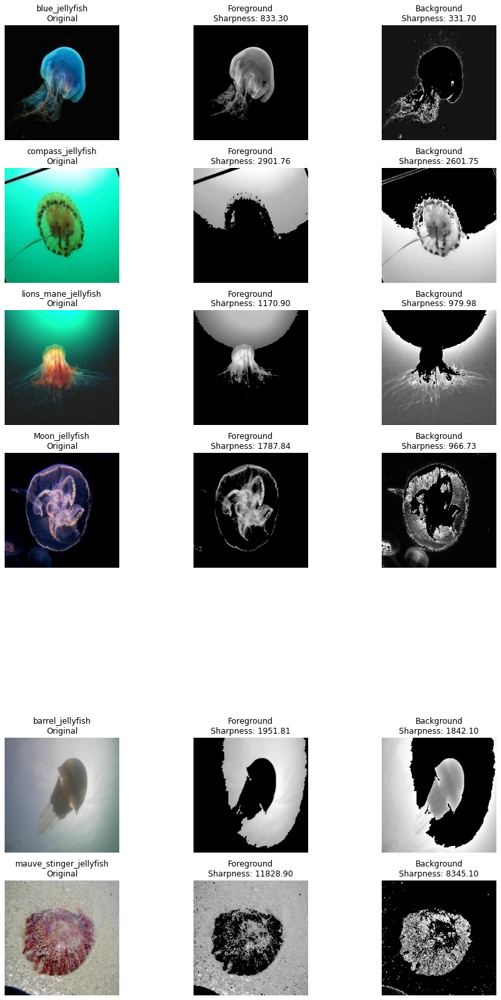

In [12]:
def analyze_foreground_background(img_path):
    img = cv2.imread(img_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    _, thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # 전경 / 배경 마스크 생성
    fg_mask = cv2.bitwise_and(gray, thresh)
    bg_mask = cv2.bitwise_and(gray, cv2.bitwise_not(thresh))

    # 전경 / 배경 선명도 계산
    foreground_var = cv2.Laplacian(fg_mask, cv2.CV_64F).var()
    background_var = cv2.Laplacian(bg_mask, cv2.CV_64F).var()

    return fg_mask, bg_mask, foreground_var, background_var, img

plt.figure(figsize=(12, 3 * len(class_dirs)))

for i, species_dir in enumerate(class_dirs):
    img_files = [f for f in os.listdir(species_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    if not img_files:
        continue

    img_path = os.path.join(species_dir, img_files[0])
    fg_mask, bg_mask, fg_var, bg_var, original = analyze_foreground_background(img_path)

    # 원본 이미지
    plt.subplot(len(class_dirs), 3, i * 3 + 1)
    plt.imshow(cv2.cvtColor(original, cv2.COLOR_BGR2RGB))
    plt.title(f"{os.path.basename(species_dir)}\nOriginal")
    plt.axis('off')

    # 전경 이미지
    plt.subplot(len(class_dirs), 3, i * 3 + 2)
    plt.imshow(fg_mask, cmap='gray')
    plt.title(f"Foreground\nSharpness: {fg_var:.2f}")
    plt.axis('off')

    # 배경 이미지
    plt.subplot(len(class_dirs), 3, i * 3 + 3)
    plt.imshow(bg_mask, cmap='gray')
    plt.title(f"Background\nSharpness: {bg_var:.2f}")
    plt.axis('off')

plt.tight_layout()
plt.show()


# 증강

## 각 종별 특성 강화

In [13]:
class JellyfishFeaturesAugmentation:
    """
    해파리 종별 특성을 강화하는 데이터 증강 전략
    각 종별 고유한 형태적 특징을 강조하여 분류 성능 향상
    """
    
    def __init__(self, p=0.8):
        """
        매개변수:
            p: 증강이 적용될 확률
        """
        self.p = p
        self.species_dict = {
            "moon": "Moon jellyfish (Aurelia aurita)",
            "barrel": "Barrel jellyfish (Rhizostoma pulmo)",
            "blue": "Blue jellyfish (Cyanea lamarckii)",
            "compass": "Compass jellyfish (Chrysaora hysoscella)",
            "lions_mane": "Lion's mane jellyfish (Cyanea capillata)",
            "mauve_stinger": "Mauve stinger (Pelagia noctiluca)"
        }
        
    def enhance_moon_jellyfish(self, image, intensity=0.3):
        """
        Moon jellyfish (Aurelia aurita) 특성 강화
        - 반투명한 몸통과 4개의 말발굽 모양 생식선 강조
        - 특징: 투명도, 원형 패턴, 생식선 가시성
        - 강화할 특징: 높은 RGB 밝기, 투명도, 엣지.
        """
        result = image.copy().astype(np.uint8)

        # 1. 밝기 증가
        gamma = 1.0 - intensity * 0.3
        inv_gamma = 1.0 / gamma
        table = np.array([(i / 255.0) ** inv_gamma * 255 for i in range(256)]).astype("uint8")
        result = cv2.LUT(result, table)

        # 2. 투명도 효과 (채도 감소)
        hsv = cv2.cvtColor(result, cv2.COLOR_RGB2HSV)
        hsv[:, :, 1] = hsv[:, :, 1] * (1 - intensity * 0.5)
        hsv[:, :, 2] = np.clip(hsv[:, :, 2] * (1 + intensity * 0.2), 0, 255)
        result = cv2.cvtColor(hsv.astype(np.uint8), cv2.COLOR_HSV2RGB)

        # 3. 엣지 강조
        edges = cv2.Canny(cv2.cvtColor(result, cv2.COLOR_RGB2GRAY), 50, 150)
        edges_rgb = cv2.cvtColor(edges, cv2.COLOR_GRAY2RGB)
        result = cv2.addWeighted(result, 1.0, edges_rgb, intensity * 0.2, 0)

        return result
    
    def enhance_barrel_jellyfish(self, image, intensity=0.3):
        """
        Barrel jellyfish (Rhizostoma pulmo) 특성 강화
        - 크고 둥근 형태, 두꺼운 몸체 강조
        - 특징: 크기, 부피감, 견고한 형태
        - 강화할 특징: 높은 RGB 밝기, 선명도.
        """
        result = image.copy().astype(np.uint8)

        # 1. 밝기 증가 (Gamma 보정)
        gamma = 1.0 - intensity * 0.4
        inv_gamma = 1.0 / gamma
        table = np.array([(i / 255.0) ** inv_gamma * 255 for i in range(256)]).astype("uint8")
        result = cv2.LUT(result, table)

        # 2. 대비 증가
        result = tf.image.adjust_contrast(result, 1 + intensity * 0.5).numpy().astype(np.uint8)

        # 3. 샤프닝
        sharpen_kernel = np.array([[-1, -1, -1],
                                    [-1, 9, -1],
                                    [-1, -1, -1]])
        sharpened = cv2.filter2D(result, -1, sharpen_kernel * intensity)
        result = cv2.addWeighted(result, 1 - intensity, sharpened, intensity, 0)
        
        return result
    
    def enhance_blue_jellyfish(self, image, intensity=0.3):
        """
        Blue jellyfish (Cyanea lamarckii) 특성 강화
        - 푸른색 색조가 강한 해파리
        - 특징: 푸른색, 중간 크기 형태
        - 강화할 특징: B 색상, 낮은 엣지.
        """
        result = image.copy().astype(np.uint8)

        # 1. B 채널 CLAHE
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        result[:, :, 2] = clahe.apply(result[:, :, 2])  # B 채널

        # 2. Gaussian Blur (엣지 부드럽게)
        blurred = cv2.GaussianBlur(result, (5, 5), sigmaX=1.5 * intensity)
        result = cv2.addWeighted(result, 1 - intensity, blurred, intensity, 0)

        return result
    
    def enhance_compass_jellyfish(self, image, intensity=0.3):
        """
        Compass jellyfish (Chrysaora hysoscella) 특성 강화
        - 몸통의 갈색 나침반 모양 패턴이 특징
        - 특징: 독특한 나침반 무늬, 갈색 패턴
        - 강화할 특징: G/R 색상, 선명도.
        """
        result = image.copy().astype(np.uint8)

        # 1. G/R 채널 CLAHE 적용
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        for c in [0, 1]:  # R, G 채널
            result[:, :, c] = clahe.apply(result[:, :, c])

        # 2. 샤프닝 필터
        sharpen_kernel = np.array([[-1, -1, -1],
                                    [-1, 9, -1],
                                    [-1, -1, -1]])
        sharpened = cv2.filter2D(result, -1, sharpen_kernel * intensity)

        # 3. 블렌딩
        result = cv2.addWeighted(result, 1 - intensity, sharpened, intensity, 0)
        
        return result
    
    def enhance_lions_mane_jellyfish(self, image, intensity=0.3):
        """
        Lion's mane jellyfish (Cyanea capillata) 특성 강화
        - 세계에서 가장 큰 해파리, 긴 촉수가 특징
        - 특징: 크기, 붉은 색조, 많은 촉수
        - 강화할 특징: G 색상, 높은 선명도.
        """
        result = image.copy().astype(np.uint8)

        # 1. G 채널 CLAHE
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        result[:, :, 1] = clahe.apply(result[:, :, 1])  # G 채널

        # 2. 강한 샤프닝
        sharpen_kernel = np.array([[-1, -1, -1],
                                    [-1, 10, -1],
                                    [-1, -1, -1]])
        sharpened = cv2.filter2D(result, -1, sharpen_kernel * (intensity + 0.2))
        result = cv2.addWeighted(result, 1 - intensity, sharpened, intensity, 0)

        return result
    
    def enhance_mauve_stinger(self, image, intensity=0.3):
        """
        Mauve stinger (Pelagia noctiluca) 특성 강화
        - 작은 해파리, 긴 촉수와 독을 쏘는 세포가 있는 혹 구조
        - 특징: 자주색 색조, 작은 크기, 표면의 혹 모양 구조
        - 강화할 특징: 엣지, 중간 밝기 RGB.
        """
        result = image.copy().astype(np.uint8)

        # 1. 밝기 증가
        gamma = 1.0 - intensity * 0.3
        inv_gamma = 1.0 / gamma
        table = np.array([(i / 255.0) ** inv_gamma * 255 for i in range(256)]).astype("uint8")
        result = cv2.LUT(result, table)

        # 2. 엣지 강조 (Canny)
        gray = cv2.cvtColor(result, cv2.COLOR_RGB2GRAY)
        edges = cv2.Canny(gray, 50, 150)
        edges_rgb = cv2.cvtColor(edges, cv2.COLOR_GRAY2RGB)
        result = cv2.addWeighted(result, 1.0, edges_rgb, intensity * 0.2, 0)
        
        return result
    
    def apply(self, image, species=None, intensity=0.3):
        """
        이미지에 해파리 종별 특성 강화 효과 적용
        
        매개변수:
            image: 입력 이미지
            species: 해파리 종류 ('moon', 'barrel', 'blue', 'compass', 'lions_mane', 'mauve_stinger')
                    None이면 무작위 선택
            intensity: 효과 강도 (0.0 ~ 1.0)
        """
        if random.random() > self.p:
            return image
            
        result = image.copy()
        
        # 종이 지정되지 않은 경우 무작위 선택
        if species is None:
            species = random.choice(list(self.species_dict.keys()))
            
        # 종에 따른 강화 함수 적용
        if species == 'moon':
            result = self.enhance_moon_jellyfish(result, intensity)
        elif species == 'barrel':
            result = self.enhance_barrel_jellyfish(result, intensity)
        elif species == 'blue':
            result = self.enhance_blue_jellyfish(result, intensity)
        elif species == 'compass':
            result = self.enhance_compass_jellyfish(result, intensity)
        elif species == 'lions_mane':
            result = self.enhance_lions_mane_jellyfish(result, intensity)
        elif species == 'mauve_stinger':
            result = self.enhance_mauve_stinger(result, intensity)
            
        return result
    
    def visualize_enhancements(self, image, figsize=(15, 12)):
        """
        각 해파리 종별 특성 강화 효과 시각화
        """
        species_list = list(self.species_dict.keys())
        
        plt.figure(figsize=figsize)
        
        # 원본 이미지 표시
        plt.subplot(3, 3, 1)
        plt.imshow(image)
        plt.title("Original")
        plt.axis('off')
        
        # 각 종별 특성 강화 적용 및 시각화
        for i, species in enumerate(species_list):
            plt.subplot(3, 3, i + 2)
            enhanced = self.apply(image.copy(), species, intensity=0.4)
            plt.imshow(enhanced)
            plt.title(self.species_dict[species])
            plt.axis('off')
            
        plt.tight_layout()
        plt.show()
    
    def visualize_intensity_levels(self, image, species):
        """
        특정 종에 대한 다양한 강도 수준의 증강 효과 시각화
        """
        intensities = [0.1, 0.2, 0.3, 0.4, 0.5, 0.7]
        
        plt.figure(figsize=(15, 8))
        
        # 원본 이미지 표시
        plt.subplot(2, 4, 1)
        plt.imshow(image)
        plt.title("Original")
        plt.axis('off')
        
        # 다양한 강도 수준 적용 및 시각화
        for i, intensity in enumerate(intensities):
            plt.subplot(2, 4, i + 2)
            enhanced = self.apply(image.copy(), species, intensity=intensity)
            plt.imshow(enhanced)
            plt.title(f"Intensity: {intensity}")
            plt.axis('off')
            
        plt.suptitle(f"Feature Enhancement for {self.species_dict[species]}", fontsize=16)
        plt.tight_layout()
        plt.show()


In [14]:
# 사용 예시
def demo_feature_enhancement(image_path):
    """
    해파리 종별 특성 강화 데모 함수
    """
    # 이미지 로드
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # 증강기 초기화
    augmenter = JellyfishFeaturesAugmentation(p=1.0)
    
    # 모든 종에 대한 특성 강화 시각화
    augmenter.visualize_enhancements(image)
    
    # 특정 종에 대한 다양한 강도 시각화
    augmenter.visualize_intensity_levels(image, 'compass')

    
# 배치 데이터에 증강 적용 예시
def apply_batch_enhancement(images, labels, species_mapping):
    """
    배치 데이터에 종별 맞춤형 증강 적용
    
    매개변수:
        images: 이미지 배치
        labels: 레이블 배치
        species_mapping: 레이블 인덱스와 종 이름 매핑 딕셔너리
    """
    augmenter = JellyfishFeaturesAugmentation(p=0.7)
    enhanced_images = []
    
    for img, label in zip(images, labels):
        # 레이블 인덱스에 해당하는 종 이름 확인
        species_key = species_mapping[label]
        
        # 종별 맞춤형 증강 적용
        enhanced = augmenter.apply(img, species=species_key)
        enhanced_images.append(enhanced)
    
    return np.array(enhanced_images)


# Albumentations와 함께 사용하는 예시
def get_feature_enhancement_transform(species=None):
    """
    ㅠ 변환과 결합된 특성 강화 증강 생성
    
    매개변수:
        species: 특정 종 지정 (None이면 무작위)
    """
    augmenter = JellyfishFeaturesAugmentation(p=0.7)
    
    transform = A.Compose([
        # 기본 기하학적 변환
        A.RandomRotate90(),
        A.ShiftScaleRotate(shift_limit=0.1, scale_limit=0.1, rotate_limit=45, p=0.7),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
        
        # 커스텀 증강 적용 (Lambda 사용)
        A.Lambda(image=lambda img, **kwargs: augmenter.apply(img, species=species)),
        
        # 최종 정규화
        A.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])
    
    return transform


# TensorFlow 데이터 파이프라인에서 사용하는 예시
def jellyfish_feature_enhancement_tf(image, label, species_mapping):
    """
    TensorFlow 데이터 파이프라인에서 사용 가능한 증강 래퍼
    
    매개변수:
        image: 입력 이미지 텐서
        label: 레이블 텐서
        species_mapping: 레이블 인덱스와 종 이름 매핑 딕셔너리
    """
    augmenter = JellyfishFeaturesAugmentation(p=0.7)
    
    # 레이블에 따른 종 확인
    species_key = species_mapping[label.numpy()]
    
    # numpy 배열로 변환하여 증강 적용
    image_np = image.numpy()
    enhanced_np = augmenter.apply(image_np, species=species_key)
    
    # 텐서로 다시 변환
    enhanced = tf.convert_to_tensor(enhanced_np, dtype=tf.float32)
    
    return enhanced, label

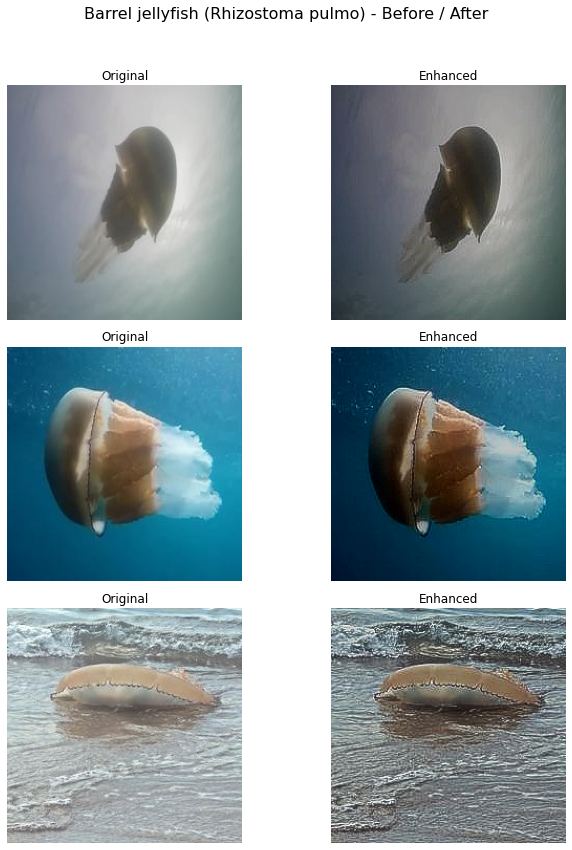

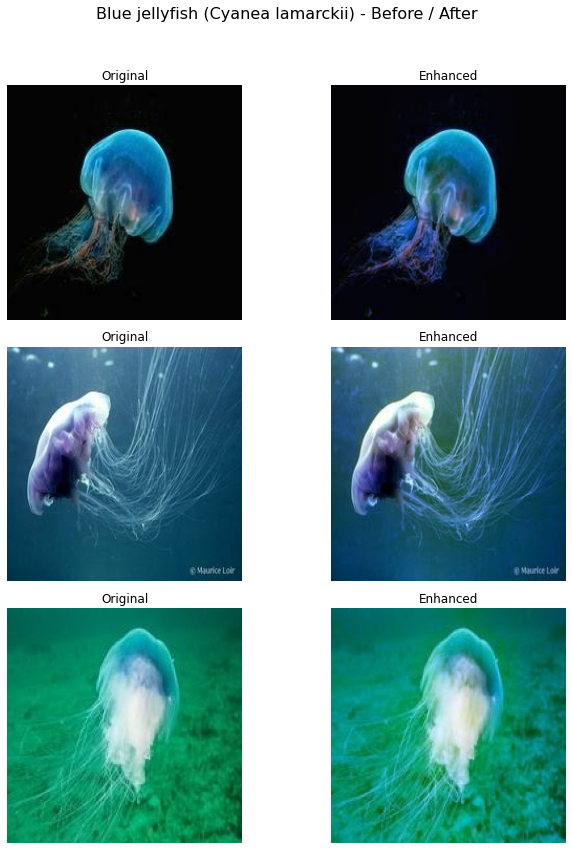

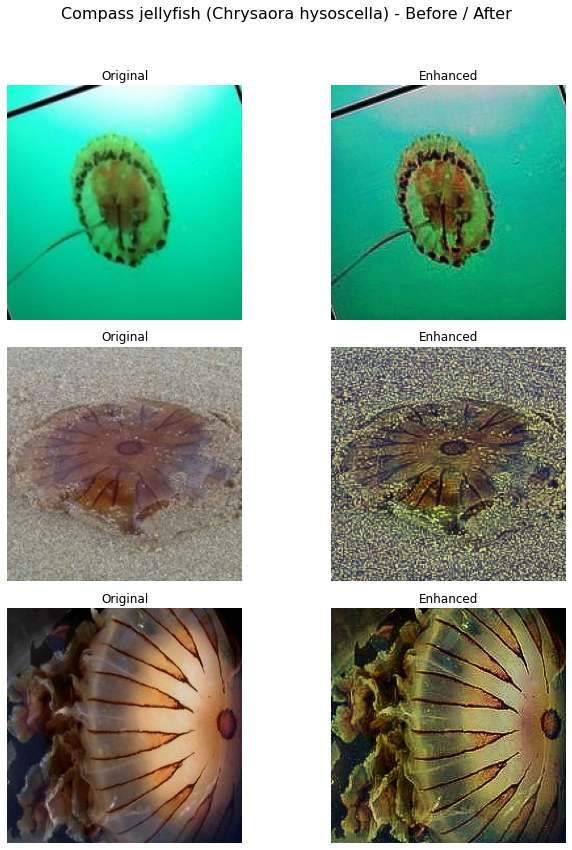

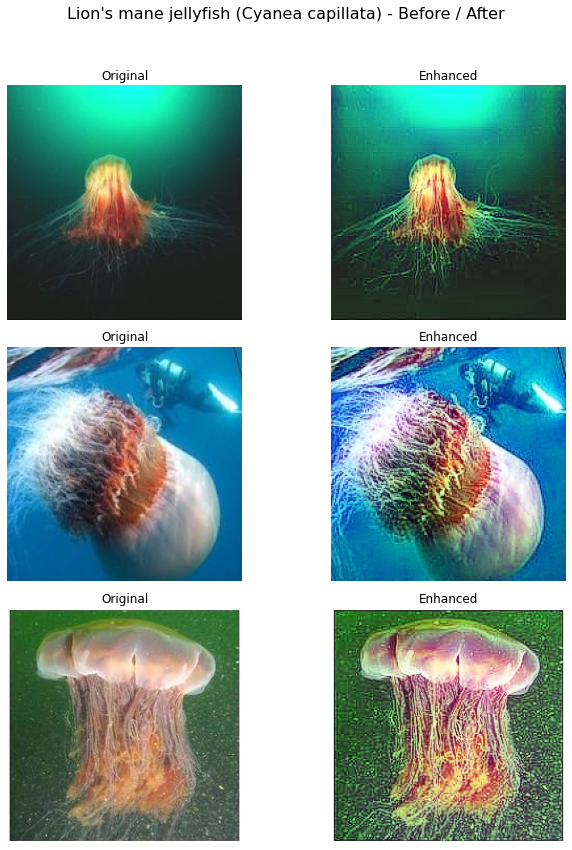

In [15]:
# 객체 생성
augmenter = JellyfishFeaturesAugmentation(p=1.0)  # 항상 적용

# 폴더명 → species 키 매핑
folder_to_species_key = {
    'moon_jellyfish': 'moon',
    'barrel_jellyfish': 'barrel',
    'blue_jellyfish': 'blue',
    'compass_jellyfish': 'compass',
    'lions_mane_jellyfish': 'lions_mane',
    'mauve_stinger': 'mauve_stinger'
}

def show_before_after_species(base_dir, samples_per_class=3, figsize=(10, 12)):
    for folder_name in sorted(folder_to_species_key.keys()):
        species_key = folder_to_species_key[folder_name]
        species_dir = os.path.join(base_dir, folder_name)
        
        if not os.path.isdir(species_dir):
            continue
        
        img_files = [f for f in os.listdir(species_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
        img_files = img_files[:samples_per_class]
        
        if len(img_files) == 0:
            continue
        
        plt.figure(figsize=figsize)
        plt.suptitle(f"{augmenter.species_dict[species_key]} - Before / After", fontsize=16)
        
        for i, img_name in enumerate(img_files):
            img_path = os.path.join(species_dir, img_name)
            img = cv2.imread(img_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            
            # Before
            plt.subplot(samples_per_class, 2, 2*i + 1)
            plt.imshow(img)
            plt.title("Original")
            plt.axis("off")
            
            # After
            enhanced = augmenter.apply(img, species=species_key, intensity=0.4)
            plt.subplot(samples_per_class, 2, 2*i + 2)
            plt.imshow(enhanced)
            plt.title("Enhanced")
            plt.axis("off")
        
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()

# 사용
show_before_after_species(base_dir="/aiffel/aiffel/jellyfish", samples_per_class=3)


## 기하학적 증강 (회전 등)

In [16]:
class JellyfishGeometricAugmentation:
    """
    해파리 분류를 위한 기본 기하학적 변환 증강 전략
    방향성이 없는 해파리의 특성을 고려한 회전, 뒤집기, 이동 등 변환
    """
    
    def __init__(self, p=0.8):
        """
        매개변수:
            p: 증강이 적용될 확률
        """
        self.p = p
        
    def rotate(self, image, angle_range=(-180, 180)):
        """
        이미지 회전
        해파리는 방향성이 없으므로 완전한 360도 회전 가능
        
        매개변수:
            image: 입력 이미지
            angle_range: 회전 각도 범위 (기본값: -180 ~ 180도)
        """
        angle = random.uniform(angle_range[0], angle_range[1])
        h, w = image.shape[:2]
        center = (w // 2, h // 2)
        
        # 회전 행렬 생성
        M = cv2.getRotationMatrix2D(center, angle, 1.0)
        
        # 회전 적용
        rotated = cv2.warpAffine(image, M, (w, h), borderMode=cv2.BORDER_REFLECT)
        
        return rotated
    
    def flip(self, image, mode='random'):
        """
        이미지 뒤집기
        해파리는 방향성이 없으므로 수평/수직 모두 자연스러움
        
        매개변수:
            image: 입력 이미지
            mode: 뒤집기 모드 ('horizontal', 'vertical', 'both', 'random')
        """
        # 모드 선택
        if mode == 'random':
            mode = random.choice(['horizontal', 'vertical', 'both'])
            
        if mode == 'horizontal':
            flipped = cv2.flip(image, 1)  # 수평 뒤집기
        elif mode == 'vertical':
            flipped = cv2.flip(image, 0)  # 수직 뒤집기
        elif mode == 'both':
            flipped = cv2.flip(image, -1)  # 수평 및 수직 뒤집기
        else:
            flipped = image  # 기본값
            
        return flipped
    
    def shift(self, image, shift_range=(-0.2, 0.2)):
        """
        이미지 이동
        해파리는 수중에서 자유롭게 이동하므로 다양한 위치 가능
        
        매개변수:
            image: 입력 이미지
            shift_range: 이동 범위 비율 (이미지 크기 대비)
        """
        h, w = image.shape[:2]
        
        # 이동량 계산 (픽셀 단위)
        tx = int(w * random.uniform(shift_range[0], shift_range[1]))
        ty = int(h * random.uniform(shift_range[0], shift_range[1]))
        
        # 이동 행렬 생성
        M = np.float32([[1, 0, tx], [0, 1, ty]])
        
        # 이동 적용
        shifted = cv2.warpAffine(image, M, (w, h), borderMode=cv2.BORDER_REFLECT)
        
        return shifted
    
    def zoom(self, image, zoom_range=(0.8, 1.2)):
        """
        확대/축소
        수중 거리에 따른 해파리 크기 변화 시뮬레이션
        
        매개변수:
            image: 입력 이미지
            zoom_range: 확대/축소 비율 범위
        """
        h, w = image.shape[:2]
        
        # 확대/축소 비율 선택
        scale = random.uniform(zoom_range[0], zoom_range[1])
        
        # 중심점
        center_x, center_y = w // 2, h // 2
        
        # 변환 행렬 생성
        M = cv2.getRotationMatrix2D((center_x, center_y), 0, scale)
        
        # 확대/축소 적용
        zoomed = cv2.warpAffine(image, M, (w, h), borderMode=cv2.BORDER_REFLECT)
        
        return zoomed
    
    def shear(self, image, shear_range=(-0.2, 0.2)):
        """
        전단 변환
        해파리의 유연한 움직임 시뮬레이션
        
        매개변수:
            image: 입력 이미지
            shear_range: 전단 변환 강도 범위
        """
        h, w = image.shape[:2]
        
        # 전단 변환 강도 선택
        shear_factor = random.uniform(shear_range[0], shear_range[1])
        
        # 변환 행렬 생성
        M = np.float32([[1, shear_factor, 0], [0, 1, 0]])
        
        # 전단 변환 적용
        sheared = cv2.warpAffine(image, M, (w, h), borderMode=cv2.BORDER_REFLECT)
        
        return sheared
    
    def elastic_transform(self, image, alpha=50, sigma=5, alpha_affine=20):
        """
        탄성 변환 - OpenCV의 remap 함수를 사용한 새 구현
        해파리의 유연한 움직임과 수축/이완 시뮬레이션
        
        매개변수:
            image: 입력 이미지
            alpha: 변위 정도
            sigma: 변위의 평활도
            alpha_affine: 아핀 변환 정도
        """
        # 이미지 크기
        height, width = image.shape[:2]
        
        # 임의의 변위 필드 생성
        random_state = np.random.RandomState(None)
        dx = random_state.rand(height, width) * 2 - 1
        dy = random_state.rand(height, width) * 2 - 1
        
        # 가우시안 필터로 변위 필드 스무딩
        dx = cv2.GaussianBlur(dx.astype(np.float32), (0, 0), sigma) * alpha
        dy = cv2.GaussianBlur(dy.astype(np.float32), (0, 0), sigma) * alpha
        
        # 좌표 매핑을 위한 meshgrid 생성
        x, y = np.meshgrid(np.arange(width), np.arange(height))
        
        # 변위 필드 적용
        map_x = np.clip(x + dx, 0, width - 1).astype(np.float32)
        map_y = np.clip(y + dy, 0, height - 1).astype(np.float32)
        
        # remap 함수를 사용하여 이미지 변형
        distorted = cv2.remap(image, map_x, map_y, 
                              interpolation=cv2.INTER_LINEAR, 
                              borderMode=cv2.BORDER_REFLECT_101)
        
        return distorted
    
    def radial_distortion(self, image, distortion_range=(-0.3, 0.3)):
        """
        방사형 왜곡
        수중 촬영 시 발생하는 렌즈 왜곡 시뮬레이션
        
        매개변수:
            image: 입력 이미지
            distortion_range: 왜곡 강도 범위
        """
        h, w = image.shape[:2]
        
        # 왜곡 계수 선택
        k = random.uniform(distortion_range[0], distortion_range[1])
        
        # 이미지 중심점
        cx, cy = w / 2, h / 2
        
        # 새 이미지 생성
        distorted = np.zeros_like(image)
        
        # 각 픽셀에 왜곽 적용
        for y in range(h):
            for x in range(w):
                # 중심으로부터의 정규화된 좌표
                nx = (x - cx) / cx
                ny = (y - cy) / cy
                
                # 반지름
                r = np.sqrt(nx**2 + ny**2)
                
                # 방사형 왜곡 적용
                if r > 0:
                    theta = np.arctan2(ny, nx)
                    r_distorted = r * (1 + k * r**2)
                    
                    # 왜곡된 좌표
                    dx = cx + cx * r_distorted * np.cos(theta)
                    dy = cy + cy * r_distorted * np.sin(theta)
                    
                    # 범위 내에 있는지 확인
                    if 0 <= dx < w and 0 <= dy < h:
                        # 이중 선형 보간
                        x1, y1 = int(dx), int(dy)
                        x2, y2 = min(x1 + 1, w - 1), min(y1 + 1, h - 1)
                        
                        # 가중치
                        wx = dx - x1
                        wy = dy - y1
                        
                        # 이중 선형 보간으로 픽셀값 계산
                        for c in range(3):  # RGB 채널
                            value = (1 - wx) * (1 - wy) * image[y1, x1, c] + \
                                    wx * (1 - wy) * image[y1, x2, c] + \
                                    (1 - wx) * wy * image[y2, x1, c] + \
                                    wx * wy * image[y2, x2, c]
                            distorted[y, x, c] = value
        
        return distorted
    
    def perspective_transform(self, image, intensity=0.1):
        """
        원근 변환
        다양한 시점에서 촬영된 해파리 시뮬레이션
        
        매개변수:
            image: 입력 이미지
            intensity: 변환 강도
        """
        h, w = image.shape[:2]
        
        # 원본 이미지의 코너 좌표
        pts1 = np.float32([[0, 0], [w, 0], [0, h], [w, h]])
        
        # 변환될 좌표 (약간의 랜덤 변위 추가)
        shift = w * intensity
        pts2 = np.float32([
            [random.uniform(0, shift), random.uniform(0, shift)],
            [random.uniform(w - shift, w), random.uniform(0, shift)],
            [random.uniform(0, shift), random.uniform(h - shift, h)],
            [random.uniform(w - shift, w), random.uniform(h - shift, h)]
        ])
        
        # 변환 행렬 및 적용
        M = cv2.getPerspectiveTransform(pts1, pts2)
        warped = cv2.warpPerspective(image, M, (w, h), borderMode=cv2.BORDER_REFLECT)
        
        return warped
    
    def center_crop_and_resize(self, image, crop_percent=0.8):
        """
        중앙 크롭 및 리사이즈
        해파리가 항상 이미지 중앙에 위치하도록 조정
        
        매개변수:
            image: 입력 이미지
            crop_percent: 원본 대비 크롭 비율
        """
        h, w = image.shape[:2]
        
        # 크롭 크기 계산
        crop_h = int(h * crop_percent)
        crop_w = int(w * crop_percent)
        
        # 중앙 좌표 계산
        start_y = (h - crop_h) // 2
        start_x = (w - crop_w) // 2
        
        # 크롭 적용
        cropped = image[start_y:start_y+crop_h, start_x:start_x+crop_w]
        
        # 원본 크기로 리사이즈
        resized = cv2.resize(cropped, (w, h), interpolation=cv2.INTER_LINEAR)
        
        return resized
    
    def random_resize(self, image, scale_range=(0.7, 1.3)):
        """
        랜덤 리사이즈
        다양한 크기의 해파리 시뮬레이션
        
        매개변수:
            image: 입력 이미지
            scale_range: 스케일 범위
        """
        h, w = image.shape[:2]
        
        # 스케일 선택
        scale = random.uniform(scale_range[0], scale_range[1])
        
        # 새 크기 계산
        new_h = int(h * scale)
        new_w = int(w * scale)
        
        # 리사이즈
        resized = cv2.resize(image, (new_w, new_h), interpolation=cv2.INTER_LINEAR)
        
        # 원본 크기에 맞게 캔버스 생성
        result = np.zeros_like(image)
        
        # 중앙 위치 계산
        start_y = max(0, (h - new_h) // 2)
        start_x = max(0, (w - new_w) // 2)
        
        # 이미지가 원본보다 작은 경우
        if new_h <= h and new_w <= w:
            result[start_y:start_y+new_h, start_x:start_x+new_w] = resized
        else:
            # 이미지가 원본보다 큰 경우 중앙 부분 크롭
            crop_y = max(0, (new_h - h) // 2)
            crop_x = max(0, (new_w - w) // 2)
            crop_h = min(new_h, h)
            crop_w = min(new_w, w)
            
            result = resized[crop_y:crop_y+crop_h, crop_x:crop_x+crop_w]
            
            # 크기 조정이 필요한 경우
            if result.shape[:2] != (h, w):
                result = cv2.resize(result, (w, h), interpolation=cv2.INTER_LINEAR)
        
        return result
    
    def apply(self, image, transformations=None):
        """
        선택한 변환들을 이미지에 적용

        매개변수:
            image: 입력 이미지
            transformations: 적용할 변환 목록 (None이면 무작위 선택)
        """
        if random.random() > self.p:
            return image

        result = image.copy()

        # 모든 가능한 변환
        all_transformations = [
            'rotate', 'flip', 'shift', 'zoom', 'shear', 
            'elastic', 'perspective', 'crop_resize', 'random_resize'
        ]

        # 변환이 지정되지 않은 경우 무작위 선택 (2-4개)
        if transformations is None:
            num_transforms = random.randint(2, 4)
            transformations = random.sample(all_transformations, num_transforms)

        # 변환 적용
        for transform in transformations:
            try:
                if transform == 'rotate':
                    result = self.rotate(result)
                elif transform == 'flip':
                    result = self.flip(result)
                elif transform == 'shift':
                    result = self.shift(result)
                elif transform == 'zoom':
                    result = self.zoom(result)
                elif transform == 'shear':
                    result = self.shear(result)
                elif transform == 'elastic':
                    # 탄성 변환은 계산 비용이 높아 낮은 확률로 적용
                    if random.random() < 0.3:
                        result = self.elastic_transform(result)
                elif transform == 'radial':
                    # 방사형 왜곡은 계산 비용이 높아 낮은 확률로 적용
                    if random.random() < 0.2:
                        result = self.radial_distortion(result)
                elif transform == 'perspective':
                    result = self.perspective_transform(result)
                elif transform == 'crop_resize':
                    result = self.center_crop_and_resize(result)
                elif transform == 'random_resize':
                    result = self.random_resize(result)
            except Exception as e:
                print(f"Error applying {transform} transformation: {str(e)}")
                # 오류 발생 시 원본 이미지 유지
                continue

        return result
    
    def visualize_transformations(self, image, figsize=(15, 12)):
        """
        각 변환의 효과 시각화

        매개변수:
            image: 입력 이미지
            figsize: 그림 크기
        """
        transformations = [
            ("Original", lambda x: x),
            ("Rotation", self.rotate),
            ("Flip", self.flip),
            ("Shift", self.shift),
            ("Zoom", self.zoom),
            ("Shear", self.shear),
            ("Elastic Transform", lambda x: self.elastic_transform(x)),
            ("Perspective", self.perspective_transform),
            ("Center Crop & Resize", self.center_crop_and_resize),
            ("Random Resize", self.random_resize),
            ("Combined (Random)", lambda x: self.apply(x, transformations=['rotate', 'flip', 'shift', 'zoom']))
        ]

        plt.figure(figsize=figsize)

        for i, (name, transform_func) in enumerate(transformations):
            plt.subplot(3, 4, i + 1)

            try:
                transformed = transform_func(image.copy())
                plt.imshow(transformed)
                plt.title(name)
            except Exception as e:
                plt.text(0.5, 0.5, f"Error: {str(e)}", ha='center', va='center')
                plt.title(f"{name} (Error)")

            plt.axis('off')

        plt.tight_layout()
        plt.show()
    
    def visualize_intensity(self, image, transform_type, param_name, values, figsize=(15, 8)):
        """
        특정 변환의 다양한 강도 시각화
        
        매개변수:
            image: 입력 이미지
            transform_type: 변환 타입 ('rotate', 'zoom', 등)
            param_name: 매개변수 이름
            values: 매개변수 값 목록
            figsize: 그림 크기
        """
        plt.figure(figsize=figsize)
        
        # 원본 이미지 표시
        plt.subplot(2, 4, 1)
        plt.imshow(image)
        plt.title("Original")
        plt.axis('off')
        
        # 각 강도 수준 시각화
        for i, value in enumerate(values):
            plt.subplot(2, 4, i + 2)
            
            try:
                if transform_type == 'rotate':
                    if param_name == 'angle':
                        transformed = self.rotate(image.copy(), angle_range=(value, value))
                elif transform_type == 'zoom':
                    if param_name == 'scale':
                        transformed = self.zoom(image.copy(), zoom_range=(value, value))
                elif transform_type == 'elastic':
                    if param_name == 'alpha':
                        transformed = self.elastic_transform(image.copy(), alpha=value)
                    elif param_name == 'sigma':
                        transformed = self.elastic_transform(image.copy(), sigma=value)
                elif transform_type == 'perspective':
                    if param_name == 'intensity':
                        transformed = self.perspective_transform(image.copy(), intensity=value)
                
                plt.imshow(transformed)
                plt.title(f"{param_name}: {value}")
            except Exception as e:
                plt.text(0.5, 0.5, f"Error: {str(e)}", ha='center', va='center')
                plt.title(f"{param_name}: {value} (Error)")
            
            plt.axis('off')
        
        plt.suptitle(f"{transform_type.capitalize()} Transformation Intensity", fontsize=16)
        plt.tight_layout()
        plt.show()

Showing augmentations for: ./blue_jellyfish


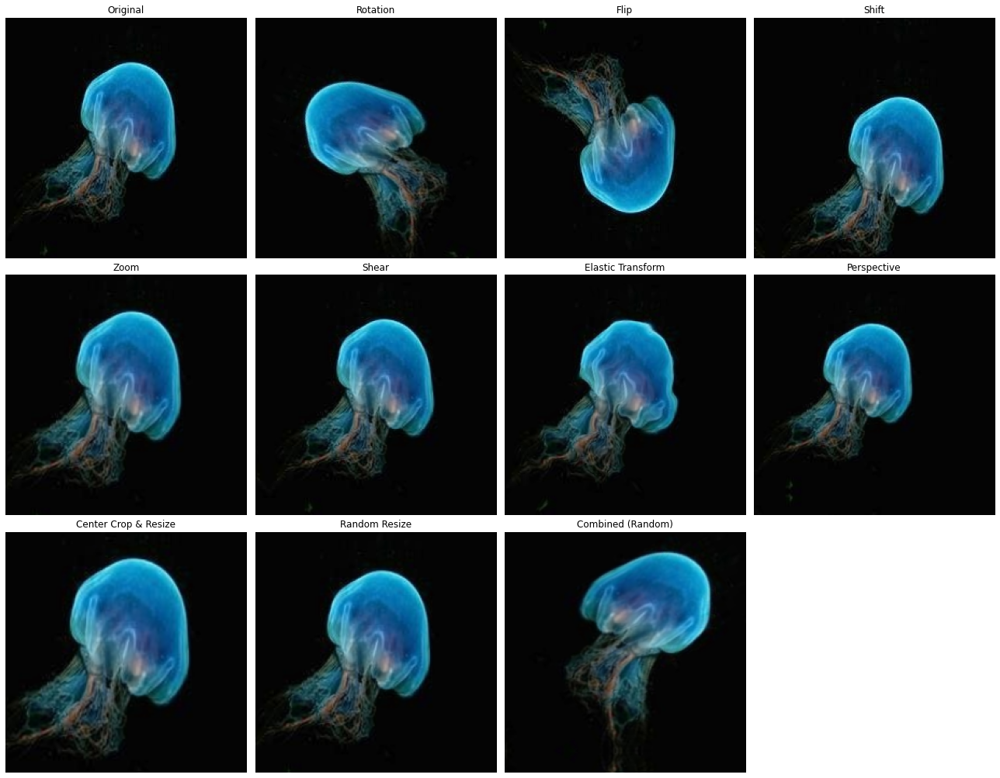

Showing augmentations for: ./compass_jellyfish


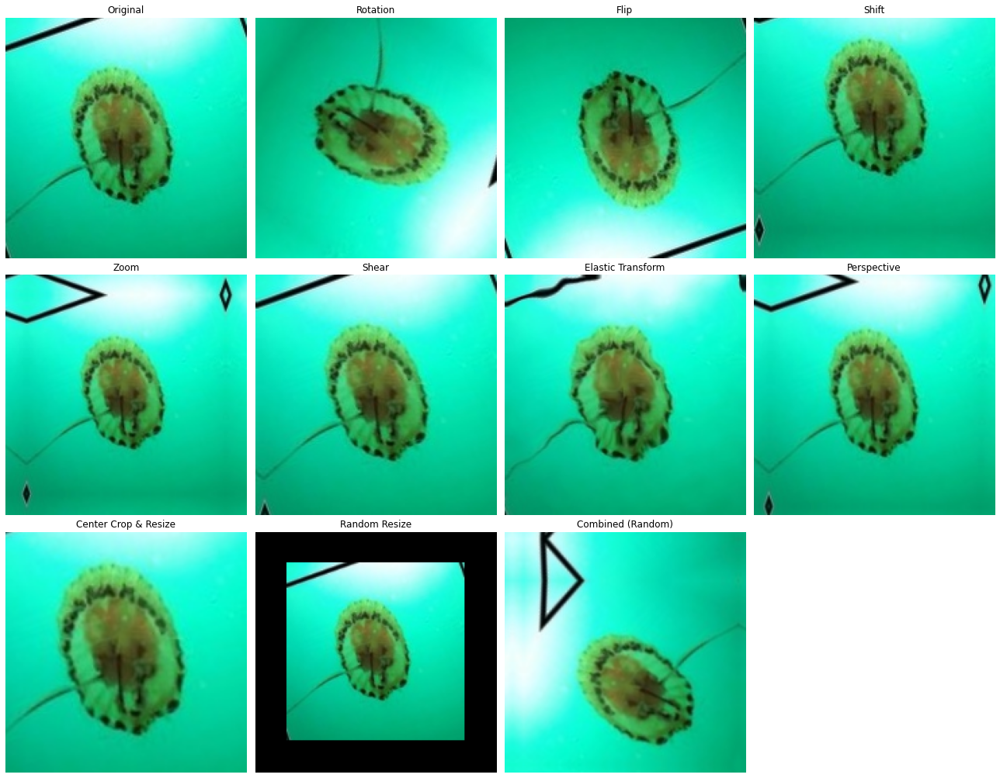

Showing augmentations for: ./lions_mane_jellyfish


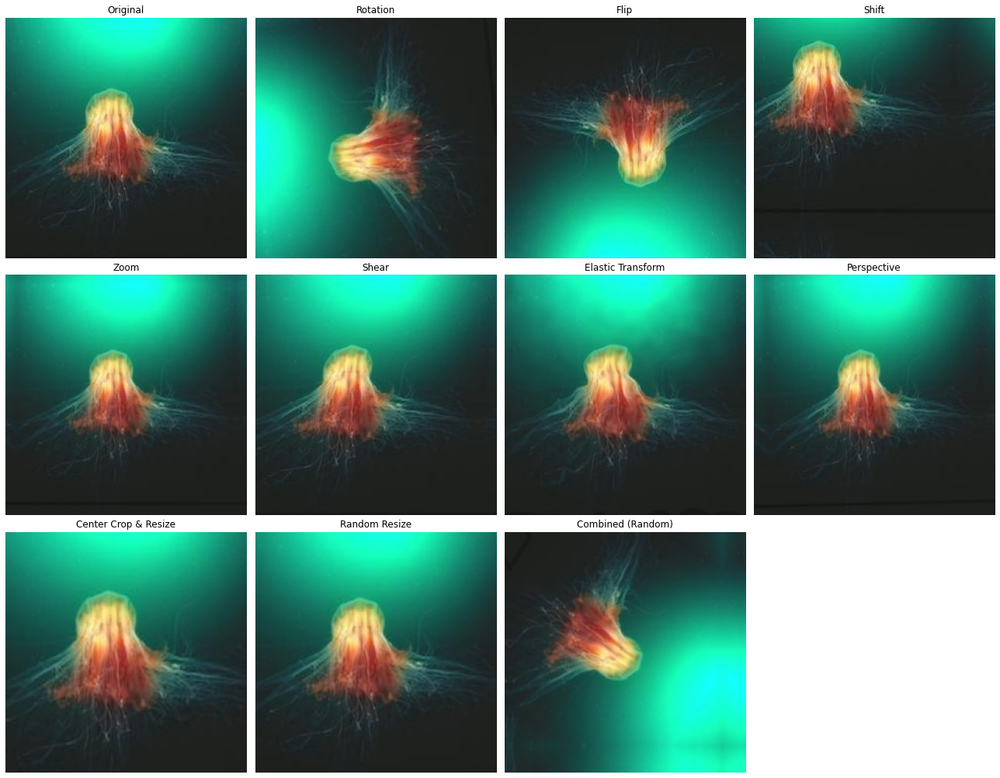

Showing augmentations for: ./Moon_jellyfish


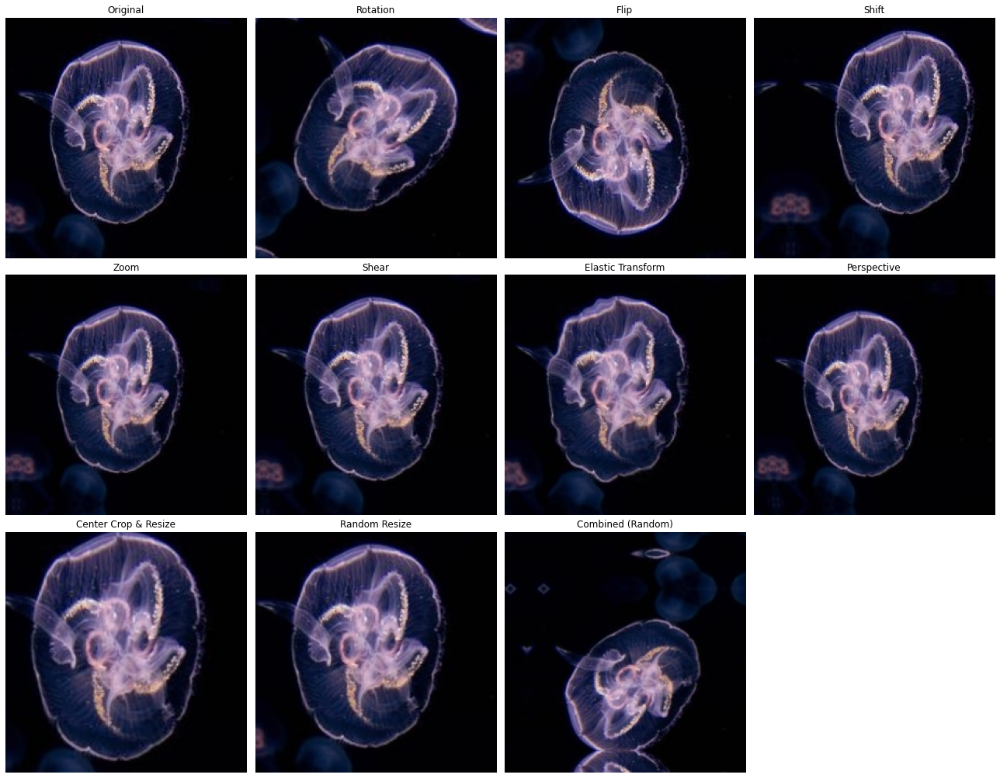

Showing augmentations for: ./barrel_jellyfish


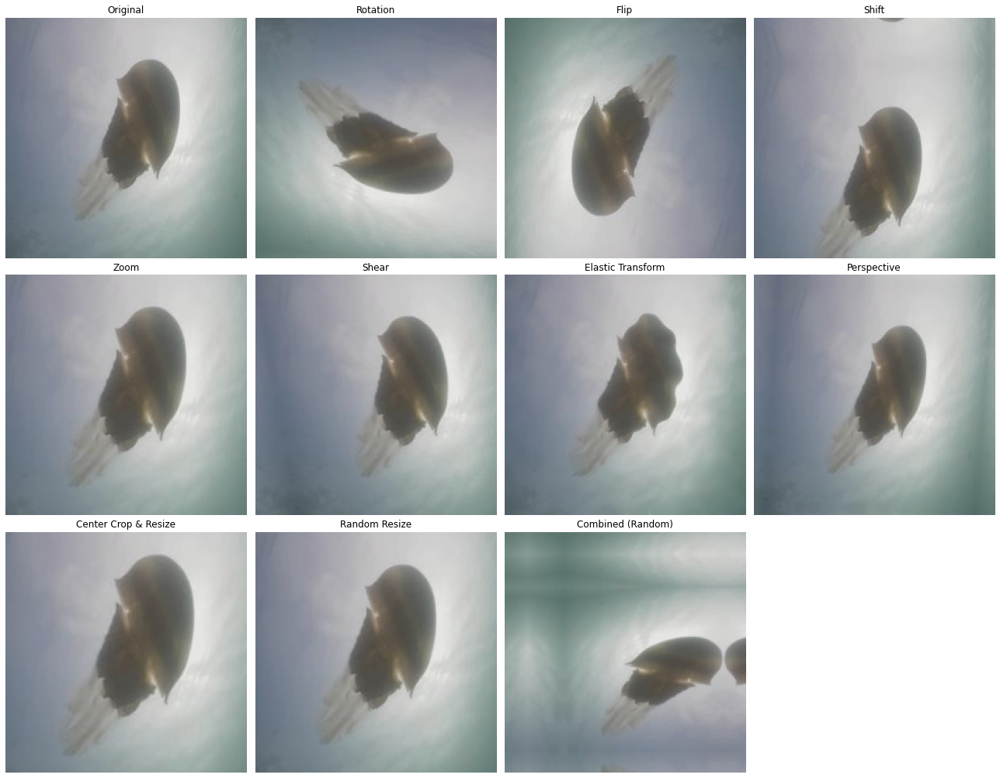

Showing augmentations for: ./mauve_stinger_jellyfish


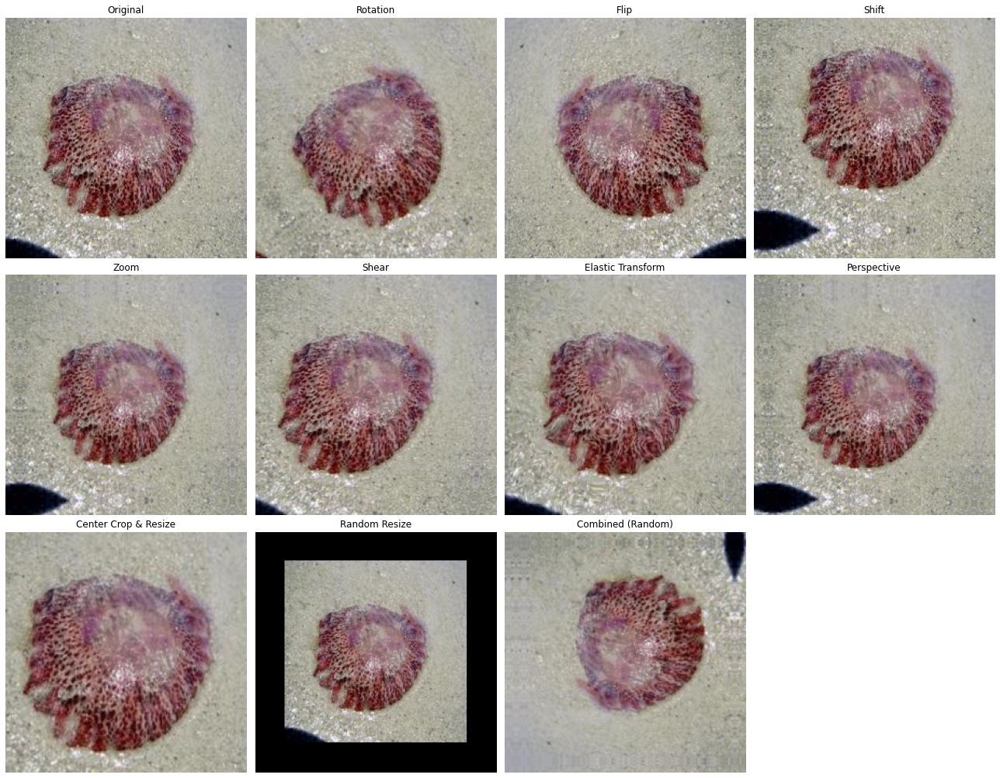

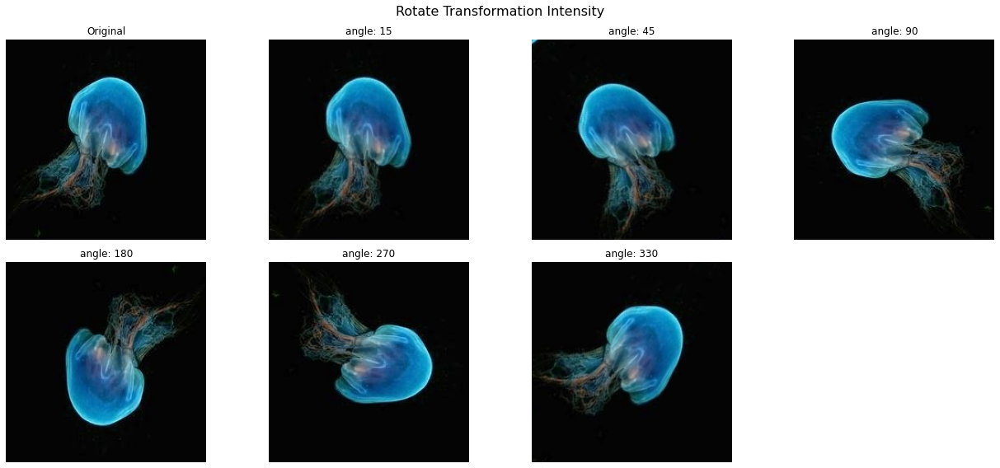

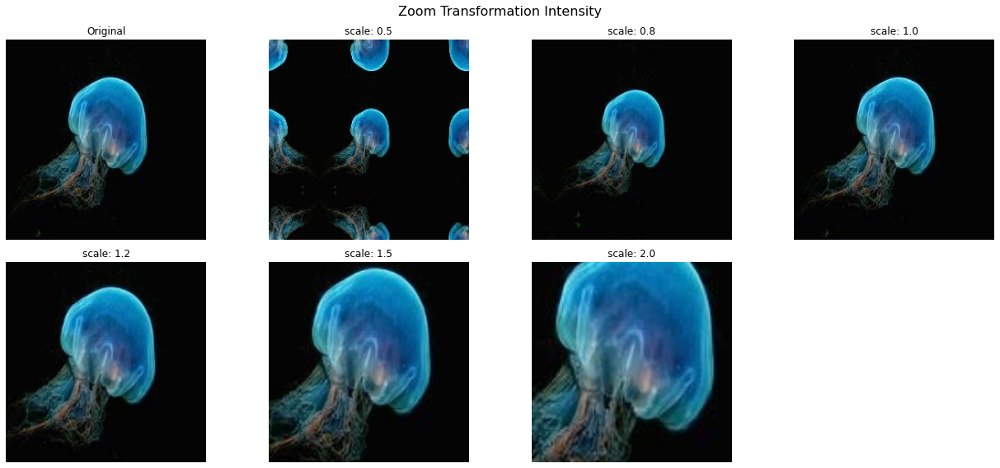

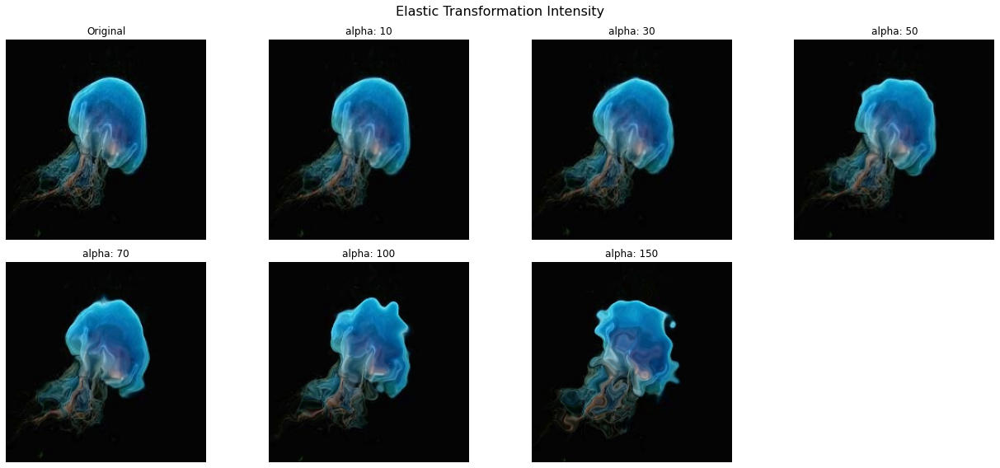

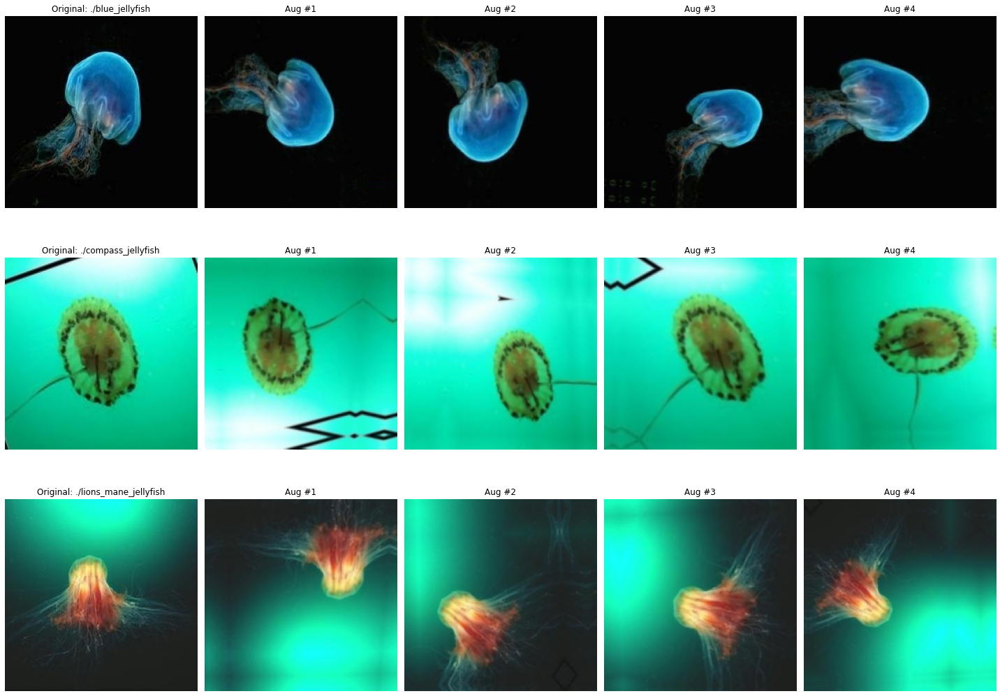

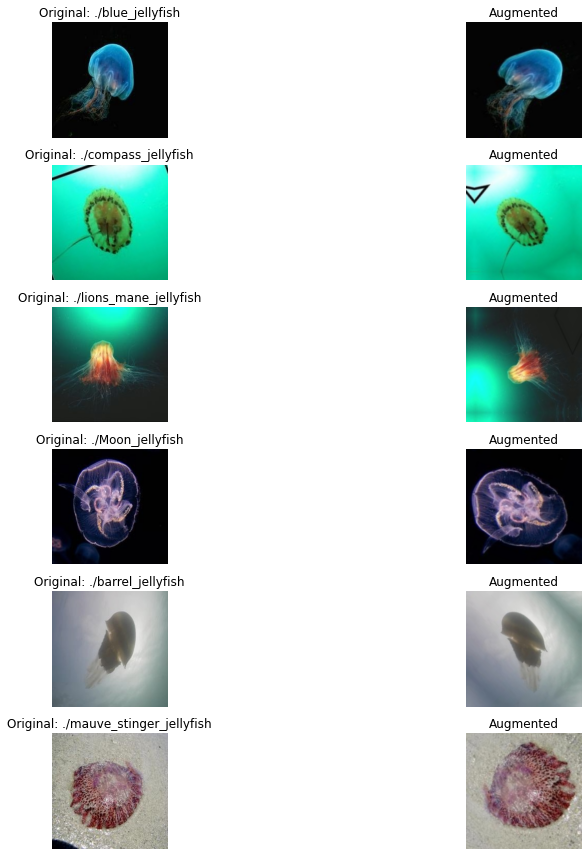

In [17]:
# JellyfishGeometricAugmentation 클래스 인스턴스 생성
augmenter = JellyfishGeometricAugmentation(p=1.0)  # p=1.0으로 설정하여 항상 증강 적용

# 샘플 이미지 로드 (경로는 실제 데이터 위치에 맞게 조정)
species = ["./blue_jellyfish", "./compass_jellyfish", "./lions_mane_jellyfish", 
           "./Moon_jellyfish", "./barrel_jellyfish", "./mauve_stinger_jellyfish"]

# 시각화할 이미지 목록 생성
sample_images = []
for jellyfish_type in species:
    img_path = jellyfish_type
    try:
        files = os.listdir(img_path)
        if files:
            # 각 종류별로 첫 번째 이미지 선택
            image_path = os.path.join(img_path, files[0])
            image = cv2.imread(image_path)
            if image is None:
                print(f"Failed to load image: {image_path}")
                continue
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # BGR에서 RGB로 변환
            sample_images.append((jellyfish_type, image))
    except Exception as e:
        print(f"Error loading images for {jellyfish_type}: {str(e)}")

if not sample_images:
    print("No images could be loaded. Please check the directory paths.")
else:
    # 1. 모든 증강 기법 시각화
    for species_name, img in sample_images:
        print(f"Showing augmentations for: {species_name}")
        augmenter.visualize_transformations(img, figsize=(18, 14))
        
    # 2. 특정 증강의 강도별 효과 시각화
    sample_img = sample_images[0][1]  # 첫 번째 해파리 이미지 사용

    # 회전 강도 시각화
    try:
        augmenter.visualize_intensity(
            sample_img, 
            transform_type='rotate', 
            param_name='angle', 
            values=[15, 45, 90, 180, 270, 330],
            figsize=(18, 8)
        )
    except Exception as e:
        print(f"Error visualizing rotation intensity: {str(e)}")

    # 확대/축소 강도 시각화
    try:
        augmenter.visualize_intensity(
            sample_img, 
            transform_type='zoom', 
            param_name='scale', 
            values=[0.5, 0.8, 1.0, 1.2, 1.5, 2.0],
            figsize=(18, 8)
        )
    except Exception as e:
        print(f"Error visualizing zoom intensity: {str(e)}")

    # 탄성 변환 강도 시각화
    try:
        augmenter.visualize_intensity(
            sample_img, 
            transform_type='elastic', 
            param_name='alpha', 
            values=[10, 30, 50, 70, 100, 150],
            figsize=(18, 8)
        )
    except Exception as e:
        print(f"Error visualizing elastic intensity: {str(e)}")

    # 3. 증강 결과 그리드 시각화 (여러 이미지에 대한 동일 증강 효과)
    def visualize_augmentation_grid(images, augmenter, n_samples=4, figsize=(20, 15)):
        """
        여러 이미지에 대한 증강 효과를 그리드로 시각화
        
        매개변수:
            images: (이름, 이미지) 튜플의 리스트
            augmenter: 증강기 객체
            n_samples: 각 이미지별 생성할 증강 샘플 수
            figsize: 그림 크기
        """
        n_images = len(images)
        
        plt.figure(figsize=figsize)
        
        for i, (name, img) in enumerate(images):
            # 원본 이미지
            plt.subplot(n_images, n_samples + 1, i * (n_samples + 1) + 1)
            plt.imshow(img)
            plt.title(f"Original: {name}")
            plt.axis('off')
            
            # 증강된 샘플들
            for j in range(n_samples):
                plt.subplot(n_images, n_samples + 1, i * (n_samples + 1) + j + 2)
                
                try:
                    # 안전한 변환만 사용 (elastic 제외)
                    augmented = augmenter.apply(img.copy(), 
                                            transformations=['rotate', 'flip', 'shift', 'zoom', 'perspective'])
                    
                    plt.imshow(augmented)
                    plt.title(f"Aug #{j+1}")
                except Exception as e:
                    plt.text(0.5, 0.5, f"Error: {str(e)}", ha='center', va='center')
                    plt.title(f"Aug #{j+1} (Error)")
                
                plt.axis('off')
        
        plt.tight_layout()
        plt.show()

    # 처음 3개 해파리 종류만 선택하여 증강 그리드 시각화
    try:
        visualize_augmentation_grid(sample_images[:3], augmenter, n_samples=4)
    except Exception as e:
        print(f"Error visualizing augmentation grid: {str(e)}")

    # 4. 증강 전/후 비교 시각화
    def visualize_before_after(images, augmenter, figsize=(16, 12)):
        """
        원본 이미지와 증강된 이미지를 나란히 비교 시각화
        
        매개변수:
            images: (이름, 이미지) 튜플의 리스트
            augmenter: 증강기 객체
            figsize: 그림 크기
        """
        n_images = len(images)
        
        plt.figure(figsize=figsize)
        
        for i, (name, img) in enumerate(images):
            # 원본 이미지
            plt.subplot(n_images, 2, 2*i + 1)
            plt.imshow(img)
            plt.title(f"Original: {name}")
            plt.axis('off')
            
            # 증강된 이미지
            plt.subplot(n_images, 2, 2*i + 2)
            
            try:
                # 안전한 변환 적용
                augmented = augmenter.apply(img.copy(), 
                                        transformations=['rotate', 'flip', 'zoom'])
                plt.imshow(augmented)
                plt.title("Augmented")
            except Exception as e:
                plt.text(0.5, 0.5, f"Error: {str(e)}", ha='center', va='center')
                plt.title("Augmented (Error)")
            
            plt.axis('off')
        
        plt.tight_layout()
        plt.show()

    # 모든 해파리 종류에 대해 전/후 비교 시각화
    try:
        visualize_before_after(sample_images, augmenter)
    except Exception as e:
        print(f"Error visualizing before/after comparison: {str(e)}")

## 노이즈 추가

Visualizing effect of different bubble densities


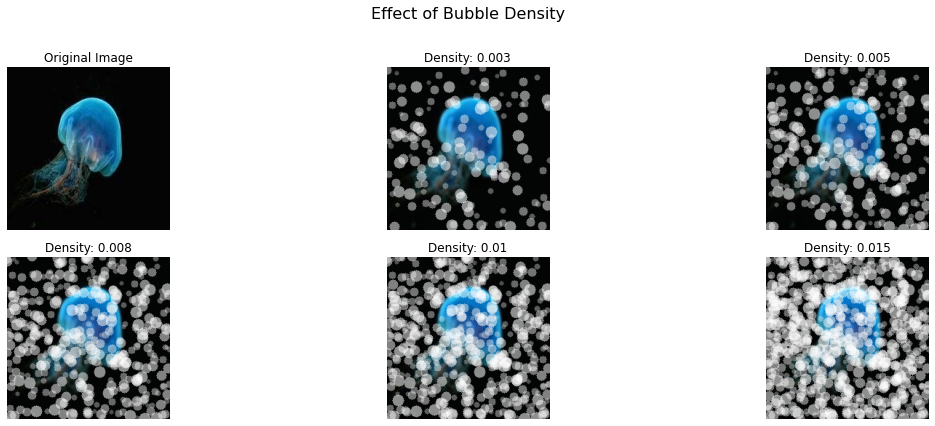

Applying improved underwater effect to all jellyfish species


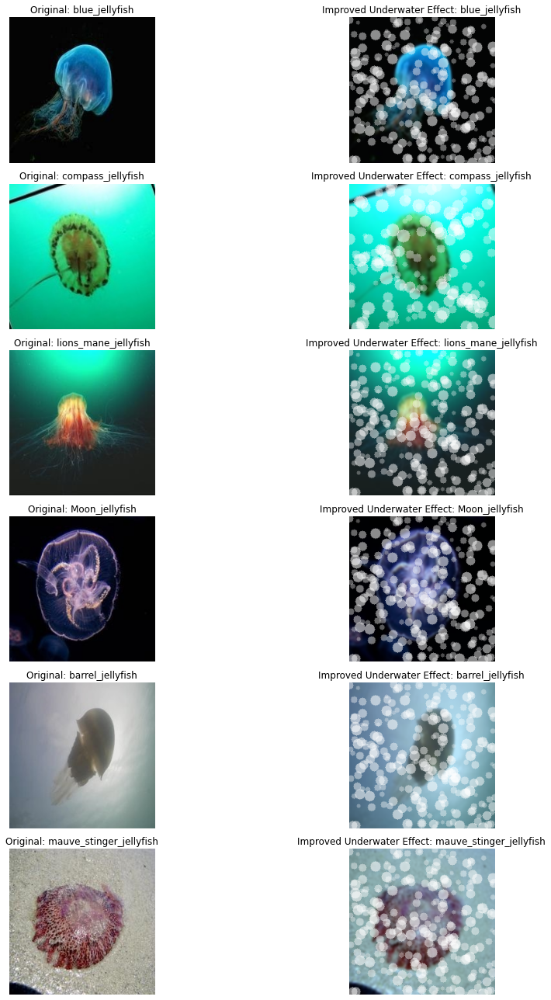

Visualizing different bubble size distributions


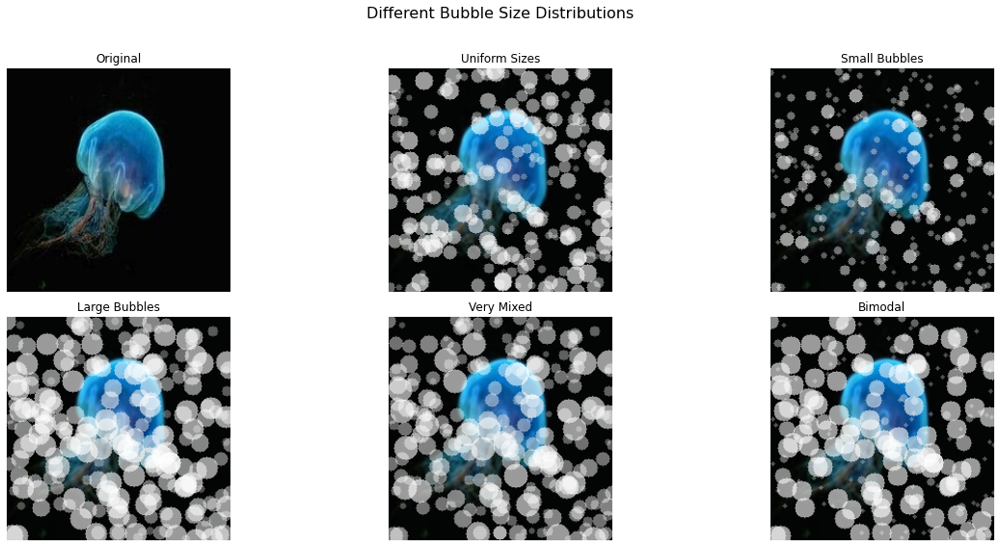

In [18]:
# 한글 폰트 경고 방지를 위해 영문만 사용
mpl.rcParams['font.family'] = 'DejaVu Sans'

def underwater_effect(image, blue_tint=0.2, blur_level=1.0, bubble_density=0.005, min_radius=3, max_radius=8):
    """Apply underwater effect simulation to an image with improved bubbles
    Args:
        image: Original image (float32 in 0-1 range)
        blue_tint: Blue tint intensity (0-1)
        blur_level: Blur intensity (0-3)
        bubble_density: Bubble effect density (0-0.05)
        min_radius: Minimum bubble radius
        max_radius: Maximum bubble radius
    
    Returns:
        underwater_img: Image with underwater effect applied
    """
    # Copy image
    img = image.copy()
    
    # 1. Add blue tint (red disappears first underwater)
    if len(img.shape) == 3:
        # Reduce R channel
        img[:,:,0] = img[:,:,0] * (1 - blue_tint)
        # Increase B channel
        img[:,:,2] = np.clip(img[:,:,2] * (1 + blue_tint/2), 0, 1)
    
    # 2. Apply Gaussian blur (simulate underwater turbidity)
    if blur_level > 0:
        kernel_size = int(blur_level * 3) * 2 + 1  # Always make it odd
        img = cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)
    
    # 3. Add bubble effect with transparency and varied sizes
    if bubble_density > 0:
        h, w = img.shape[0], img.shape[1]
        n_bubbles = int(h * w * bubble_density)  # Reduced density
        
        for _ in range(n_bubbles):
            # Random position
            x = np.random.randint(0, w)
            y = np.random.randint(0, h)
            
            # Random size, skewed toward larger bubbles
            # Using a weighted distribution for radius - more medium/large, fewer tiny bubbles
            size_distribution = np.array([0.1, 0.15, 0.2, 0.2, 0.2, 0.15])  # Weights for sizes
            size_indices = np.arange(min_radius, min_radius + len(size_distribution))
            radius = np.random.choice(size_indices, p=size_distribution)
            
            # Random opacity, higher for larger bubbles
            base_opacity = 0.3
            size_factor = (radius - min_radius) / (max_radius - min_radius)
            opacity = base_opacity + size_factor * 0.3  # 0.3 to 0.6 opacity range
            
            # Draw bubble with transparency
            if len(img.shape) == 3:
                # Create a bubble overlay
                overlay = img.copy()
                # Draw the bubble on the overlay
                cv2.circle(overlay, (x, y), radius, (1, 1, 1), -1)
                # Blend the overlay with original image using opacity
                img = cv2.addWeighted(overlay, opacity, img, 1 - opacity, 0)
    
    return img

# Apply the improved underwater effect to all jellyfish images
def visualize_improved_effect(base_dir, species):
    """
    Apply the improved underwater effect to all jellyfish species images
    
    Args:
        base_dir: Base dataset directory
        species: List of jellyfish species
    """
    # Load sample images
    sample_images = []
    for jellyfish_type in species:
        img_path = os.path.join(base_dir, jellyfish_type)
        try:
            files = os.listdir(img_path)
            if files:
                # Choose first image from each species
                image_path = os.path.join(img_path, files[0])
                image = cv2.imread(image_path)
                if image is None:
                    print(f"Failed to load image: {image_path}")
                    continue
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
                image = image.astype(np.float32) / 255.0  # Normalize to 0-1 range
                sample_images.append((jellyfish_type, image))
        except Exception as e:
            print(f"Error loading images for {jellyfish_type}: {str(e)}")
    
    if not sample_images:
        print("No images could be loaded. Please check the directory paths.")
        return
    
    # Apply improved underwater effect
    plt.figure(figsize=(16, 3 * len(sample_images)))
    
    for i, (name, img) in enumerate(sample_images):
        # Original image
        plt.subplot(len(sample_images), 2, 2*i + 1)
        plt.imshow(img)
        plt.title(f"Original: {name}")
        plt.axis('off')
        
        # Apply improved underwater effect
        plt.subplot(len(sample_images), 2, 2*i + 2)
        np.random.seed(42)  # For consistent bubble placement
        underwater_img = underwater_effect(
            img, 
            blue_tint=0.2,
            blur_level=1.0,
            bubble_density=0.005,  # Reduced density
            min_radius=3,          # Minimum radius
            max_radius=9           # Maximum radius
        )
        plt.imshow(underwater_img)
        plt.title(f"Improved Underwater Effect: {name}")
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()
    np.random.seed(None)  # Reset random seed

# Visualize different bubble density settings
def visualize_bubble_density(image_path):
    """
    Visualize the impact of different bubble density settings
    
    Args:
        image_path: Path to the image
    """
    # Load image
    img = cv2.imread(image_path)
    if img is None:
        print(f"Failed to load image: {image_path}")
        return
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    img = img.astype(np.float32) / 255.0        # Normalize to 0-1 range
    
    # Define density settings to test
    densities = [0.001, 0.003, 0.005, 0.008, 0.01, 0.015]
    
    plt.figure(figsize=(18, 6))
    plt.suptitle("Effect of Bubble Density", fontsize=16)
    
    # Original image
    plt.subplot(2, 3, 1)
    plt.imshow(img)
    plt.title("Original Image")
    plt.axis('off')
    
    # Apply different densities
    for i, density in enumerate(densities[1:]):
        plt.subplot(2, 3, i+2)
        np.random.seed(42)  # Consistent bubble placement
        result = underwater_effect(
            img, 
            blue_tint=0.2, 
            blur_level=1.0, 
            bubble_density=density,
            min_radius=3,
            max_radius=9
        )
        plt.imshow(result)
        plt.title(f"Density: {density}")
        plt.axis('off')
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()
    np.random.seed(None)  # Reset random seed

# Main code
if __name__ == "__main__":
    # Set base path
    base_dir = "/aiffel/aiffel/jellyfish"
    species = ["blue_jellyfish", "compass_jellyfish", "lions_mane_jellyfish", 
               "Moon_jellyfish", "barrel_jellyfish", "mauve_stinger_jellyfish"]
    
    # Get first jellyfish image path
    try:
        first_species = species[0]
        img_path = os.path.join(base_dir, first_species)
        files = os.listdir(img_path)
        if files:
            first_image_path = os.path.join(img_path, files[0])
            
            # 1. Visualize different bubble densities
            print(f"Visualizing effect of different bubble densities")
            visualize_bubble_density(first_image_path)
            
            # 2. Apply improved effect to all species
            print(f"Applying improved underwater effect to all jellyfish species")
            visualize_improved_effect(base_dir, species)
            
            # 3. Generate a few examples with different bubble size distributions
            def visualize_bubble_size_distributions(image_path):
                """Visualize different bubble size distributions"""
                # Load image
                img = cv2.imread(image_path)
                if img is None:
                    print(f"Failed to load image: {image_path}")
                    return
                
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                img = img.astype(np.float32) / 255.0
                
                plt.figure(figsize=(18, 8))
                plt.suptitle("Different Bubble Size Distributions", fontsize=16)
                
                # Original
                plt.subplot(2, 3, 1)
                plt.imshow(img)
                plt.title("Original")
                plt.axis('off')
                
                # Apply underwater effect with different bubble size distributions
                distributions = [
                    {"name": "Uniform Sizes", "weights": None, "min_r": 3, "max_r": 9},
                    {"name": "Small Bubbles", "weights": [0.3, 0.3, 0.2, 0.1, 0.1], "min_r": 2, "max_r": 7},
                    {"name": "Large Bubbles", "weights": [0.1, 0.1, 0.2, 0.3, 0.3], "min_r": 4, "max_r": 11},
                    {"name": "Very Mixed", "weights": [0.1, 0.2, 0.4, 0.2, 0.1], "min_r": 3, "max_r": 12},
                    {"name": "Bimodal", "weights": [0.4, 0.1, 0.0, 0.1, 0.4], "min_r": 2, "max_r": 10}
                ]
                
                for i, dist in enumerate(distributions):
                    plt.subplot(2, 3, i+2)
                    np.random.seed(42)
                    
                    # Apply blue tint and blur
                    result = img.copy()
                    result[:,:,0] = result[:,:,0] * 0.8  # Reduce red
                    result[:,:,2] = np.clip(result[:,:,2] * 1.1, 0, 1)  # Boost blue
                    result = cv2.GaussianBlur(result, (5, 5), 0)
                    
                    # Add bubbles with specified size distribution
                    h, w = result.shape[0], result.shape[1]
                    n_bubbles = int(h * w * 0.005)  # 0.5% density
                    
                    if dist["weights"] is None:
                        # Uniform distribution
                        for _ in range(n_bubbles):
                            x = np.random.randint(0, w)
                            y = np.random.randint(0, h)
                            radius = np.random.randint(dist["min_r"], dist["max_r"]+1)
                            opacity = 0.3 + (radius - dist["min_r"]) / (dist["max_r"] - dist["min_r"]) * 0.3
                            
                            overlay = result.copy()
                            cv2.circle(overlay, (x, y), radius, (1, 1, 1), -1)
                            result = cv2.addWeighted(overlay, opacity, result, 1 - opacity, 0)
                    else:
                        # Weighted distribution
                        size_range = np.linspace(dist["min_r"], dist["max_r"], len(dist["weights"]), dtype=int)
                        
                        for _ in range(n_bubbles):
                            x = np.random.randint(0, w)
                            y = np.random.randint(0, h)
                            radius = np.random.choice(size_range, p=dist["weights"])
                            opacity = 0.3 + (radius - dist["min_r"]) / (dist["max_r"] - dist["min_r"]) * 0.3
                            
                            overlay = result.copy()
                            cv2.circle(overlay, (x, y), radius, (1, 1, 1), -1)
                            result = cv2.addWeighted(overlay, opacity, result, 1 - opacity, 0)
                    
                    plt.imshow(result)
                    plt.title(dist["name"])
                    plt.axis('off')
                
                plt.tight_layout(rect=[0, 0, 1, 0.96])
                plt.show()
            
            # Call the new visualization function
            print(f"Visualizing different bubble size distributions")
            visualize_bubble_size_distributions(first_image_path)
            
        else:
            print(f"No images found in {img_path}")
    except Exception as e:
        print(f"Error during visualization: {str(e)}")

In [19]:
def make_noise_augmented_dataset(images, labels):
    augmented = []
    for img in images:
        img_norm = img.astype(np.float32) / 255.0  # 0~1 정규화
        aug_img = underwater_effect(
            img_norm,
            blue_tint=0.2,
            blur_level=1.0,
            bubble_density=0.005,
            min_radius=3,
            max_radius=8
        )
        aug_img = np.clip(aug_img * 255.0, 0, 255).astype(np.uint8)  # 다시 0~255로 복원
        augmented.append(aug_img)
    return tf.data.Dataset.from_tensor_slices((np.array(augmented), labels))

# 원본 + 특성 강화 + 기하학적 증강 + 노이즈 증강 

In [20]:
import tensorflow as tf
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
    except RuntimeError as e:
        print(e)

Physical devices cannot be modified after being initialized


In [77]:
from tensorflow.keras.utils import to_categorical
class_names = sorted([d for d in os.listdir(train_dir) if os.path.isdir(os.path.join(train_dir, d))])

# 이미지 로드 (원본 + 라벨 + 종 이름)
def load_raw_images_and_labels(image_size, class_names):
    images, labels, species_list = [], [], []
    for idx, class_name in enumerate(class_names):
        class_path = os.path.join(train_dir, class_name)
        for fname in os.listdir(class_path):
            if fname.lower().endswith(('.jpg', '.jpeg', '.png')):
                img_path = os.path.join(class_path, fname)
                img = cv2.imread(img_path)
                if img is not None:
                    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                    img = cv2.resize(img, image_size)
                    images.append(img)
                    labels.append(idx)
                    species_list.append(class_name.lower())
    return np.array(images), to_categorical(labels, num_classes=len(class_names)), species_list

# Dataset 변환 함수들
def make_dataset(images, labels):
    return tf.data.Dataset.from_tensor_slices((images, labels))

def make_augmented_dataset(images, labels, augmenter, species_list=None, mode='feature'):
    augmented = []
    for i in range(len(images)):
        if mode == 'feature':
            aug_img = augmenter.apply(images[i], species=species_list[i])
        elif mode == 'geometric':
            aug_img = augmenter.apply(images[i], transformations=['rotate', 'flip', 'shift', 'zoom'])
        augmented.append(aug_img)
    return tf.data.Dataset.from_tensor_slices((np.array(augmented), labels))

# 원본 이미지 및 라벨 로드
raw_images, raw_labels, species_list = load_raw_images_and_labels(img_size, class_names)

# 증강기 세팅 (확률 100%)
features_aug = JellyfishFeaturesAugmentation(); features_aug.p = 1.0
geom_aug = JellyfishGeometricAugmentation(); geom_aug.p = 1.0

# 네 가지 버전으로 구성
ds_original = make_dataset(raw_images, raw_labels)
ds_feature = make_augmented_dataset(raw_images, raw_labels, features_aug, species_list, mode='feature')
ds_geom = make_augmented_dataset(raw_images, raw_labels, geom_aug, mode='geometric')
ds_noise = make_noise_augmented_dataset(raw_images, raw_labels)

# 최종 train_ds (셔플 + 배치 + prefetch 포함)
train_ds = ds_original.concatenate(ds_feature).concatenate(ds_geom).concatenate(ds_noise)
train_ds = train_ds.shuffle(buffer_size=len(train_ds)).batch(batch_size).prefetch(tf.data.AUTOTUNE)

In [78]:
# 원본 데이터셋 크기 확인
original_count = len(list(ds_original))
print(f"원본 데이터셋 크기: {original_count}")

# 각 증강 데이터셋 크기 확인
feature_count = len(list(ds_feature))
geom_count = len(list(ds_geom))
noise_count = len(list(ds_noise))

print(f"특성 증강 데이터셋 크기: {feature_count}")
print(f"기하학적 증강 데이터셋 크기: {geom_count}")
print(f"노이즈 증강 데이터셋 크기: {noise_count}")

# 최종 합쳐진 데이터셋 크기 확인 (배치 전)
total_before_batch = len(list(ds_original.concatenate(ds_feature).concatenate(ds_geom).concatenate(ds_noise)))
print(f"총 증강 데이터셋 크기 (배치 전): {total_before_batch}")

# 또는 최종 train_ds의 배치 수 확인 (이미 배치가 적용된 경우)
batch_count = len(list(train_ds))
print(f"총 배치 수: {batch_count}")
print(f"예상 총 샘플 수 (배치 크기 x 배치 수): {batch_count * batch_size}")

원본 데이터셋 크기: 900
특성 증강 데이터셋 크기: 900
기하학적 증강 데이터셋 크기: 900
노이즈 증강 데이터셋 크기: 900
총 증강 데이터셋 크기 (배치 전): 3600
총 배치 수: 113
예상 총 샘플 수 (배치 크기 x 배치 수): 3616


## K-폴드 교차 검증 설정

In [79]:
from sklearn.model_selection import KFold
import numpy as np
import matplotlib.pyplot as plt
import os
import json
import pickle

In [80]:
# K-폴드 설정
n_splits = 5
kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)

# 모델 저장 경로
if not os.path.exists('models'):
    os.makedirs('models')
    
# 결과 저장
results = {}

# 이미 증강된 데이터를 가지고 있으므로, 이 데이터를 K-폴드로 분할
# 원본 데이터셋을 사용하면 데이터 누수 방지
fold_indices = list(kf.split(raw_images))

print(f"데이터셋 크기: {len(raw_images)}")
print(f"K-폴드 교차 검증: {n_splits}개 폴드")
for i, (train_idx, val_idx) in enumerate(fold_indices):
    print(f"폴드 {i+1}: 훈련 {len(train_idx)}개, 검증 {len(val_idx)}개")

데이터셋 크기: 900
K-폴드 교차 검증: 5개 폴드
폴드 1: 훈련 720개, 검증 180개
폴드 2: 훈련 720개, 검증 180개
폴드 3: 훈련 720개, 검증 180개
폴드 4: 훈련 720개, 검증 180개
폴드 5: 훈련 720개, 검증 180개


### K-폴드 데이터셋 생성 함수

In [81]:
def create_fold_datasets(raw_images, raw_labels, species_list, fold_idx, batch_size=32):
    """특정 폴드에 대한 훈련 및 검증 데이터셋 생성"""
    train_idx, val_idx = fold_indices[fold_idx]
    
    # 훈련/검증 데이터 분리
    train_images, train_labels = raw_images[train_idx], raw_labels[train_idx]
    train_species = [species_list[i] for i in train_idx]
    val_images, val_labels = raw_images[val_idx], raw_labels[val_idx]
    
    # 증강된 훈련 데이터셋 생성
    # 1. 원본 데이터
    ds_original = make_dataset(train_images, train_labels)
    
    # 2. 특징 증강
    features_aug = JellyfishFeaturesAugmentation(); features_aug.p = 1.0
    ds_feature = make_augmented_dataset(train_images, train_labels, features_aug, train_species, mode='feature')
    
    # 3. 기하학적 증강
    geom_aug = JellyfishGeometricAugmentation(); geom_aug.p = 1.0
    ds_geom = make_augmented_dataset(train_images, train_labels, geom_aug, mode='geometric')
    
    # 4. 노이즈 증강
    ds_noise = make_noise_augmented_dataset(train_images, train_labels)
    
    # 훈련 데이터셋 조합
    train_ds = ds_original.concatenate(ds_feature).concatenate(ds_geom).concatenate(ds_noise)
    train_ds = train_ds.shuffle(buffer_size=len(train_idx)*4).batch(batch_size).prefetch(tf.data.AUTOTUNE)
    
    # 검증 데이터셋
    val_ds = make_dataset(val_images, val_labels)
    val_ds = val_ds.batch(batch_size).prefetch(tf.data.AUTOTUNE)
    
    return train_ds, val_ds, train_idx, val_idx

In [82]:
# 포드 인덱스 크기 확인
train_idx, val_idx = fold_indices[0]
print(f"훈련 인덱스 수 (원본 데이터): {len(train_idx)}")
print(f"검증 인덱스 수 (원본 데이터): {len(val_idx)}")

# 증강 전 원본 데이터셋 크기
train_ds_orig = tf.data.Dataset.from_tensor_slices((raw_images[train_idx], raw_labels[train_idx]))
print(f"원본 훈련 데이터 샘플 수: {len(list(train_ds_orig))}")

# 증강 후 총 샘플 수 (unbatch 사용)
try:
    print(f"증강 후 총 훈련 샘플 수: {len(list(train_ds.unbatch()))}")
    print(f"검증 샘플 수: {len(list(val_ds.unbatch()))}")
except:
    # 메모리 문제 발생 시 대체 방법
    total_batches = len(list(train_ds))
    last_batch_size = len(list(train_ds.take(-1).unbatch()))
    estimated_samples = (total_batches - 1) * batch_size + last_batch_size
    print(f"증강 후 예상 훈련 샘플 수: ~{estimated_samples}")

훈련 인덱스 수 (원본 데이터): 720
검증 인덱스 수 (원본 데이터): 180
원본 훈련 데이터 샘플 수: 720
증강 후 총 훈련 샘플 수: 3600
검증 샘플 수: 180


## MobileNet 모델

In [27]:
from tensorflow.keras.applications import MobileNetV3Small
from tensorflow.keras.layers import Dense, Dropout, GlobalAveragePooling2D, Input
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

def create_mobilenet_model(input_shape=(224, 224, 3), num_classes=len(class_names), 
                          dropout_rate1=0.5, dropout_rate2=0.3, 
                          dense_units=128, l2_reg=0.01):
    """MobileNet 모델 생성"""
    base_model = MobileNetV3Small(
        input_shape=input_shape,
        include_top=False,
        weights='imagenet'
    )
    
    # 모델 고정 (전이학습)
    base_model.trainable = False
    
    inputs = Input(shape=input_shape)
    x = base_model(inputs)
    x = GlobalAveragePooling2D()(x)
    x = Dropout(dropout_rate1)(x)
    x = Dense(dense_units, activation='relu', kernel_regularizer=l2(l2_reg))(x)
    x = Dropout(dropout_rate2)(x)
    outputs = Dense(num_classes, activation='softmax')(x)
    
    model = Model(inputs=inputs, outputs=outputs)
    
    return model, base_model

In [28]:
# 모델 생성 테스트 
test_model, _ = create_mobilenet_model()
test_model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
MobilenetV3small (Functional (None, 1, 1, 1024)        1529968   
_________________________________________________________________
global_average_pooling2d_1 ( (None, 1024)              0         
_________________________________________________________________
dropout (Dropout)            (None, 1024)              0         
_________________________________________________________________
dense (Dense)                (None, 128)               131200    
_________________________________________________________________
dropout_1 (Dropout)          (None, 128)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 6)                 774   

### MobileNet 하이퍼파라미터 최적화 

In [29]:
def optimize_mobilenet_hyperparameters(train_ds, val_ds, test_params=None):
    """간단한 하이퍼파라미터 최적화"""
    print("MobileNet 하이퍼파라미터 최적화 중...")
    
    # 저장된 최적 파라미터가 있는지 확인
    params_file = 'mobilenet_params.json'
    if os.path.exists(params_file):
        print(f"기존 최적 파라미터 로드: {params_file}")
        with open(params_file, 'r') as f:
            return json.load(f)
    
    # 테스트할 파라미터 (빠른 테스트를 위해)
    if test_params is None:
        test_params = {
            'learning_rate': [0.001, 0.0005],
            'dropout_rate1': [0.5],
            'dropout_rate2': [0.3],
            'dense_units': [128],
            'l2_reg': [0.01]
        }
    
    best_params = {
        'learning_rate': 0.001,
        'dropout_rate1': 0.5,
        'dropout_rate2': 0.3,
        'dense_units': 128,
        'l2_reg': 0.01
    }
    
    best_val_acc = 0
    
    # 학습률만 테스트 (간소화)
    for lr in test_params['learning_rate']:
        print(f"   학습률 {lr} 테스트 중...")
        
        # 모델 생성
        model, _ = create_mobilenet_model(
            dropout_rate1=best_params['dropout_rate1'],
            dropout_rate2=best_params['dropout_rate2'],
            dense_units=best_params['dense_units'],
            l2_reg=best_params['l2_reg']
        )
        
        # 모델 컴파일
        model.compile(
            optimizer=tf.keras.optimizers.Adam(learning_rate=lr),
            loss='categorical_crossentropy',
            metrics=['accuracy']
        )
        
        # 짧은 에포크로 테스트
        history = model.fit(
            train_ds,
            validation_data=val_ds,
            epochs=3,  # 짧게 테스트
            verbose=1
        )
        
        # 최고 검증 정확도 확인
        val_acc = max(history.history['val_accuracy'])
        print(f"   검증 정확도: {val_acc:.4f}")
        
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_params['learning_rate'] = lr
            
    # 최적 파라미터 저장
    print(f"최적 파라미터: {best_params}")
    with open(params_file, 'w') as f:
        json.dump(best_params, f)
    
    return best_params

In [30]:
# 첫 번째 폴드로 테스트
train_ds, val_ds, _, _ = create_fold_datasets(raw_images, raw_labels, species_list, fold_idx=0)
mobilenet_params = optimize_mobilenet_hyperparameters(train_ds, val_ds)

MobileNet 하이퍼파라미터 최적화 중...
   학습률 0.001 테스트 중...
Epoch 1/3
90/90 [==============================] - 10s 31ms/step - loss: 2.9853 - accuracy: 0.5938 - val_loss: 1.7886 - val_accuracy: 0.9278
Epoch 2/3
90/90 [==============================] - 2s 18ms/step - loss: 1.8445 - accuracy: 0.7799 - val_loss: 1.1801 - val_accuracy: 0.9556
Epoch 3/3
90/90 [==============================] - 2s 18ms/step - loss: 1.3281 - accuracy: 0.8142 - val_loss: 0.8274 - val_accuracy: 0.9556
   검증 정확도: 0.9556
   학습률 0.0005 테스트 중...
Epoch 1/3
90/90 [==============================] - 5s 28ms/step - loss: 3.4252 - accuracy: 0.4767 - val_loss: 2.3129 - val_accuracy: 0.9167
Epoch 2/3
90/90 [==============================] - 2s 18ms/step - loss: 2.4126 - accuracy: 0.7302 - val_loss: 1.7334 - val_accuracy: 0.9278
Epoch 3/3
90/90 [==============================] - 2s 18ms/step - loss: 1.9284 - accuracy: 0.7795 - val_loss: 1.3512 - val_accuracy: 0.9611
   검증 정확도: 0.9611
최적 파라미터: {'learning_rate': 0.0005, 'dropout_rate1':

### MobileNet K-폴드 학습

In [31]:
def train_mobilenet_kfold():
    """MobileNet 모델 K-폴드 교차 검증 학습"""
    print("MobileNet K-폴드 교차 검증 학습 시작...")
    
    # 결과 저장
    mobilenet_results = {
        'fold_accuracies': [],
        'fold_models': [],
        'fold_histories': []
    }
    
    # 각 폴드 학습
    for fold_idx in range(n_splits):
        print(f"\n===== MobileNet 폴드 {fold_idx+1}/{n_splits} =====")
        
        # 폴드 데이터셋 생성
        train_ds, val_ds, _, _ = create_fold_datasets(raw_images, raw_labels, species_list, fold_idx)
        
        # 모델 저장 경로
        model_path = f'models/mobilenet_fold{fold_idx+1}.h5'
        history_path = f'models/mobilenet_history_fold{fold_idx+1}.pkl'
        
        # 이미 학습된 모델이 있는지 확인
        if os.path.exists(model_path) and os.path.exists(history_path):
            print(f"폴드 {fold_idx+1} 기존 모델 로드")
            model = tf.keras.models.load_model(model_path)
            with open(history_path, 'rb') as f:
                history = pickle.load(f)
        else:
            # 하이퍼파라미터 최적화 (선택적)
            # 모든 폴드에 동일한 파라미터 사용 또는 각 폴드마다 최적화
            try:
                with open('mobilenet_params.json', 'r') as f:
                    params = json.load(f)
            except:
                params = {
                    'learning_rate': 0.001,
                    'dropout_rate1': 0.5,
                    'dropout_rate2': 0.3,
                    'dense_units': 128,
                    'l2_reg': 0.01
                }
            
            # 모델 생성
            model, _ = create_mobilenet_model(**{k: params[k] for k in params if k != 'learning_rate'})
            
            # 컴파일
            model.compile(
                optimizer=tf.keras.optimizers.Adam(learning_rate=params['learning_rate']),
                loss='categorical_crossentropy',
                metrics=['accuracy']
            )
            
            # 콜백 설정
            callbacks = [
                tf.keras.callbacks.EarlyStopping(
                    patience=5, 
                    restore_best_weights=True
                ),
                tf.keras.callbacks.ReduceLROnPlateau(
                    factor=0.7, 
                    patience=3, 
                    min_lr=1e-6
                ),
                tf.keras.callbacks.ModelCheckpoint(
                    f'models/mobilenet_best_fold{fold_idx+1}.h5',
                    save_best_weights_only=True,
                    monitor='val_accuracy'
                )
            ]
            
            # 학습
            history = model.fit(
                train_ds,
                validation_data=val_ds,
                epochs=15,
                callbacks=callbacks,
                verbose=1
            )
            
            # 모델 저장
            model.save(model_path)
            with open(history_path, 'wb') as f:
                pickle.dump(history.history, f)
        
        # 검증 정확도
        val_accuracy = max(history.history['val_accuracy'])
        print(f"폴드 {fold_idx+1} 최고 검증 정확도: {val_accuracy:.4f}")
        
        # 결과 저장
        mobilenet_results['fold_accuracies'].append(val_accuracy)
        mobilenet_results['fold_models'].append(model)
        mobilenet_results['fold_histories'].append(history.history)
    
    # 평균 정확도 계산
    avg_accuracy = np.mean(mobilenet_results['fold_accuracies'])
    std_accuracy = np.std(mobilenet_results['fold_accuracies'])
    print(f"\nMobileNet 평균 검증 정확도: {avg_accuracy:.4f} ± {std_accuracy:.4f}")
    
    # 최고 성능 모델 찾기
    best_fold_idx = np.argmax(mobilenet_results['fold_accuracies'])
    best_fold_acc = mobilenet_results['fold_accuracies'][best_fold_idx]
    print(f"MobileNet 최고 성능 폴드: {best_fold_idx+1}, 정확도: {best_fold_acc:.4f}")
    
    # 전체 결과 저장
    mobilenet_results['avg_accuracy'] = avg_accuracy
    mobilenet_results['std_accuracy'] = std_accuracy
    mobilenet_results['best_fold_idx'] = best_fold_idx
    
    # 결과 반환
    return mobilenet_results

In [32]:
# K-폴드 학습 실행
mobilenet_results = train_mobilenet_kfold()

MobileNet K-폴드 교차 검증 학습 시작...

===== MobileNet 폴드 1/5 =====
Epoch 1/15
90/90 [==============================] - 5s 26ms/step - loss: 3.4068 - accuracy: 0.5000 - val_loss: 2.3091 - val_accuracy: 0.8944


/opt/conda/lib/python3.9/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


Epoch 2/15
90/90 [==============================] - 2s 17ms/step - loss: 2.4157 - accuracy: 0.7250 - val_loss: 1.7275 - val_accuracy: 0.9389
Epoch 3/15
90/90 [==============================] - 2s 17ms/step - loss: 1.9253 - accuracy: 0.7802 - val_loss: 1.3985 - val_accuracy: 0.9333
Epoch 4/15
90/90 [==============================] - 2s 18ms/step - loss: 1.5902 - accuracy: 0.8076 - val_loss: 1.1016 - val_accuracy: 0.9444
Epoch 5/15
90/90 [==============================] - 2s 17ms/step - loss: 1.3334 - accuracy: 0.8212 - val_loss: 0.8914 - val_accuracy: 0.9778
Epoch 6/15
90/90 [==============================] - 2s 17ms/step - loss: 1.1421 - accuracy: 0.8451 - val_loss: 0.7473 - val_accuracy: 0.9611
Epoch 7/15
90/90 [==============================] - 2s 17ms/step - loss: 1.0208 - accuracy: 0.8392 - val_loss: 0.6373 - val_accuracy: 0.9667
Epoch 8/15
90/90 [==============================] - 2s 17ms/step - loss: 0.9073 - accuracy: 0.8510 - val_loss: 0.5537 - val_accuracy: 0.9667
Epoch 9/15
90

## EfficientNet 모델 정의

In [83]:
from tensorflow.keras.applications import EfficientNetB0

def create_efficientnet_model(input_shape=(224, 224, 3), num_classes=len(class_names),
                             dropout_rate1=0.5, dropout_rate2=0.3, 
                             dense_units=128, l2_reg=0.01):
    """EfficientNet 모델 생성"""
    base_model = EfficientNetB0(
        input_shape=input_shape,
        include_top=False,
        weights='imagenet'
    )
    
    # 모델 고정 (전이학습)
    base_model.trainable = False
    
    inputs = Input(shape=input_shape)
    x = base_model(inputs)
    x = GlobalAveragePooling2D()(x)
    x = Dropout(dropout_rate1)(x)
    x = Dense(dense_units, activation='relu', kernel_regularizer=l2(l2_reg))(x)
    x = Dropout(dropout_rate2)(x)
    outputs = Dense(num_classes, activation='softmax')(x)
    
    model = Model(inputs=inputs, outputs=outputs)
    
    return model, base_model

In [84]:
# 모델 생성 테스트
test_model, _ = create_efficientnet_model()
test_model.summary()

Model: "model_39"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_61 (InputLayer)        [(None, 224, 224, 3)]     0         
_________________________________________________________________
efficientnetb0 (Functional)  (None, 7, 7, 1280)        4049571   
_________________________________________________________________
global_average_pooling2d_42  (None, 1280)              0         
_________________________________________________________________
dropout_40 (Dropout)         (None, 1280)              0         
_________________________________________________________________
dense_68 (Dense)             (None, 128)               163968    
_________________________________________________________________
dropout_41 (Dropout)         (None, 128)               0         
_________________________________________________________________
dense_69 (Dense)             (None, 6)                 774

### EfficientNet 하이퍼파라미터 최적화

In [85]:
def optimize_efficientnet_hyperparameters(train_ds, val_ds, test_params=None):
    """간단한 하이퍼파라미터 최적화"""
    print("EfficientNet 하이퍼파라미터 최적화 중...")
    
    # 저장된 최적 파라미터가 있는지 확인
    params_file = 'efficientnet_params.json'
    if os.path.exists(params_file):
        print(f"기존 최적 파라미터 로드: {params_file}")
        with open(params_file, 'r') as f:
            return json.load(f)
    
    # 테스트할 파라미터 (빠른 테스트를 위해)
    if test_params is None:
        test_params = {
            'learning_rate': [0.001, 0.0005],
            'dropout_rate1': [0.5],
            'dropout_rate2': [0.3],
            'dense_units': [128],
            'l2_reg': [0.01]
        }
    
    best_params = {
        'learning_rate': 0.001,
        'dropout_rate1': 0.5,
        'dropout_rate2': 0.3,
        'dense_units': 128,
        'l2_reg': 0.01
    }
    
    best_val_acc = 0
    
    # 학습률만 테스트 (간소화)
    for lr in test_params['learning_rate']:
        print(f"   학습률 {lr} 테스트 중...")
        
        # 모델 생성
        model, _ = create_efficientnet_model(
            dropout_rate1=best_params['dropout_rate1'],
            dropout_rate2=best_params['dropout_rate2'],
            dense_units=best_params['dense_units'],
            l2_reg=best_params['l2_reg']
        )
        
        # 모델 컴파일
        model.compile(
            optimizer=tf.keras.optimizers.Adam(learning_rate=lr),
            loss='categorical_crossentropy',
            metrics=['accuracy']
        )
        
        # 짧은 에포크로 테스트
        history = model.fit(
            train_ds,
            validation_data=val_ds,
            epochs=3,  # 짧게 테스트
            verbose=1
        )
        
        # 최고 검증 정확도 확인
        val_acc = max(history.history['val_accuracy'])
        print(f"   검증 정확도: {val_acc:.4f}")
        
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_params['learning_rate'] = lr
            
    # 최적 파라미터 저장
    print(f"최적 파라미터: {best_params}")
    with open(params_file, 'w') as f:
        json.dump(best_params, f)
    
    return best_params

In [86]:
train_ds, val_ds, _, _ = create_fold_datasets(raw_images, raw_labels, species_list, fold_idx=0)
efficientnet_params = optimize_efficientnet_hyperparameters(train_ds, val_ds)

EfficientNet 하이퍼파라미터 최적화 중...
기존 최적 파라미터 로드: efficientnet_params.json


### EfficientNet K-폴드 학습

In [87]:
def train_efficientnet_kfold():
    """EfficientNet 모델 K-폴드 교차 검증 학습"""
    print("EfficientNet K-폴드 교차 검증 학습 시작...")
    
    # 결과 저장
    efficientnet_results = {
        'fold_accuracies': [],
        'fold_models': [],
        'fold_histories': []
    }
    
    # 각 폴드 학습
    for fold_idx in range(n_splits):
        print(f"\n===== EfficientNet 폴드 {fold_idx+1}/{n_splits} =====")
        
        # 폴드 데이터셋 생성
        train_ds, val_ds, _, _ = create_fold_datasets(raw_images, raw_labels, species_list, fold_idx)
        
        # 모델 저장 경로
        model_path = f'models/efficientnet_fold{fold_idx+1}.h5'
        history_path = f'models/efficientnet_history_fold{fold_idx+1}.pkl'
        
        # 이미 학습된 모델이 있는지 확인
        if os.path.exists(model_path) and os.path.exists(history_path):
            print(f"폴드 {fold_idx+1} 기존 모델 로드")
            model = tf.keras.models.load_model(model_path)
            with open(history_path, 'rb') as f:
                history_dict = pickle.load(f)  # 이미 dictionary 형태
        else:
            # 하이퍼파라미터 최적화 (선택적)
            try:
                with open('efficientnet_params.json', 'r') as f:
                    params = json.load(f)
            except:
                params = {
                    'learning_rate': 0.001,
                    'dropout_rate1': 0.5,
                    'dropout_rate2': 0.3,
                    'dense_units': 128,
                    'l2_reg': 0.01
                }
            
            # 모델 생성
            model, _ = create_efficientnet_model(**{k: params[k] for k in params if k != 'learning_rate'})
            
            # 컴파일
            model.compile(
                optimizer=tf.keras.optimizers.Adam(learning_rate=params['learning_rate']),
                loss='categorical_crossentropy',
                metrics=['accuracy']
            )
            
            # 콜백 설정
            callbacks = [
                tf.keras.callbacks.EarlyStopping(
                    patience=5, 
                    restore_best_weights=True
                ),
                tf.keras.callbacks.ReduceLROnPlateau(
                    factor=0.7, 
                    patience=3, 
                    min_lr=1e-6
                ),
                tf.keras.callbacks.ModelCheckpoint(
                    f'models/efficientnet_best_fold{fold_idx+1}.h5',
                    save_best_weights_only=True,
                    monitor='val_accuracy'
                )
            ]
            
            # 학습
            history = model.fit(
                train_ds,
                validation_data=val_ds,
                epochs=15,
                callbacks=callbacks,
                verbose=1
            )
            
            # 학습 후 history는 history.history로 접근 (dictionary)
            history_dict = history.history
            
            # 모델 저장
            model.save(model_path)
            with open(history_path, 'wb') as f:
                pickle.dump(history_dict, f)
        
        # 검증 정확도 - 이미 dictionary 형태로 처리
        val_accuracy = max(history_dict['val_accuracy'])
        print(f"폴드 {fold_idx+1} 최고 검증 정확도: {val_accuracy:.4f}")
        
        # 결과 저장
        efficientnet_results['fold_accuracies'].append(val_accuracy)
        efficientnet_results['fold_models'].append(model)
        efficientnet_results['fold_histories'].append(history_dict)
    
    # 평균 정확도 계산
    avg_accuracy = np.mean(efficientnet_results['fold_accuracies'])
    std_accuracy = np.std(efficientnet_results['fold_accuracies'])
    print(f"\nEfficientNet 평균 검증 정확도: {avg_accuracy:.4f} ± {std_accuracy:.4f}")
    
    # 최고 성능 모델 찾기
    best_fold_idx = np.argmax(efficientnet_results['fold_accuracies'])
    best_fold_acc = efficientnet_results['fold_accuracies'][best_fold_idx]
    print(f"EfficientNet 최고 성능 폴드: {best_fold_idx+1}, 정확도: {best_fold_acc:.4f}")
    
    # 전체 결과 저장
    efficientnet_results['avg_accuracy'] = avg_accuracy
    efficientnet_results['std_accuracy'] = std_accuracy
    efficientnet_results['best_fold_idx'] = best_fold_idx
    
    # 결과 반환
    return efficientnet_results

In [88]:
# K-폴드 학습 실행
efficientnet_results = train_efficientnet_kfold()

EfficientNet K-폴드 교차 검증 학습 시작...

===== EfficientNet 폴드 1/5 =====
Epoch 1/15
90/90 [==============================] - 13s 73ms/step - loss: 2.7881 - accuracy: 0.5792 - val_loss: 1.5041 - val_accuracy: 0.9222


/opt/conda/lib/python3.9/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


Epoch 2/15
90/90 [==============================] - 5s 59ms/step - loss: 1.6309 - accuracy: 0.7233 - val_loss: 0.9344 - val_accuracy: 0.9333
Epoch 3/15
90/90 [==============================] - 5s 59ms/step - loss: 1.2147 - accuracy: 0.7701 - val_loss: 0.6777 - val_accuracy: 0.9611
Epoch 4/15
90/90 [==============================] - 5s 59ms/step - loss: 1.0410 - accuracy: 0.7792 - val_loss: 0.5783 - val_accuracy: 0.9611
Epoch 5/15
90/90 [==============================] - 5s 59ms/step - loss: 0.9544 - accuracy: 0.7847 - val_loss: 0.5346 - val_accuracy: 0.9389
Epoch 6/15
90/90 [==============================] - 5s 59ms/step - loss: 0.9077 - accuracy: 0.7847 - val_loss: 0.4772 - val_accuracy: 0.9556
Epoch 7/15
90/90 [==============================] - 5s 59ms/step - loss: 0.8671 - accuracy: 0.7833 - val_loss: 0.4503 - val_accuracy: 0.9556
Epoch 8/15
90/90 [==============================] - 5s 59ms/step - loss: 0.8437 - accuracy: 0.7983 - val_loss: 0.4785 - val_accuracy: 0.9500
Epoch 9/15
90

## Jellyfish 모델

In [50]:
from tensorflow.keras.layers import Conv2D, MaxPooling2D, SpatialDropout2D

def create_jellyfish_model(input_shape=(224, 224, 3), num_classes=len(class_names),
                          filters=[32, 64, 128], spatial_dropout=0.3, 
                          dense_units=64, l2_reg=0.01):
    """Jellyfish 모델 생성"""
    inputs = Input(shape=input_shape)
    
    # 기본 CNN 구조
    x = Conv2D(filters[0], (3, 3), activation='relu', padding='same')(inputs)
    x = MaxPooling2D((2, 2))(x)
    x = Conv2D(filters[1], (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2))(x)
    x = Conv2D(filters[2], (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2))(x)
    
    # 특화된 특성 추출
    x = SpatialDropout2D(spatial_dropout)(x)
    x = GlobalAveragePooling2D()(x)
    x = Dense(dense_units, activation='relu', kernel_regularizer=l2(l2_reg))(x)
    outputs = Dense(num_classes, activation='softmax')(x)
    
    model = Model(inputs=inputs, outputs=outputs)
    
    return model



In [51]:
# 모델 생성 테스트 (선택적으로 실행)
test_model = create_jellyfish_model()
test_model.summary()

Model: "model_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_37 (InputLayer)        [(None, 224, 224, 3)]     0         
_________________________________________________________________
conv2d_12 (Conv2D)           (None, 224, 224, 32)      896       
_________________________________________________________________
max_pooling2d_12 (MaxPooling (None, 112, 112, 32)      0         
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 112, 112, 64)      18496     
_________________________________________________________________
max_pooling2d_13 (MaxPooling (None, 56, 56, 64)        0         
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 56, 56, 128)       73856     
_________________________________________________________________
max_pooling2d_14 (MaxPooling (None, 28, 28, 128)       0  

In [52]:
def optimize_jellyfish_hyperparameters(train_ds, val_ds, test_params=None):
    """간단한 하이퍼파라미터 최적화"""
    print("Jellyfish 하이퍼파라미터 최적화 중...")
    
    # 저장된 최적 파라미터가 있는지 확인
    params_file = 'jellyfish_params.json'
    if os.path.exists(params_file):
        print(f"기존 최적 파라미터 로드: {params_file}")
        with open(params_file, 'r') as f:
            return json.load(f)
    
    # 테스트할 파라미터 (빠른 테스트를 위해)
    if test_params is None:
        test_params = {
            'learning_rate': [0.001, 0.0005],
            'spatial_dropout': [0.3],
            'dense_units': [64],
            'l2_reg': [0.01]
        }
    
    best_params = {
        'filters': [32, 64, 128],
        'spatial_dropout': 0.3,
        'dense_units': 64,
        'l2_reg': 0.01,
        'learning_rate': 0.001
    }
    
    best_val_acc = 0
    
    # 학습률만 테스트 (간소화)
    for lr in test_params['learning_rate']:
        print(f"   학습률 {lr} 테스트 중...")
        
        # 모델 생성
        model = create_jellyfish_model(
            filters=best_params['filters'],
            spatial_dropout=best_params['spatial_dropout'],
            dense_units=best_params['dense_units'],
            l2_reg=best_params['l2_reg']
        )
        
        # 모델 컴파일
        model.compile(
            optimizer=tf.keras.optimizers.Adam(learning_rate=lr),
            loss='categorical_crossentropy',
            metrics=['accuracy']
        )
        
        # 짧은 에포크로 테스트
        history = model.fit(
            train_ds,
            validation_data=val_ds,
            epochs=3,  # 짧게 테스트
            verbose=1
        )
        
        # 최고 검증 정확도 확인
        val_acc = max(history.history['val_accuracy'])
        print(f"   검증 정확도: {val_acc:.4f}")
        
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_params['learning_rate'] = lr
            
    # 최적 파라미터 저장
    print(f"최적 파라미터: {best_params}")
    with open(params_file, 'w') as f:
        json.dump(best_params, f)
    
    return best_params


In [53]:
# 테스트 실행 
train_ds, val_ds, _, _ = create_fold_datasets(raw_images, raw_labels, species_list, fold_idx=0)
jellyfish_params = optimize_jellyfish_hyperparameters(train_ds, val_ds)

Jellyfish 하이퍼파라미터 최적화 중...
   학습률 0.001 테스트 중...
Epoch 1/3
90/90 [==============================] - 4s 42ms/step - loss: 3.5647 - accuracy: 0.2410 - val_loss: 2.3539 - val_accuracy: 0.3222
Epoch 2/3
90/90 [==============================] - 4s 40ms/step - loss: 2.2969 - accuracy: 0.3066 - val_loss: 2.1416 - val_accuracy: 0.3222
Epoch 3/3
90/90 [==============================] - 4s 40ms/step - loss: 2.0540 - accuracy: 0.4021 - val_loss: 1.9452 - val_accuracy: 0.4444
   검증 정확도: 0.4444
   학습률 0.0005 테스트 중...
Epoch 1/3
90/90 [==============================] - 4s 42ms/step - loss: 4.0932 - accuracy: 0.2538 - val_loss: 2.4015 - val_accuracy: 0.2944
Epoch 2/3
90/90 [==============================] - 4s 41ms/step - loss: 2.3670 - accuracy: 0.3337 - val_loss: 2.2363 - val_accuracy: 0.3611
Epoch 3/3
90/90 [==============================] - 4s 40ms/step - loss: 2.2244 - accuracy: 0.3698 - val_loss: 2.1318 - val_accuracy: 0.4444
   검증 정확도: 0.4444
최적 파라미터: {'filters': [32, 64, 128], 'spatial_dropout

### Jellyfish K-폴드 학습

In [57]:
def train_jellyfish_kfold():
    """Jellyfish 모델 K-폴드 교차 검증 학습"""
    print("Jellyfish K-폴드 교차 검증 학습 시작...")
    
    # 결과 저장
    jellyfish_results = {
        'fold_accuracies': [],
        'fold_models': [],
        'fold_histories': []
    }
    
    # 각 폴드 학습
    for fold_idx in range(n_splits):
        print(f"\n===== Jellyfish 폴드 {fold_idx+1}/{n_splits} =====")
        
        # 폴드 데이터셋 생성
        train_ds, val_ds, _, _ = create_fold_datasets(raw_images, raw_labels, species_list, fold_idx)
        
        # 모델 저장 경로
        model_path = f'models/jellyfish_fold{fold_idx+1}.h5'
        history_path = f'models/jellyfish_history_fold{fold_idx+1}.pkl'
        
        # 이미 학습된 모델이 있는지 확인
        if os.path.exists(model_path) and os.path.exists(history_path):
            print(f"폴드 {fold_idx+1} 기존 모델 로드")
            model = tf.keras.models.load_model(model_path)
            with open(history_path, 'rb') as f:
                history = pickle.load(f)
        else:
            # 하이퍼파라미터 최적화 (선택적)
            try:
                with open('jellyfish_params.json', 'r') as f:
                    params = json.load(f)
            except:
                params = {
                    'filters': [32, 64, 128],
                    'spatial_dropout': 0.3,
                    'dense_units': 64,
                    'l2_reg': 0.01,
                    'learning_rate': 0.001
                }
            
            # 모델 생성
            model = create_jellyfish_model(**{k: params[k] for k in params if k != 'learning_rate'})
            
            # 컴파일
            model.compile(
                optimizer=tf.keras.optimizers.Adam(learning_rate=params['learning_rate']),
                loss='categorical_crossentropy',
                metrics=['accuracy']
            )
            
            # 콜백 설정
            callbacks = [
                tf.keras.callbacks.EarlyStopping(
                    patience=5, 
                    restore_best_weights=True
                ),
                tf.keras.callbacks.ReduceLROnPlateau(
                    factor=0.7, 
                    patience=3, 
                    min_lr=1e-6
                ),
                tf.keras.callbacks.ModelCheckpoint(
                    f'models/jellyfish_best_fold{fold_idx+1}.h5',
                    save_best_weights_only=True,
                    monitor='val_accuracy'
                )
            ]
            
            # 학습
            history = model.fit(
                train_ds,
                validation_data=val_ds,
                epochs=15,
                callbacks=callbacks,
                verbose=1
            )
            
            # 모델 저장
            model.save(model_path)
            with open(history_path, 'wb') as f:
                pickle.dump(history.history, f)
        
        # 검증 정확도
        val_accuracy = max(history.history['val_accuracy'])
        print(f"폴드 {fold_idx+1} 최고 검증 정확도: {val_accuracy:.4f}")
        
        # 결과 저장
        jellyfish_results['fold_accuracies'].append(val_accuracy)
        jellyfish_results['fold_models'].append(model)
        jellyfish_results['fold_histories'].append(history.history)
    
    # 평균 정확도 계산
    avg_accuracy = np.mean(jellyfish_results['fold_accuracies'])
    std_accuracy = np.std(jellyfish_results['fold_accuracies'])
    print(f"\nJellyfish 평균 검증 정확도: {avg_accuracy:.4f} ± {std_accuracy:.4f}")
    
    # 최고 성능 모델 찾기
    best_fold_idx = np.argmax(jellyfish_results['fold_accuracies'])
    best_fold_acc = jellyfish_results['fold_accuracies'][best_fold_idx]
    print(f"Jellyfish 최고 성능 폴드: {best_fold_idx+1}, 정확도: {best_fold_acc:.4f}")
    
    # 전체 결과 저장
    jellyfish_results['avg_accuracy'] = avg_accuracy
    jellyfish_results['std_accuracy'] = std_accuracy
    jellyfish_results['best_fold_idx'] = best_fold_idx
    
    # 결과 반환
    return jellyfish_results



In [58]:
# K-폴드 학습 실행
jellyfish_results = train_jellyfish_kfold()

Jellyfish K-폴드 교차 검증 학습 시작...

===== Jellyfish 폴드 1/5 =====
Epoch 1/15
90/90 [==============================] - 4s 42ms/step - loss: 4.1835 - accuracy: 0.2337 - val_loss: 2.2949 - val_accuracy: 0.3500
Epoch 2/15
90/90 [==============================] - 4s 40ms/step - loss: 2.2272 - accuracy: 0.3247 - val_loss: 2.0926 - val_accuracy: 0.4167
Epoch 3/15
90/90 [==============================] - 4s 40ms/step - loss: 2.0411 - accuracy: 0.3760 - val_loss: 1.9299 - val_accuracy: 0.3778
Epoch 4/15
90/90 [==============================] - 4s 40ms/step - loss: 1.9071 - accuracy: 0.4205 - val_loss: 1.8269 - val_accuracy: 0.4444
Epoch 5/15
90/90 [==============================] - 4s 40ms/step - loss: 1.7949 - accuracy: 0.4535 - val_loss: 1.7388 - val_accuracy: 0.4556
Epoch 6/15
90/90 [==============================] - 4s 40ms/step - loss: 1.7074 - accuracy: 0.4705 - val_loss: 1.6537 - val_accuracy: 0.5056
Epoch 7/15
90/90 [==============================] - 4s 40ms/step - loss: 1.6685 - accuracy: 0.

## 모델별 학습 결과 시각화

In [91]:
def analyze_model_performance():
    """모델 성능 분석 및 가중치 조정 방향 제안"""
    # 결과를 저장할 딕셔너리 생성
    all_results = {}
    model_names = ['mobilenet', 'efficientnet', 'jellyfish']
    n_splits = 5  # 폴드 수

    # 각 모델별 결과 재구성
    for model_name in model_names:
        print(f"\nLoading: {model_name.upper()} model results")
        
        fold_model_paths = []  # 모델 객체 대신 파일 경로만 저장
        fold_accuracies = []
        fold_histories = []
        
        # 각 폴드별 모델 및 히스토리 파일 로드
        for fold_idx in range(1, n_splits + 1):
            # 최고 성능 모델 파일 경로
            best_model_path = f"models/{model_name}_best_fold{fold_idx}.h5"
            model_path = f"models/{model_name}_fold{fold_idx}.h5"
            history_path = f"models/{model_name}_history_fold{fold_idx}.pkl"
            
            # 모델 경로 확인 (직접 로드하지 않고 경로만 저장)
            try:
                if os.path.exists(best_model_path):
                    fold_model_paths.append(best_model_path)
                    print(f"  Fold {fold_idx}: Best model path saved")
                elif os.path.exists(model_path):
                    fold_model_paths.append(model_path)
                    print(f"  Fold {fold_idx}: Model path saved")
                else:
                    print(f"  Fold {fold_idx}: Model file not found")
                    continue
                
                # 히스토리 파일 로드
                if os.path.exists(history_path):
                    with open(history_path, 'rb') as f:
                        history = pickle.load(f)
                    
                    # 히스토리에서 필요한 데이터만 추출하여 저장
                    if isinstance(history, dict):
                        fold_histories.append(history)
                        val_acc = max(history['val_accuracy'])
                    else:  # History 객체인 경우
                        fold_histories.append(history.history)
                        val_acc = max(history.history['val_accuracy'])
                    
                    fold_accuracies.append(val_acc)
                    print(f"  Fold {fold_idx} best accuracy: {val_acc:.4f}")
                else:
                    print(f"  Fold {fold_idx}: History file not found")
            
            except Exception as e:
                print(f"  Error loading fold {fold_idx}: {e}")
        
        # 모델별 성능 지표 계산
        if fold_accuracies:
            avg_accuracy = np.mean(fold_accuracies)
            std_accuracy = np.std(fold_accuracies)
            best_fold_idx = np.argmax(fold_accuracies)
            
            all_results[model_name] = {
                'fold_model_paths': fold_model_paths,
                'fold_accuracies': fold_accuracies,
                'fold_histories': fold_histories,
                'avg_accuracy': avg_accuracy,
                'std_accuracy': std_accuracy,
                'best_fold_idx': best_fold_idx
            }
            
            print(f"  Average accuracy: {avg_accuracy:.4f} ± {std_accuracy:.4f}")
        else:
            print(f"  Could not load results for {model_name} model")

    # 결과를 파일로 저장
    if all_results:
        with open('kfold_results.pkl', 'wb') as f:
            pickle.dump(all_results, f)
        print("\nkfold_results.pkl file has been created")

    # 각 모델의 평균 성능 출력
    print("\n===== MODEL PERFORMANCE SUMMARY =====")
    for model_name, results in all_results.items():
        print(f"{model_name.upper()}: {results['avg_accuracy']:.4f} ± {results['std_accuracy']:.4f}")

    # 성능 순위 출력
    print("\n===== MODEL PERFORMANCE RANKING =====")
    sorted_models = sorted(
        [(name, results['avg_accuracy']) for name, results in all_results.items()], 
        key=lambda x: x[1], 
        reverse=True
    )

    for i, (model_name, accuracy) in enumerate(sorted_models):
        print(f"Rank {i+1}: {model_name.upper()} - {accuracy:.4f}")

    # 1. 성능 비교 시각화 (K-fold 결과)
    plt.figure(figsize=(12, 6))
    
    # 모델별 색상 설정
    colors = {
        'mobilenet': '#3498db',
        'efficientnet': '#2ecc71',
        'jellyfish': '#e74c3c'
    }
    
    # 각 모델의 폴드별 성능 그래프 생성
    for model_name, results in all_results.items():
        fold_indices = list(range(1, len(results['fold_accuracies'])+1))
        plt.plot(fold_indices, 
                results['fold_accuracies'], 
                'o-', 
                label=model_name.capitalize(),
                color=colors.get(model_name, 'gray'),
                linewidth=2)
    
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.xlabel('Fold', fontsize=12)
    plt.ylabel('Validation Accuracy', fontsize=12)
    plt.title('K-Fold Cross-Validation Results', fontsize=14)
    plt.xticks(list(range(1, n_splits+1)))
    plt.ylim(0.4, 1.0)  # y축 범위 조정
    plt.legend(fontsize=12)
    plt.tight_layout()
    plt.savefig('kfold_performance_comparison.png')
    
    # 2. 가중치 변동에 따른 예상 성능 시각화
    plt.figure(figsize=(12, 8))
    
    # 모델 평균 정확도
    mobilenet_acc = all_results['mobilenet']['avg_accuracy']
    efficientnet_acc = all_results['efficientnet']['avg_accuracy']
    jellyfish_acc = all_results['jellyfish']['avg_accuracy']
    
    # 다양한 가중치 조합에 따른 예상 앙상블 성능
    jellyfish_weights = np.arange(0, 0.21, 0.01)  # 0~0.2
    mobilenet_ratio = 0.5  # mobilenet:efficientnet 비율 기준
    
    ensemble_accs = []
    
    for jw in jellyfish_weights:
        # 나머지 모델 가중치 계산 (비율 유지)
        remain = 1.0 - jw
        mw = remain * mobilenet_ratio
        ew = remain * (1 - mobilenet_ratio)
        
        # 가중 평균으로 예상 정확도 계산
        weighted_acc = (mobilenet_acc * mw) + (efficientnet_acc * ew) + (jellyfish_acc * jw)
        ensemble_accs.append(weighted_acc)
    
    # 그래프 그리기
    plt.plot(jellyfish_weights, ensemble_accs, 'o-', linewidth=2, color='#9b59b6')
    
    # 최적점 찾기
    optimal_idx = np.argmax(ensemble_accs)
    optimal_weight = jellyfish_weights[optimal_idx]
    optimal_acc = ensemble_accs[optimal_idx]
    
    # 최적점 표시
    plt.scatter([optimal_weight], [optimal_acc], s=150, color='#e74c3c', zorder=5)
    plt.annotate(f'Optimal: {optimal_weight:.2f} ({optimal_acc:.4f})', 
                 xy=(optimal_weight, optimal_acc), 
                 xytext=(optimal_weight+0.03, optimal_acc-0.02),
                 fontsize=12,
                 arrowprops=dict(arrowstyle='->', lw=1.5))
    
    # 선택된 가중치 지점 표시 (0.05)
    selected_weight = 0.05
    selected_idx = np.argmin(np.abs(jellyfish_weights - selected_weight))
    selected_acc = ensemble_accs[selected_idx]
    
    plt.scatter([selected_weight], [selected_acc], s=150, color='#f39c12', zorder=5)
    plt.annotate(f'Selected: {selected_weight:.2f} ({selected_acc:.4f})', 
                 xy=(selected_weight, selected_acc), 
                 xytext=(selected_weight-0.12, selected_acc-0.02),
                 fontsize=12,
                 arrowprops=dict(arrowstyle='->', lw=1.5))
    
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.xlabel('Jellyfish Model Weight', fontsize=14)
    plt.ylabel('Expected Ensemble Accuracy', fontsize=14)
    plt.title('Expected Ensemble Performance vs Jellyfish Weight', fontsize=16)
    plt.ylim(0.94, 0.99)  # y축 범위 조정
    
    # 영역 구분 (색상 표시)
    plt.axvspan(0, 0.01, alpha=0.2, color='green', label='Minimal Impact')
    plt.axvspan(0.01, 0.10, alpha=0.2, color='yellow', label='Modest Contribution')
    plt.axvspan(0.10, 0.20, alpha=0.2, color='red', label='Negative Impact')
    
    plt.legend(fontsize=12, loc='lower left')
    plt.tight_layout()
    plt.savefig('jellyfish_weight_impact.png')
    
    # 3. 가중치 조합별 예상 성능 히트맵
    plt.figure(figsize=(12, 10))
    
    # 가중치 조합 그리드 생성
    jellyfish_weights = np.linspace(0, 0.2, 21)  # 0~0.2 (21단계)
    mobilenet_ratios = np.linspace(0.4, 0.8, 21)  # mobilenet:efficientnet 비율 (0.4~0.8, 21단계)
    
    # 그리드 초기화
    accuracy_grid = np.zeros((len(mobilenet_ratios), len(jellyfish_weights)))
    
    # 모든 조합에 대한 정확도 계산
    for i, mr in enumerate(mobilenet_ratios):
        for j, jw in enumerate(jellyfish_weights):
            # 나머지 모델 가중치 계산
            remain = 1.0 - jw
            mw = remain * mr
            ew = remain * (1 - mr)
            
            # 가중 평균으로 예상 정확도 계산
            weighted_acc = (mobilenet_acc * mw) + (efficientnet_acc * ew) + (jellyfish_acc * jw)
            accuracy_grid[i, j] = weighted_acc
    
    # 히트맵 그리기
    ax = sns.heatmap(accuracy_grid, annot=False, cmap='viridis', 
                     xticklabels=[f'{w:.2f}' for w in jellyfish_weights[::4]], 
                     yticklabels=[f'{r:.2f}' for r in mobilenet_ratios[::4]])
    
    # 최적점 찾기
    max_idx = np.unravel_index(np.argmax(accuracy_grid, axis=None), accuracy_grid.shape)
    opt_mr = mobilenet_ratios[max_idx[0]]
    opt_jw = jellyfish_weights[max_idx[1]]
    opt_acc = accuracy_grid[max_idx]
    
    # 선택된 가중치 지점 (0.5 mobilenet ratio, 0.05 jellyfish)
    selected_mr = 0.5
    selected_jw = 0.05
    
    # 가장 가까운 인덱스 찾기
    mr_idx = np.argmin(np.abs(mobilenet_ratios - selected_mr))
    jw_idx = np.argmin(np.abs(jellyfish_weights - selected_jw))
    selected_acc = accuracy_grid[mr_idx, jw_idx]
    
    # 축 라벨 설정
    plt.xlabel('Jellyfish Weight', fontsize=14)
    plt.ylabel('MobileNet to EfficientNet Ratio', fontsize=14)
    plt.title('Expected Ensemble Accuracy by Weight Combination', fontsize=16)
    
    # 최적점 및 선택점 표시
    plt.scatter([max_idx[1]], [max_idx[0]], s=200, color='white', marker='*', 
                edgecolor='black', linewidth=1.5, label=f'Optimal: {opt_acc:.4f}')
    plt.scatter([jw_idx], [mr_idx], s=150, color='white', marker='o', 
                edgecolor='black', linewidth=1.5, label=f'Selected: {selected_acc:.4f}')
    
    plt.legend(fontsize=12, loc='upper center', bbox_to_anchor=(0.5, -0.05), ncol=2)
    plt.tight_layout()
    plt.savefig('weight_combination_heatmap.png')
    
    return all_results




Loading: MOBILENET model results
  Fold 1: Best model path saved
  Fold 1 best accuracy: 0.9889
  Fold 2: Best model path saved
  Fold 2 best accuracy: 0.9944
  Fold 3: Best model path saved
  Fold 3 best accuracy: 0.9833
  Fold 4: Best model path saved
  Fold 4 best accuracy: 0.9444
  Fold 5: Best model path saved
  Fold 5 best accuracy: 0.9889
  Average accuracy: 0.9800 ± 0.0181

Loading: EFFICIENTNET model results
  Fold 1: Best model path saved
  Fold 1 best accuracy: 0.9833
  Fold 2: Best model path saved
  Fold 2 best accuracy: 1.0000
  Fold 3: Best model path saved
  Fold 3 best accuracy: 0.9556
  Fold 4: Best model path saved
  Fold 4 best accuracy: 0.9611
  Fold 5: Best model path saved
  Fold 5 best accuracy: 0.9833
  Average accuracy: 0.9767 ± 0.0163

Loading: JELLYFISH model results
  Fold 1: Best model path saved
  Fold 1 best accuracy: 0.6167
  Fold 2: Best model path saved
  Fold 2 best accuracy: 0.6722
  Fold 3: Best model path saved
  Fold 3 best accuracy: 0.6500
  Fo

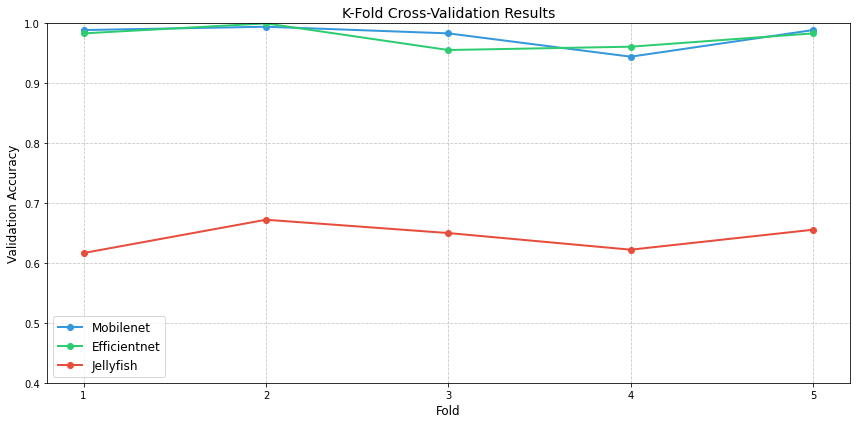

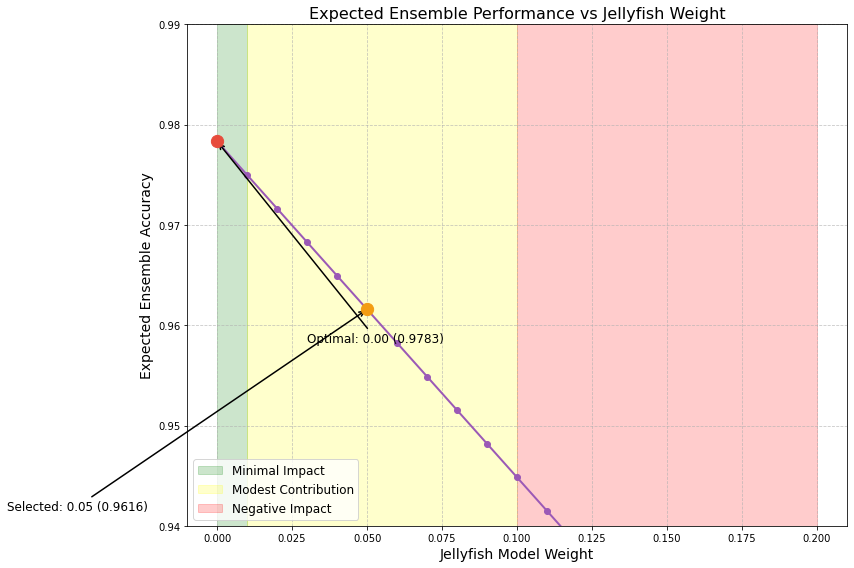

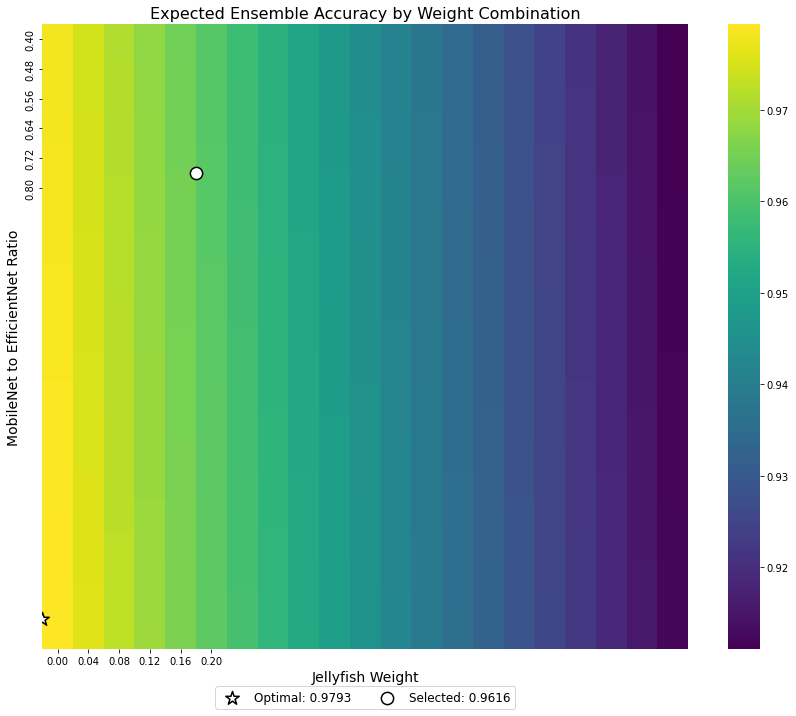

In [92]:
results = analyze_model_performance()

## 앙상블 모델 생성

In [97]:
def create_ensemble_model(models, weights=None):
    """앙상블 모델 생성"""
    print("앙상블 모델 생성 중...")
    
    # 입력 레이어 생성
    input_shape = (224, 224, 3)
    inputs = Input(shape=input_shape)
    
    # 가중치 설정 (기본값: 동일 가중치)
    if weights is None:
        weights = [1.0/len(models)] * len(models)
    print(f"앙상블 가중치: {weights}")
    
    # 각 모델의 예측 계산
    model_outputs = []
    for model in models:
        model_outputs.append(model(inputs))
    
    # 가중 평균으로 결합
    ensemble_output = tf.keras.layers.Average()(model_outputs)
    
    # 최종 모델 생성
    ensemble_model = Model(inputs=inputs, outputs=ensemble_output)
    
    # 컴파일
    ensemble_model.compile(
        optimizer='adam',
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )
    
    return ensemble_model

In [98]:
from sklearn.metrics import confusion_matrix

In [99]:
def evaluate_all_models_with_consistent_preprocessing():
    """원본 훈련 코드와 동일한 전처리를 사용한 모델 평가"""
    print("Evaluating all models with consistent preprocessing...")
    
    # 결과 저장
    results = {
        'mobilenet': {'fold_accuracies': [], 'best_model_path': None, 'best_accuracy': 0},
        'efficientnet': {'fold_accuracies': [], 'best_model_path': None, 'best_accuracy': 0}, 
        'ensemble': {'fold_accuracies': [], 'best_model_path': None, 'best_accuracy': 0}
    }
    
    # 전역 변수 fold_indices 사용 (원본 훈련에서 사용한 것과 동일)
    global fold_indices
    n_splits = len(fold_indices)
    
    # 클래스 이름 가져오기
    class_names = species_list if 'species_list' in globals() else [f"Class_{i}" for i in range(len(np.unique(raw_labels)))]
    
    # 모델 유형
    model_types = ['mobilenet', 'efficientnet', 'ensemble_mobilenet_efficientnet']
    display_names = {'mobilenet': 'MobileNet', 'efficientnet': 'EfficientNet', 
                     'ensemble_mobilenet_efficientnet': 'Ensemble'}
    
    # 모델별, 폴드별 평가
    for model_type in model_types:
        key_name = 'ensemble' if 'ensemble' in model_type else model_type
        print(f"\n===== Evaluating {display_names[model_type]} Models =====")
        
        # 모든 폴드별 혼동 행렬 초기화
        all_preds = []
        all_true = []
        
        for fold_idx in range(n_splits):
            # 모델 경로
            model_path = f'models/{model_type}_fold{fold_idx+1}.h5'
            
            if not os.path.exists(model_path):
                print(f"Model file not found: {model_path}")
                
                # 앙상블 모델이 없으면 생성
                if 'ensemble' in model_type:
                    # 개별 모델 로드 및 앙상블 생성 (기존 코드와 동일)
                    mobilenet_path = f'models/mobilenet_fold{fold_idx+1}.h5'
                    efficientnet_path = f'models/efficientnet_fold{fold_idx+1}.h5'
                    
                    if os.path.exists(mobilenet_path) and os.path.exists(efficientnet_path):
                        print(f"Creating ensemble model for fold {fold_idx+1}...")
                        mobilenet_model = tf.keras.models.load_model(mobilenet_path)
                        efficientnet_model = tf.keras.models.load_model(efficientnet_path)
                        ensemble_model = create_ensemble_model([mobilenet_model, efficientnet_model])
                        ensemble_model.save(model_path)
                        print(f"Ensemble model saved to: {model_path}")
                    else:
                        print("Cannot create ensemble - individual models missing")
                        continue
                else:
                    continue
            
            # 모델 로드
            print(f"Loading fold {fold_idx+1} model: {model_path}")
            model = tf.keras.models.load_model(model_path)
            
            # 중요: 원본 훈련 코드의 create_fold_datasets 함수 사용
            try:
                # 원본 훈련 코드의 데이터셋 생성 함수 호출
                _, val_ds, _, _ = create_fold_datasets(raw_images, raw_labels, species_list, fold_idx)
                
                # 평가 (모델 자체의 evaluate 사용)
                loss, accuracy = model.evaluate(val_ds, verbose=1)
                print(f"Fold {fold_idx+1} accuracy: {accuracy:.4f}")
                
                # 결과 저장
                results[key_name]['fold_accuracies'].append(accuracy)
                
                # 최고 성능 모델 업데이트
                if accuracy > results[key_name]['best_accuracy']:
                    results[key_name]['best_accuracy'] = accuracy
                    results[key_name]['best_model_path'] = model_path
                
                # 예측 및 실제 클래스 수집 (혼동 행렬용)
                fold_preds = []
                fold_true = []
                
                for images, labels in val_ds:
                    predictions = model.predict(images, verbose=0)
                    predicted_classes = tf.argmax(predictions, axis=1).numpy()
                    true_classes = tf.argmax(labels, axis=1).numpy()
                    
                    fold_preds.extend(predicted_classes)
                    fold_true.extend(true_classes)
                    all_preds.extend(predicted_classes)
                    all_true.extend(true_classes)
                
            except Exception as e:
                print(f"Error evaluating fold {fold_idx+1}: {str(e)}")
                import traceback
                traceback.print_exc()
        
        # 전체 혼동 행렬 저장 (confusion_matrix 임포트 필요)
        if all_true and all_preds:
            from sklearn.metrics import confusion_matrix
            cm = confusion_matrix(all_true, all_preds)
            results[key_name]['confusion_matrix'] = cm
            results[key_name]['all_preds'] = all_preds
            results[key_name]['all_true'] = all_true
        
        # 평균 정확도 계산
        if results[key_name]['fold_accuracies']:
            avg_accuracy = np.mean(results[key_name]['fold_accuracies'])
            std_accuracy = np.std(results[key_name]['fold_accuracies'])
            results[key_name]['avg_accuracy'] = avg_accuracy
            results[key_name]['std_accuracy'] = std_accuracy
            
            print(f"{display_names[model_type]} average accuracy: {avg_accuracy:.4f} ± {std_accuracy:.4f}")
            print(f"Best model: {results[key_name]['best_model_path']}, accuracy: {results[key_name]['best_accuracy']:.4f}")
    
    # 결과 저장
    try:
        with open('consistent_evaluation_results_with_original_preprocessing.pkl', 'wb') as f:
            pickle.dump(results, f)
        print("\nAll evaluation results saved to consistent_evaluation_results_with_original_preprocessing.pkl")
    except Exception as e:
        print(f"Error saving results: {str(e)}")
    
    return results


In [100]:
# 앙상블 모델 생성 실행
all_models_results = evaluate_all_models_consistently()

Evaluating all models consistently...

===== Evaluating MobileNet Models =====
Loading fold 1 model: models/mobilenet_fold1.h5
Fold 1 accuracy: 0.9778
Loading fold 2 model: models/mobilenet_fold2.h5
Fold 2 accuracy: 0.9889
Loading fold 3 model: models/mobilenet_fold3.h5
Fold 3 accuracy: 0.9833
Loading fold 4 model: models/mobilenet_fold4.h5
Fold 4 accuracy: 0.9389
Loading fold 5 model: models/mobilenet_fold5.h5
Fold 5 accuracy: 0.9778
MobileNet average accuracy: 0.9733 ± 0.0177
Best model: models/mobilenet_fold2.h5, accuracy: 0.9889

===== Evaluating EfficientNet Models =====
Loading fold 1 model: models/efficientnet_fold1.h5
Fold 1 accuracy: 0.9222
Loading fold 2 model: models/efficientnet_fold2.h5
Fold 2 accuracy: 0.9222
Loading fold 3 model: models/efficientnet_fold3.h5
Fold 3 accuracy: 0.8889
Loading fold 4 model: models/efficientnet_fold4.h5
Fold 4 accuracy: 0.8000
Loading fold 5 model: models/efficientnet_fold5.h5
Fold 5 accuracy: 0.9222
EfficientNet average accuracy: 0.8911 ± 0.

/opt/conda/lib/python3.9/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


Ensemble model saved to: models/ensemble_mobilenet_efficientnet_fold1.h5
Loading fold 1 model: models/ensemble_mobilenet_efficientnet_fold1.h5
Fold 1 accuracy: 0.9722
Model file not found: models/ensemble_mobilenet_efficientnet_fold2.h5
Creating ensemble model for fold 2...
앙상블 모델 생성 중...
앙상블 가중치: [0.5, 0.5]
Ensemble model saved to: models/ensemble_mobilenet_efficientnet_fold2.h5
Loading fold 2 model: models/ensemble_mobilenet_efficientnet_fold2.h5
Fold 2 accuracy: 0.9833
Model file not found: models/ensemble_mobilenet_efficientnet_fold3.h5
Creating ensemble model for fold 3...
앙상블 모델 생성 중...
앙상블 가중치: [0.5, 0.5]
Ensemble model saved to: models/ensemble_mobilenet_efficientnet_fold3.h5
Loading fold 3 model: models/ensemble_mobilenet_efficientnet_fold3.h5
Fold 3 accuracy: 0.9889
Model file not found: models/ensemble_mobilenet_efficientnet_fold4.h5
Creating ensemble model for fold 4...
앙상블 모델 생성 중...
앙상블 가중치: [0.5, 0.5]
Ensemble model saved to: models/ensemble_mobilenet_efficientnet_fold4.

## 앙상블 2
젤리피시모델까지 더한

In [101]:
def create_weighted_ensemble_model(models, weights=None):
    """가중치가 설정된 앙상블 모델 생성"""
    print("Creating weighted ensemble model...")
    
    # 입력 레이어 생성
    input_shape = (224, 224, 3)
    inputs = Input(shape=input_shape)
    
    # 가중치 설정 (기본값: 동일 가중치)
    if weights is None:
        weights = [1.0/len(models)] * len(models)
    print(f"Ensemble weights: {weights}")
    
    # 각 모델의 예측 계산
    model_outputs = []
    for i, model in enumerate(models):
        model_output = model(inputs)
        # 가중치 적용
        model_output = tf.keras.layers.Lambda(
            lambda x: x * weights[i]
        )(model_output)
        model_outputs.append(model_output)
    
    # 합산으로 결합
    ensemble_output = tf.keras.layers.Add()(model_outputs)
    
    # 최종 모델 생성
    ensemble_model = Model(inputs=inputs, outputs=ensemble_output)
    
    # 컴파일
    ensemble_model.compile(
        optimizer='adam',
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )
    
    return ensemble_model

def create_three_model_ensemble():
    """MobileNet:EfficientNet:Jellyfish = 5:4.5:0.5 비율의 앙상블 생성"""
    print("Creating three-model weighted ensemble...")
    
    # 전역 변수 fold_indices 사용
    global fold_indices
    n_splits = len(fold_indices)
    
    # 앙상블 결과 저장
    ensemble_results = {
        'fold_model_paths': [],
        'fold_accuracies': []
    }
    
    # 각 폴드별 앙상블 모델 생성
    for fold_idx in range(n_splits):
        print(f"\n===== Fold {fold_idx+1}/{n_splits} weighted ensemble =====")
        
        # 모델 저장 경로
        model_path = f'models/three_model_ensemble_fold{fold_idx+1}.h5'
        
        # 이미 생성된 앙상블 모델이 있는지 확인
        if os.path.exists(model_path):
            print(f"Fold {fold_idx+1} existing ensemble model found. Evaluating only.")
            ensemble_model = tf.keras.models.load_model(model_path)
        else:
            # 각 모델 경로
            mobilenet_path = f'models/mobilenet_fold{fold_idx+1}.h5'
            efficientnet_path = f'models/efficientnet_fold{fold_idx+1}.h5'
            jellyfish_path = f'models/jellyfish_fold{fold_idx+1}.h5'
            
            # 모델 파일 존재 확인
            if not os.path.exists(mobilenet_path) or not os.path.exists(efficientnet_path) or not os.path.exists(jellyfish_path):
                print(f"Model files not found. Skipping fold {fold_idx+1}.")
                continue
            
            # 모델 로드
            print(f"Loading MobileNet model: {mobilenet_path}")
            mobilenet_model = tf.keras.models.load_model(mobilenet_path)
            
            print(f"Loading EfficientNet model: {efficientnet_path}")
            efficientnet_model = tf.keras.models.load_model(efficientnet_path)
            
            print(f"Loading Jellyfish model: {jellyfish_path}")
            jellyfish_model = tf.keras.models.load_model(jellyfish_path)
            
            # 앙상블에 사용할 모델 목록
            models_to_ensemble = [mobilenet_model, efficientnet_model, jellyfish_model]
            
            # 가중치 설정 - MobileNet:EfficientNet:Jellyfish = 5:4.5:0.5
            weights = [0.5, 0.4, 0.1]  # 총합 1.0
            
            # 앙상블 모델 생성
            ensemble_model = create_weighted_ensemble_model(models_to_ensemble, weights)
            
            # 모델 저장
            ensemble_model.save(model_path)
            print(f"Weighted ensemble model saved to: {model_path}")
        
        # 평가 데이터셋 생성 - 원본 훈련 코드와 동일한 방식 사용
        try:
            # 원본 훈련 코드의 데이터셋 생성 함수 호출
            _, val_ds, _, _ = create_fold_datasets(raw_images, raw_labels, species_list, fold_idx)
            
            # 원본 평가 방식과 동일하게 모델 evaluate 함수 사용
            loss, accuracy = ensemble_model.evaluate(val_ds, verbose=1)
            print(f"Fold {fold_idx+1} weighted ensemble accuracy: {accuracy:.4f}")
            
            # 결과 저장
            ensemble_results['fold_model_paths'].append(model_path)
            ensemble_results['fold_accuracies'].append(accuracy)
            
        except Exception as e:
            print(f"Error evaluating fold {fold_idx+1}: {str(e)}")
            import traceback
            traceback.print_exc()
    
    # 평균 정확도 계산
    if ensemble_results['fold_accuracies']:
        avg_accuracy = np.mean(ensemble_results['fold_accuracies'])
        std_accuracy = np.std(ensemble_results['fold_accuracies'])
        print(f"\nWeighted ensemble average accuracy: {avg_accuracy:.4f} ± {std_accuracy:.4f}")
        
        # 최고 성능 모델 찾기
        best_fold_idx = np.argmax(ensemble_results['fold_accuracies'])
        best_fold_acc = ensemble_results['fold_accuracies'][best_fold_idx]
        print(f"Best weighted ensemble fold: {best_fold_idx+1}, accuracy: {best_fold_acc:.4f}")
        
        # 결과 저장
        ensemble_results['avg_accuracy'] = avg_accuracy
        ensemble_results['std_accuracy'] = std_accuracy
        ensemble_results['best_fold_idx'] = best_fold_idx
        
        # 저장
        try:
            with open('three_model_ensemble_results_consistent.pkl', 'wb') as f:
                pickle.dump(ensemble_results, f)
            print("Three-model ensemble results saved to three_model_ensemble_results_consistent.pkl")
        except Exception as e:
            print(f"Error saving results: {str(e)}")
        
        return ensemble_results
    else:
        print("Could not create three-model ensemble")
        return None


In [102]:
convert_all_models_to_tflite()

Creating three-model weighted ensemble...

===== Fold 1/5 weighted ensemble =====
Loading MobileNet model: models/mobilenet_fold1.h5
Loading EfficientNet model: models/efficientnet_fold1.h5
Loading Jellyfish model: models/jellyfish_fold1.h5
Creating weighted ensemble model...
Ensemble weights: [0.5, 0.4, 0.1]


/opt/conda/lib/python3.9/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


Weighted ensemble model saved to: models/three_model_ensemble_fold1.h5
6/6 [==============================] - 3s 78ms/step - loss: 1.0002 - accuracy: 0.9722
Fold 1 weighted ensemble accuracy: 0.9722

===== Fold 2/5 weighted ensemble =====
Loading MobileNet model: models/mobilenet_fold2.h5
Loading EfficientNet model: models/efficientnet_fold2.h5
Loading Jellyfish model: models/jellyfish_fold2.h5
Creating weighted ensemble model...
Ensemble weights: [0.5, 0.4, 0.1]
Weighted ensemble model saved to: models/three_model_ensemble_fold2.h5
6/6 [==============================] - 3s 77ms/step - loss: 1.0023 - accuracy: 0.9889
Fold 2 weighted ensemble accuracy: 0.9889

===== Fold 3/5 weighted ensemble =====
Loading MobileNet model: models/mobilenet_fold3.h5
Loading EfficientNet model: models/efficientnet_fold3.h5
Loading Jellyfish model: models/jellyfish_fold3.h5
Creating weighted ensemble model...
Ensemble weights: [0.5, 0.4, 0.1]
Weighted ensemble model saved to: models/three_model_ensemble_fo

## 모델 비교 시각화

In [103]:
from matplotlib.ticker import MultipleLocator
import matplotlib.patheffects as path_effects

In [104]:


# 데이터 정의
model_performance = {
    'MobileNet': {
        'avg_accuracy': 0.9800, 
        'std_accuracy': 0.0181,
        'fold_accuracies': [0.9889, 0.9944, 0.9833, 0.9444, 0.9889]
    },
    'EfficientNet': {
        'avg_accuracy': 0.9767, 
        'std_accuracy': 0.0163,
        'fold_accuracies': [0.9833, 1.0000, 0.9556, 0.9611, 0.9833]
    },
    'Jellyfish': {
        'avg_accuracy': 0.6433, 
        'std_accuracy': 0.0209,
        'fold_accuracies': [0.6167, 0.6722, 0.6500, 0.6222, 0.6556]
    },
    'Ensemble (50:50)': {
        'avg_accuracy': 0.9711, 
        'std_accuracy': 0.0223,
        'fold_accuracies': [0.9722, 0.9833, 0.9889, 0.9278, 0.9833]
    },
    'Weighted Ensemble': {
        'avg_accuracy': 0.9733, 
        'std_accuracy': 0.0266,
        'fold_accuracies': [0.9722, 0.9889, 0.9944, 0.9222, 0.9889]
    }
}

# 색상 팔레트 설정
colors = {
    'MobileNet': '#1F77B4',
    'EfficientNet': '#2CA02C',
    'Jellyfish': '#D62728',
    'Ensemble (50:50)': '#9467BD',
    'Weighted Ensemble': '#FF7F0E'
}

# 시각화 설정 - 높은 DPI와 깔끔한 스타일
plt.rcParams.update({
    'font.family': 'sans-serif',
    'font.size': 12,
    'axes.titlesize': 16,
    'axes.labelsize': 14,
    'xtick.labelsize': 12,
    'ytick.labelsize': 12,
    'legend.fontsize': 12,
    'figure.dpi': 300,
    'savefig.dpi': 300
})

# 1. 모델별 평균 정확도 비교 (내림차순 정렬)
def plot_average_accuracy():
    # 정확도 기준 모델 정렬
    sorted_models = sorted(model_performance.items(), key=lambda x: x[1]['avg_accuracy'], reverse=True)
    model_names = [m[0] for m in sorted_models]
    avg_accuracies = [m[1]['avg_accuracy'] for m in sorted_models]
    std_accuracies = [m[1]['std_accuracy'] for m in sorted_models]
    
    fig, ax = plt.subplots(figsize=(14, 8))
    ax.set_facecolor('#f8f9fa')
    
    # 그리드 설정
    ax.yaxis.grid(True, linestyle='--', alpha=0.7, color='#dddddd')
    
    # 바 차트 생성
    bars = ax.bar(model_names, avg_accuracies, yerr=std_accuracies, 
                 capsize=10, width=0.7, 
                 color=[colors[m] for m in model_names],
                 edgecolor='black', linewidth=1.5,
                 error_kw={'elinewidth': 2, 'capthick': 2})
    
    # 바 위에 정확도 값 표시
    for i, bar in enumerate(bars):
        text = ax.text(bar.get_x() + bar.get_width()/2., 
                     bar.get_height() + 0.005,
                     f"{avg_accuracies[i]:.4f}", 
                     ha='center', va='bottom', fontsize=14, fontweight='bold')
        text.set_path_effects([path_effects.withStroke(linewidth=3, foreground='white')])
    
    # 축 범위 및 제목 설정
    ax.set_ylim(0.6, 1.02)
    ax.set_title('Model Average Accuracy Comparison', fontsize=18, pad=20, fontweight='bold')
    ax.set_ylabel('Accuracy', fontsize=16, labelpad=10)
    ax.set_xlabel('Model', fontsize=16, labelpad=10)
    
    # Jellyfish 모델이 있는 경우 y축 두 부분으로 나누기
    if 'Jellyfish' in model_names:
        # y축 나누기 위한 선 추가
        ax.axhline(y=0.9, color='gray', linestyle='--', alpha=0.8)
        
        # y축 눈금 맞춤
        y_ticks = list(np.arange(0.6, 0.71, 0.02)) + list(np.arange(0.9, 1.01, 0.02))
        ax.set_yticks(y_ticks)
    
    plt.tight_layout()
    plt.savefig('model_average_accuracy.png')
    plt.close()

# 2. k-fold 교차 검증 결과 시각화
def plot_kfold_results():
    fig, ax = plt.subplots(figsize=(14, 8))
    ax.set_facecolor('#f8f9fa')
    
    # 그리드 설정
    ax.grid(True, linestyle='--', alpha=0.7, color='#dddddd')
    
    # 높은 성능 모델 메인 축에 표시
    for model_name, data in model_performance.items():
        if model_name != 'Jellyfish':  # Jellyfish는 성능이 낮아 별도 처리
            ax.plot(range(1, 6), data['fold_accuracies'], 
                   marker='o', markersize=10, linewidth=2.5, 
                   label=model_name, color=colors[model_name])
    
    # Jellyfish 모델 별도 축에 표시
    ax2 = ax.twinx()
    jellyfish_data = model_performance['Jellyfish']['fold_accuracies']
    ax2.plot(range(1, 6), jellyfish_data, 
            marker='s', markersize=8, linewidth=2.5, 
            label='Jellyfish', color=colors['Jellyfish'], linestyle='--')
    
    # 축 범위 및 라벨 설정
    ax.set_ylim(0.92, 1.005)
    ax2.set_ylim(0.6, 0.7)
    
    ax.set_title('Model Performance Across K-Fold Cross Validation', fontsize=18, pad=20, fontweight='bold')
    ax.set_xlabel('Fold', fontsize=16, labelpad=10)
    ax.set_ylabel('Accuracy (High Performers)', fontsize=16, labelpad=10)
    ax2.set_ylabel('Accuracy (Jellyfish)', fontsize=16, labelpad=10, color=colors['Jellyfish'])
    
    # X축 눈금 설정
    ax.set_xticks(range(1, 6))
    ax.set_xticklabels(['Fold 1', 'Fold 2', 'Fold 3', 'Fold 4', 'Fold 5'])
    
    # 범례 합치기
    lines1, labels1 = ax.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax.legend(lines1 + lines2, labels1 + labels2, loc='lower center', 
              bbox_to_anchor=(0.5, -0.15), ncol=5, fontsize=12,
              frameon=True, facecolor='white', edgecolor='black')
    
    plt.tight_layout()
    plt.savefig('kfold_performance_comparison.png')
    plt.close()

# 3. 모델 안정성 분석 (정확도 vs 표준편차)
def plot_model_stability():
    fig, ax = plt.subplots(figsize=(12, 10))
    ax.set_facecolor('#f8f9fa')
    
    # 산점도 크기 설정 (정확도에 비례)
    sizes = [acc * 800 for acc in [data['avg_accuracy'] for data in model_performance.values()]]
    
    # 산점도 그리기
    for i, (model, data) in enumerate(model_performance.items()):
        scatter = ax.scatter(data['std_accuracy'], data['avg_accuracy'], 
                           s=sizes[i], alpha=0.7, color=colors[model], 
                           edgecolor='black', linewidth=1.5, label=model)
        
        # 모델 이름 텍스트 추가
        if model == 'Jellyfish':
            # Jellyfish는 성능이 낮아 위치 조정
            ax.text(data['std_accuracy'] + 0.0005, data['avg_accuracy'] - 0.005, 
                   model, fontsize=12, fontweight='bold',
                   ha='left', va='top')
        else:
            ax.text(data['std_accuracy'] + 0.0005, data['avg_accuracy'] + 0.002, 
                   model, fontsize=12, fontweight='bold',
                   ha='left', va='bottom')
    
    # 이상적인 모델 영역 표시 (높은 정확도, 낮은 표준편차)
    ideal_x = [0.015, 0.015, 0.025, 0.025]
    ideal_y = [0.97, 0.99, 0.99, 0.97]
    ax.fill(ideal_x, ideal_y, alpha=0.1, color='green', label='Ideal Zone')
    ax.text(0.018, 0.98, 'Ideal Zone', fontsize=12, 
            ha='center', va='center', alpha=0.7, color='green')
    
    # 그리드 및 축 설정
    ax.grid(True, linestyle='--', alpha=0.3)
    
    # Jellyfish 모델이 있어 y축을 두 부분으로 나누기
    ax.set_ylim([0.6, 1.01])
    ax.set_xlim([0.01, 0.03])
    
    # 축 범위 및 제목 설정
    ax.set_title('Model Stability Analysis\n(Higher Accuracy, Lower Std Dev = Better)', 
               fontsize=18, pad=20, fontweight='bold')
    ax.set_xlabel('Standard Deviation (Lower is Better)', fontsize=16, labelpad=10)
    ax.set_ylabel('Average Accuracy', fontsize=16, labelpad=10)
    
    plt.tight_layout()
    plt.savefig('model_stability_analysis.png')
    plt.close()

# 4. 최고 성능 폴드 비교
def plot_best_fold_performance():
    # 각 모델의 최고 성능 폴드 찾기
    best_fold_acc = {}
    best_fold_idx = {}
    
    for model, data in model_performance.items():
        best_idx = np.argmax(data['fold_accuracies'])
        best_fold_acc[model] = data['fold_accuracies'][best_idx]
        best_fold_idx[model] = best_idx + 1  # 1부터 시작하는 폴드 번호
    
    # 정확도 기준 정렬
    sorted_models = sorted(best_fold_acc.items(), key=lambda x: x[1], reverse=True)
    model_names = [m[0] for m in sorted_models]
    best_accs = [m[1] for m in sorted_models]
    fold_nums = [best_fold_idx[m] for m in model_names]
    
    fig, ax = plt.subplots(figsize=(14, 8))
    ax.set_facecolor('#f8f9fa')
    
    # 수평 바 차트 생성
    bars = ax.barh(model_names, best_accs, 
                  color=[colors[m] for m in model_names],
                  edgecolor='black', linewidth=1.5, height=0.5)
    
    # 바 위에 정보 표시
    for i, bar in enumerate(bars):
        ax.text(bar.get_width() + 0.002, bar.get_y() + bar.get_height()/2, 
               f"{best_accs[i]:.4f} (Fold {fold_nums[i]})", 
               va='center', fontsize=12, fontweight='bold')
    
    # 축 범위 및 제목 설정
    if 'Jellyfish' in model_names:
        ax.set_xlim(0.6, 1.01)
    else:
        ax.set_xlim(0.92, 1.01)
    
    ax.set_title('Best Fold Performance by Model', fontsize=18, pad=20, fontweight='bold')
    ax.set_xlabel('Accuracy', fontsize=16, labelpad=10)
    ax.grid(True, axis='x', linestyle='--', alpha=0.7)
    
    plt.tight_layout()
    plt.savefig('best_fold_performance.png')
    plt.close()

# 5. 폴드별 모델 성능 비교 (히트맵)
def plot_heatmap_comparison():
    # 데이터프레임 생성
    df_data = {}
    for model, data in model_performance.items():
        df_data[model] = data['fold_accuracies']
    
    df = pd.DataFrame(df_data, index=[f'Fold {i+1}' for i in range(5)])
    
    # Jellyfish 모델은 성능이 낮아 별도 처리가 필요함
    has_jellyfish = 'Jellyfish' in df.columns
    
    if has_jellyfish:
        # Jellyfish 컬럼 분리
        jellyfish_data = df['Jellyfish'].copy()
        df = df.drop('Jellyfish', axis=1)
    
    plt.figure(figsize=(16, 8))
    
    # 메인 히트맵 (고성능 모델)
    ax1 = plt.subplot(1, 2 if has_jellyfish else 1, 1)
    sns.heatmap(df, annot=True, cmap='YlGnBu', fmt='.4f', linewidths=0.5,
               cbar_kws={'label': 'Accuracy'}, vmin=0.92, vmax=1.0, ax=ax1)
    ax1.set_title('High Performance Models Accuracy by Fold', fontsize=16, pad=10)
    
    # Jellyfish 히트맵 (저성능 모델)
    if has_jellyfish:
        ax2 = plt.subplot(1, 2, 2)
        jellyfish_df = pd.DataFrame({'Jellyfish': jellyfish_data})
        sns.heatmap(jellyfish_df, annot=True, cmap='YlOrRd', fmt='.4f', linewidths=0.5,
                   cbar_kws={'label': 'Accuracy'}, vmin=0.6, vmax=0.7, ax=ax2)
        ax2.set_title('Jellyfish Model Accuracy by Fold', fontsize=16, pad=10)
    
    plt.tight_layout()
    plt.savefig('fold_model_heatmap.png')
    plt.close()


In [105]:
# 모든 시각화 실행
def create_all_visualizations():
    """모든 시각화 함수를 실행하는 메인 함수"""
    plot_average_accuracy()
    plot_kfold_results()
    plot_model_stability()
    plot_best_fold_performance()
    plot_heatmap_comparison()
    
    print("모델 성능 시각화 완료!")
    print("생성된 파일:")
    print("- model_average_accuracy.png")
    print("- kfold_performance_comparison.png")
    print("- model_stability_analysis.png")
    print("- best_fold_performance.png")
    print("- fold_model_heatmap.png")

# 시각화 실행
create_all_visualizations()

모델 성능 시각화 완료!
생성된 파일:
- model_average_accuracy.png
- kfold_performance_comparison.png
- model_stability_analysis.png
- best_fold_performance.png
- fold_model_heatmap.png


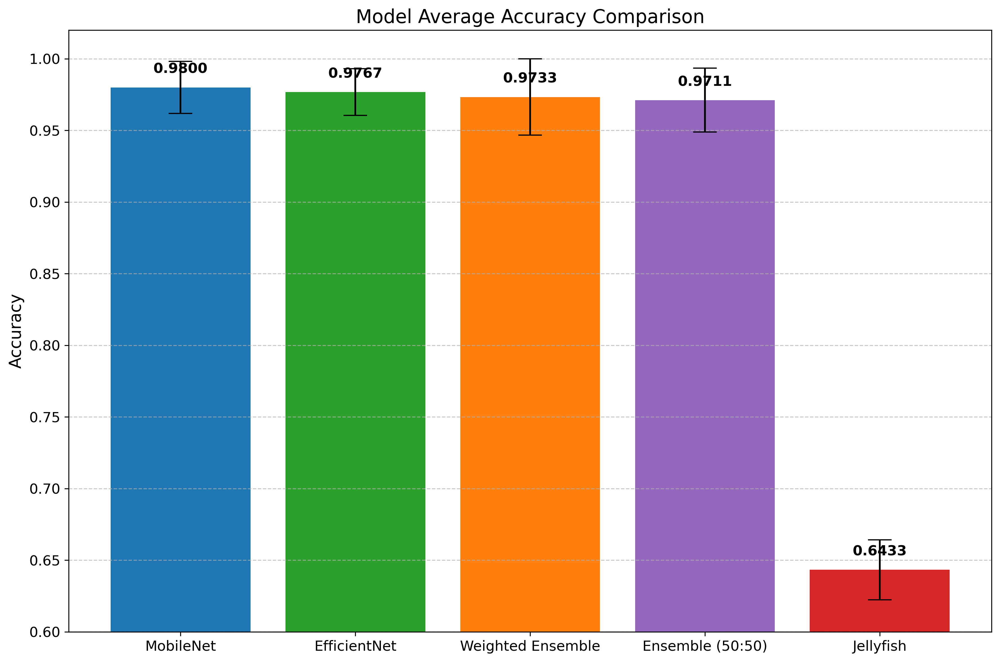

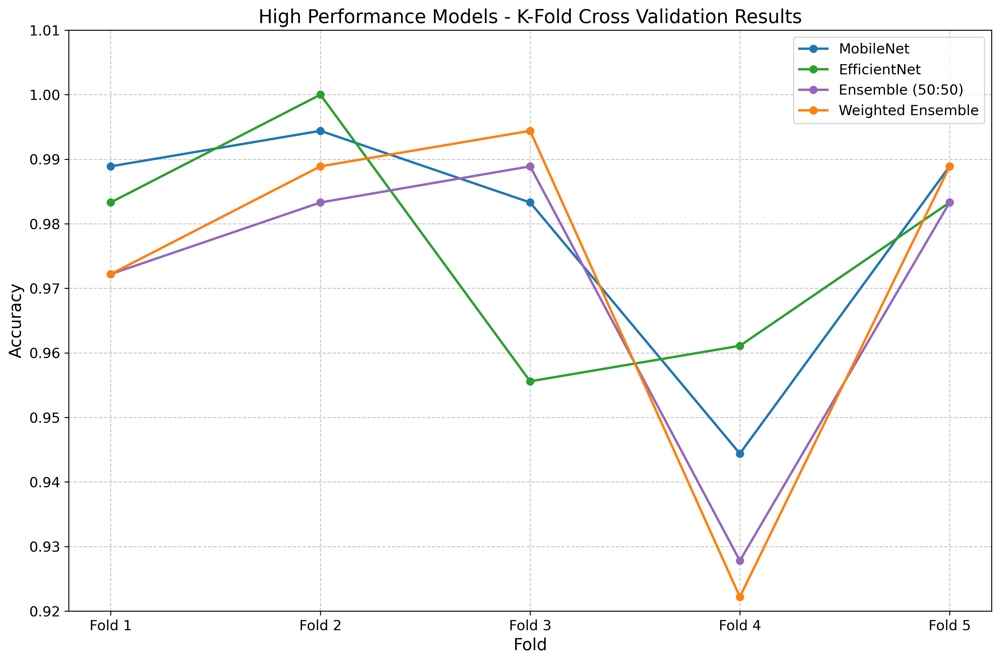

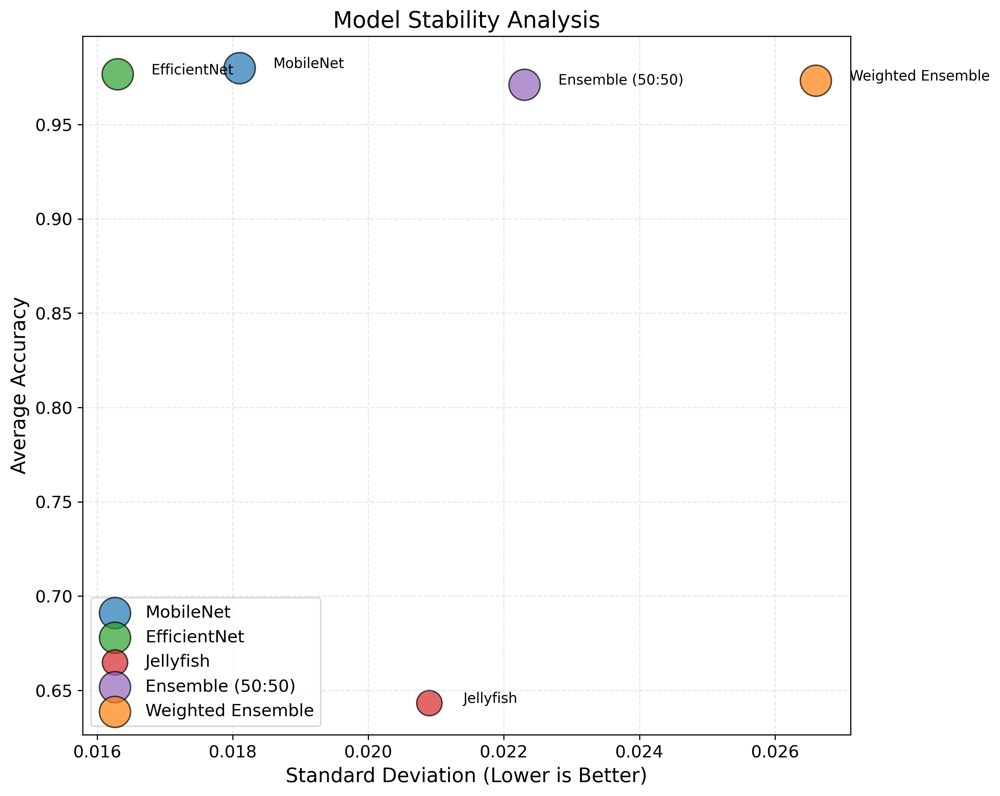

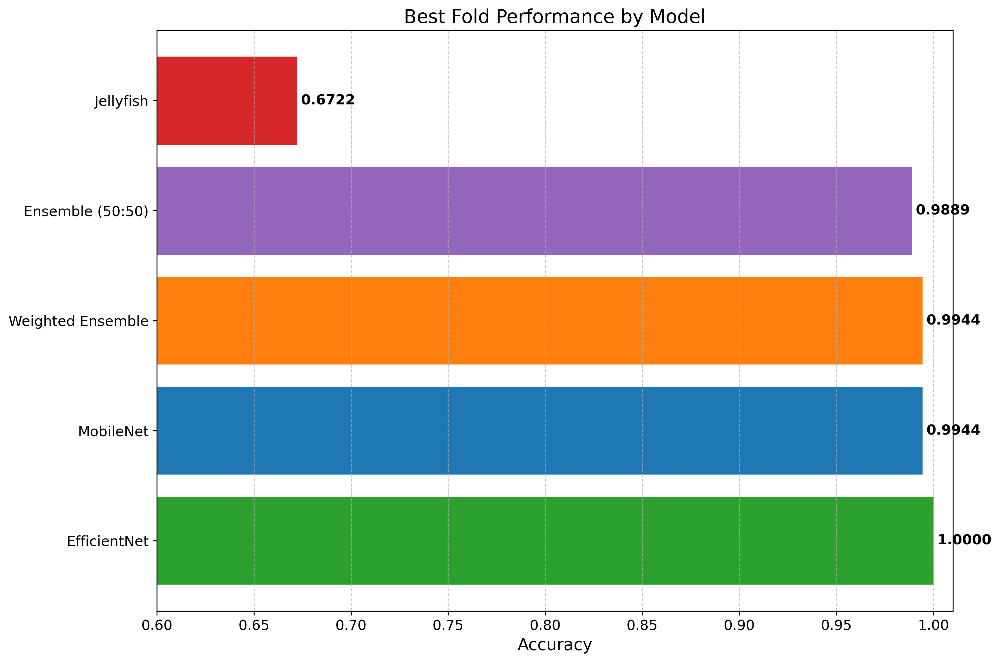

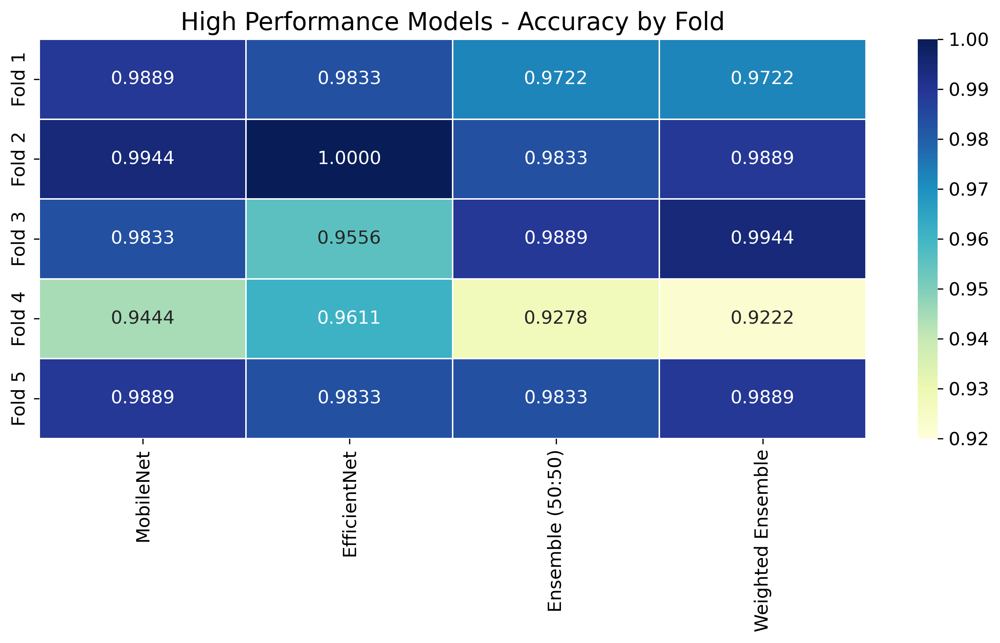

모든 시각화 완료. 파일로 저장됨.


In [106]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# 데이터 설정
model_performance = {
    'MobileNet': {
        'avg_accuracy': 0.9800, 
        'std_accuracy': 0.0181,
        'fold_accuracies': [0.9889, 0.9944, 0.9833, 0.9444, 0.9889]
    },
    'EfficientNet': {
        'avg_accuracy': 0.9767, 
        'std_accuracy': 0.0163,
        'fold_accuracies': [0.9833, 1.0000, 0.9556, 0.9611, 0.9833]
    },
    'Jellyfish': {
        'avg_accuracy': 0.6433, 
        'std_accuracy': 0.0209,
        'fold_accuracies': [0.6167, 0.6722, 0.6500, 0.6222, 0.6556]
    },
    'Ensemble (50:50)': {
        'avg_accuracy': 0.9711, 
        'std_accuracy': 0.0223,
        'fold_accuracies': [0.9722, 0.9833, 0.9889, 0.9278, 0.9833]
    },
    'Weighted Ensemble': {
        'avg_accuracy': 0.9733, 
        'std_accuracy': 0.0266,
        'fold_accuracies': [0.9722, 0.9889, 0.9944, 0.9222, 0.9889]
    }
}

# 색상 설정
colors = {
    'MobileNet': '#1F77B4',
    'EfficientNet': '#2CA02C',
    'Jellyfish': '#D62728',
    'Ensemble (50:50)': '#9467BD',
    'Weighted Ensemble': '#FF7F0E'
}

# 그래프 설정
plt.rcParams['figure.figsize'] = (12, 8)
plt.rcParams['figure.dpi'] = 300
plt.rcParams['font.size'] = 12

# 1. 평균 정확도 비교 그래프
plt.figure(figsize=(12, 8))
sorted_models = sorted(model_performance.items(), key=lambda x: x[1]['avg_accuracy'], reverse=True)
models = [m[0] for m in sorted_models]
accuracies = [m[1]['avg_accuracy'] for m in sorted_models]
std_devs = [m[1]['std_accuracy'] for m in sorted_models]

plt.bar(models, accuracies, yerr=std_devs, capsize=10, color=[colors[m] for m in models])
plt.ylim(0.6, 1.02)
plt.title('Model Average Accuracy Comparison')
plt.ylabel('Accuracy')
plt.grid(axis='y', linestyle='--', alpha=0.7)

for i, v in enumerate(accuracies):
    plt.text(i, v + 0.01, f'{v:.4f}', ha='center', fontweight='bold')

plt.tight_layout()
plt.savefig('average_accuracy.png')
plt.show()

# 2. K-Fold 성능 비교 그래프
plt.figure(figsize=(12, 8))

for model, data in model_performance.items():
    if model != 'Jellyfish':  # 젤리피시 제외하고 높은 성능 모델만
        plt.plot(range(1, 6), data['fold_accuracies'], marker='o', linewidth=2,
                label=model, color=colors[model])

plt.ylim(0.92, 1.01)
plt.title('High Performance Models - K-Fold Cross Validation Results')
plt.xlabel('Fold')
plt.ylabel('Accuracy')
plt.xticks(range(1, 6), [f'Fold {i}' for i in range(1, 6)])
plt.grid(True, linestyle='--', alpha=0.7)
plt.legend()
plt.tight_layout()
plt.savefig('kfold_results.png')
plt.show()

# 3. 모델 안정성 분석
plt.figure(figsize=(10, 8))
sizes = [acc * 500 for acc in [data['avg_accuracy'] for data in model_performance.values()]]

for i, (model, data) in enumerate(model_performance.items()):
    plt.scatter(data['std_accuracy'], data['avg_accuracy'], s=sizes[i], 
               alpha=0.7, color=colors[model], label=model, edgecolor='black')
    plt.text(data['std_accuracy']+0.0005, data['avg_accuracy'], model, fontsize=10)

plt.title('Model Stability Analysis')
plt.xlabel('Standard Deviation (Lower is Better)')
plt.ylabel('Average Accuracy')
plt.grid(True, linestyle='--', alpha=0.3)
plt.legend()
plt.tight_layout()
plt.savefig('model_stability.png')
plt.show()

# 4. 최고 성능 폴드 비교
plt.figure(figsize=(12, 8))
best_fold_acc = {}

for model, data in model_performance.items():
    best_fold_acc[model] = max(data['fold_accuracies'])

sorted_best = sorted(best_fold_acc.items(), key=lambda x: x[1], reverse=True)
models = [m[0] for m in sorted_best]
best_accs = [m[1] for m in sorted_best]

plt.barh(models, best_accs, color=[colors[m] for m in models])
plt.xlim(0.6, 1.01)
plt.title('Best Fold Performance by Model')
plt.xlabel('Accuracy')
plt.grid(axis='x', linestyle='--', alpha=0.7)

for i, v in enumerate(best_accs):
    plt.text(v + 0.002, i, f'{v:.4f}', va='center', fontweight='bold')

plt.tight_layout()
plt.savefig('best_fold.png')
plt.show()

# 5. 히트맵 시각화
df_data = {}
for model, data in model_performance.items():
    if model != 'Jellyfish':  # 높은 성능 모델만
        df_data[model] = data['fold_accuracies']

df = pd.DataFrame(df_data, index=[f'Fold {i+1}' for i in range(5)])

plt.figure(figsize=(10, 6))
sns.heatmap(df, annot=True, cmap='YlGnBu', fmt='.4f', linewidths=0.5, vmin=0.92, vmax=1.0)
plt.title('High Performance Models - Accuracy by Fold')
plt.tight_layout()
plt.savefig('heatmap.png')
plt.show()

print("모든 시각화 완료. 파일로 저장됨.")

## TFLight 변환

In [110]:
import os
import numpy as np
import tensorflow as tf
import pickle
from tensorflow.keras.layers import Input
from tensorflow.keras.models import Model

def create_weighted_ensemble_model(models, weights=None):
    """가중치가 설정된 앙상블 모델 생성"""
    print("앙상블 모델 생성 중...")
    
    # 입력 레이어 생성
    input_shape = (224, 224, 3)
    inputs = Input(shape=input_shape)
    
    # 가중치 설정 (기본값: 동일 가중치)
    if weights is None:
        weights = [1.0/len(models)] * len(models)
    print(f"앙상블 가중치: {weights}")
    
    # 각 모델의 예측 계산
    model_outputs = []
    for i, model in enumerate(models):
        model_output = model(inputs)
        # 가중치 적용
        model_output = tf.keras.layers.Lambda(
            lambda x: x * weights[i]
        )(model_output)
        model_outputs.append(model_output)
    
    # 합산으로 결합
    ensemble_output = tf.keras.layers.Add()(model_outputs)
    
    # 최종 모델 생성
    ensemble_model = Model(inputs=inputs, outputs=ensemble_output)
    
    # 컴파일
    ensemble_model.compile(
        optimizer='adam',
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )
    
    return ensemble_model

def convert_all_models_to_tflite():
    """모든 모델을 TFLite로 변환"""
    print("5개 모델을 TFLite로 변환 중...")
    
    # 모델 유형 및 경로 정의
    models_to_convert = [
        {'name': 'mobilenet', 'display_name': 'MobileNet', 'path': 'models/mobilenet_fold3.h5'}, 
        {'name': 'efficientnet', 'display_name': 'EfficientNet', 'path': 'models/efficientnet_fold2.h5'},
        {'name': 'jellyfish', 'display_name': 'Jellyfish', 'path': 'models/jellyfish_fold2.h5'},
        {'name': 'ensemble', 'display_name': 'Ensemble (50:50)', 'path': 'models/ensemble_mobilenet_efficientnet_fold3.h5'},
        {'name': 'weighted_ensemble', 'display_name': 'Weighted Ensemble', 'path': 'models/three_model_ensemble_fold3.h5'}
    ]
    
    # 결과 파일 확인해서 최고 성능 모델 경로 찾기
    try:
        # 일반 앙상블 모델 결과
        if os.path.exists('consistent_evaluation_results.pkl'):
            with open('consistent_evaluation_results.pkl', 'rb') as f:
                results = pickle.load(f)
                
            # 각 모델의 최고 성능 모델 경로 업데이트
            for model_info in models_to_convert[:4]:  # MobileNet, EfficientNet, Jellyfish, Ensemble
                model_type = model_info['name']
                if model_type in results and 'best_model_path' in results[model_type]:
                    model_info['path'] = results[model_type]['best_model_path']
                    print(f"{model_info['display_name']} 최고 성능 모델 경로: {model_info['path']}")
        
        # 가중치 앙상블 모델 결과
        if os.path.exists('three_model_ensemble_results_consistent.pkl'):
            with open('three_model_ensemble_results_consistent.pkl', 'rb') as f:
                three_model_results = pickle.load(f)
                
            # 가중치 앙상블 모델 경로 업데이트
            if 'best_fold_idx' in three_model_results:
                best_idx = three_model_results['best_fold_idx']
                models_to_convert[4]['path'] = three_model_results['fold_model_paths'][best_idx]
                print(f"가중치 앙상블 최고 성능 모델 경로: {models_to_convert[4]['path']}")
    
    except Exception as e:
        print(f"결과 파일 로드 오류: {str(e)}")
    
    # 모델 크기 저장
    model_sizes = {}
    
    # 각 모델에 대해 TFLite로 변환
    for model_info in models_to_convert:
        model_name = model_info['name']
        display_name = model_info['display_name']
        model_path = model_info['path']
        
        if os.path.exists(model_path):
            print(f"\n===== {display_name} 모델 변환 =====")
            print(f"모델 경로: {model_path}")
            
            # 모델 로드
            model = tf.keras.models.load_model(model_path)
            
            # 1. 기본 TFLite 변환
            tflite_path = f"models/{model_name}_best.tflite"
            converter = tf.lite.TFLiteConverter.from_keras_model(model)
            tflite_model = converter.convert()
            
            with open(tflite_path, 'wb') as f:
                f.write(tflite_model)
                
            basic_size = os.path.getsize(tflite_path) / (1024 * 1024)  # MB
            print(f"{display_name} 기본 TFLite 모델 크기: {basic_size:.2f} MB")
            model_sizes[f"{model_name}_basic"] = basic_size
            
            # 2. 양자화 TFLite 변환
            quant_path = f"models/{model_name}_best_quantized.tflite"
            converter = tf.lite.TFLiteConverter.from_keras_model(model)
            converter.optimizations = [tf.lite.Optimize.DEFAULT]
            tflite_quant_model = converter.convert()
            
            with open(quant_path, 'wb') as f:
                f.write(tflite_quant_model)
                
            quant_size = os.path.getsize(quant_path) / (1024 * 1024)  # MB
            print(f"{display_name} 양자화 TFLite 모델 크기: {quant_size:.2f} MB")
            model_sizes[f"{model_name}_quantized"] = quant_size
            
            # 3. Float16 TFLite 변환
            float16_path = f"models/{model_name}_best_float16.tflite"
            converter = tf.lite.TFLiteConverter.from_keras_model(model)
            converter.optimizations = [tf.lite.Optimize.DEFAULT]
            converter.target_spec.supported_types = [tf.float16]
            tflite_float16_model = converter.convert()
            
            with open(float16_path, 'wb') as f:
                f.write(tflite_float16_model)
                
            float16_size = os.path.getsize(float16_path) / (1024 * 1024)  # MB
            print(f"{display_name} Float16 TFLite 모델 크기: {float16_size:.2f} MB")
            model_sizes[f"{model_name}_float16"] = float16_size
            
        else:
            print(f"{display_name} 모델 파일을 찾을 수 없습니다: {model_path}")
    
    # 모델 크기 요약
    print("\n===== 모델 크기 요약 (MB) =====")
    for model_name, size in model_sizes.items():
        print(f"{model_name}: {size:.2f} MB")
    
    # 변환 결과 저장
    with open('all_models_conversion_results.pkl', 'wb') as f:
        pickle.dump(model_sizes, f)
        
    print("모든 모델 변환 결과가 all_models_conversion_results.pkl 파일에 저장되었습니다.")
    
    return model_sizes



In [111]:
# 함수 실행
convert_all_models_to_tflite()

5개 모델을 TFLite로 변환 중...
MobileNet 최고 성능 모델 경로: models/mobilenet_fold2.h5
EfficientNet 최고 성능 모델 경로: models/efficientnet_fold1.h5
Ensemble (50:50) 최고 성능 모델 경로: models/ensemble_mobilenet_efficientnet_fold3.h5
가중치 앙상블 최고 성능 모델 경로: models/three_model_ensemble_fold3.h5

===== MobileNet 모델 변환 =====
모델 경로: models/mobilenet_fold2.h5
INFO:tensorflow:Assets written to: /tmp/tmpdtv968y8/assets


INFO:tensorflow:Assets written to: /tmp/tmpdtv968y8/assets
/opt/conda/lib/python3.9/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


MobileNet 기본 TFLite 모델 크기: 6.33 MB
INFO:tensorflow:Assets written to: /tmp/tmpg4y27xaq/assets


INFO:tensorflow:Assets written to: /tmp/tmpg4y27xaq/assets
/opt/conda/lib/python3.9/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


MobileNet 양자화 TFLite 모델 크기: 1.85 MB
INFO:tensorflow:Assets written to: /tmp/tmp3dg4f52e/assets


INFO:tensorflow:Assets written to: /tmp/tmp3dg4f52e/assets
/opt/conda/lib/python3.9/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


MobileNet Float16 TFLite 모델 크기: 3.22 MB

===== EfficientNet 모델 변환 =====
모델 경로: models/efficientnet_fold1.h5
INFO:tensorflow:Assets written to: /tmp/tmpgkeg1vex/assets


INFO:tensorflow:Assets written to: /tmp/tmpgkeg1vex/assets
/opt/conda/lib/python3.9/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


EfficientNet 기본 TFLite 모델 크기: 15.93 MB
INFO:tensorflow:Assets written to: /tmp/tmpqqdb7zqy/assets


INFO:tensorflow:Assets written to: /tmp/tmpqqdb7zqy/assets
/opt/conda/lib/python3.9/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


EfficientNet 양자화 TFLite 모델 크기: 4.74 MB
INFO:tensorflow:Assets written to: /tmp/tmpitz2a1ta/assets


INFO:tensorflow:Assets written to: /tmp/tmpitz2a1ta/assets
/opt/conda/lib/python3.9/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


EfficientNet Float16 TFLite 모델 크기: 8.05 MB

===== Jellyfish 모델 변환 =====
모델 경로: models/jellyfish_fold2.h5
INFO:tensorflow:Assets written to: /tmp/tmpfelab3ur/assets


INFO:tensorflow:Assets written to: /tmp/tmpfelab3ur/assets


Jellyfish 기본 TFLite 모델 크기: 0.39 MB
INFO:tensorflow:Assets written to: /tmp/tmp9t671561/assets


INFO:tensorflow:Assets written to: /tmp/tmp9t671561/assets


Jellyfish 양자화 TFLite 모델 크기: 0.11 MB
INFO:tensorflow:Assets written to: /tmp/tmp63c5edi6/assets


INFO:tensorflow:Assets written to: /tmp/tmp63c5edi6/assets


Jellyfish Float16 TFLite 모델 크기: 0.20 MB

===== Ensemble (50:50) 모델 변환 =====
모델 경로: models/ensemble_mobilenet_efficientnet_fold3.h5
INFO:tensorflow:Assets written to: /tmp/tmpvbmfc7a_/assets


INFO:tensorflow:Assets written to: /tmp/tmpvbmfc7a_/assets
/opt/conda/lib/python3.9/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


Ensemble (50:50) 기본 TFLite 모델 크기: 22.27 MB
INFO:tensorflow:Assets written to: /tmp/tmpx30d153d/assets


INFO:tensorflow:Assets written to: /tmp/tmpx30d153d/assets
/opt/conda/lib/python3.9/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


Ensemble (50:50) 양자화 TFLite 모델 크기: 6.60 MB
INFO:tensorflow:Assets written to: /tmp/tmpams4eohg/assets


INFO:tensorflow:Assets written to: /tmp/tmpams4eohg/assets
/opt/conda/lib/python3.9/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


Ensemble (50:50) Float16 TFLite 모델 크기: 11.28 MB

===== Weighted Ensemble 모델 변환 =====
모델 경로: models/three_model_ensemble_fold3.h5
INFO:tensorflow:Assets written to: /tmp/tmpbchn48af/assets


INFO:tensorflow:Assets written to: /tmp/tmpbchn48af/assets
/opt/conda/lib/python3.9/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


Weighted Ensemble 기본 TFLite 모델 크기: 22.66 MB
INFO:tensorflow:Assets written to: /tmp/tmpzbmt5g0x/assets


INFO:tensorflow:Assets written to: /tmp/tmpzbmt5g0x/assets
/opt/conda/lib/python3.9/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


Weighted Ensemble 양자화 TFLite 모델 크기: 6.71 MB
INFO:tensorflow:Assets written to: /tmp/tmp5zhs5q2m/assets


INFO:tensorflow:Assets written to: /tmp/tmp5zhs5q2m/assets
/opt/conda/lib/python3.9/site-packages/keras/utils/generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


Weighted Ensemble Float16 TFLite 모델 크기: 11.48 MB

===== 모델 크기 요약 (MB) =====
mobilenet_basic: 6.33 MB
mobilenet_quantized: 1.85 MB
mobilenet_float16: 3.22 MB
efficientnet_basic: 15.93 MB
efficientnet_quantized: 4.74 MB
efficientnet_float16: 8.05 MB
jellyfish_basic: 0.39 MB
jellyfish_quantized: 0.11 MB
jellyfish_float16: 0.20 MB
ensemble_basic: 22.27 MB
ensemble_quantized: 6.60 MB
ensemble_float16: 11.28 MB
weighted_ensemble_basic: 22.66 MB
weighted_ensemble_quantized: 6.71 MB
weighted_ensemble_float16: 11.48 MB
모든 모델 변환 결과가 all_models_conversion_results.pkl 파일에 저장되었습니다.


{'mobilenet_basic': 6.328399658203125,
 'mobilenet_quantized': 1.8535919189453125,
 'mobilenet_float16': 3.2184600830078125,
 'efficientnet_basic': 15.928207397460938,
 'efficientnet_quantized': 4.736419677734375,
 'efficientnet_float16': 8.046615600585938,
 'jellyfish_basic': 0.392303466796875,
 'jellyfish_quantized': 0.1092071533203125,
 'jellyfish_float16': 0.1994476318359375,
 'ensemble_basic': 22.270431518554688,
 'ensemble_quantized': 6.6037750244140625,
 'ensemble_float16': 11.284744262695312,
 'weighted_ensemble_basic': 22.66278076171875,
 'weighted_ensemble_quantized': 6.7130279541015625,
 'weighted_ensemble_float16': 11.484207153320312}

## 모델 압축 결과 시각화

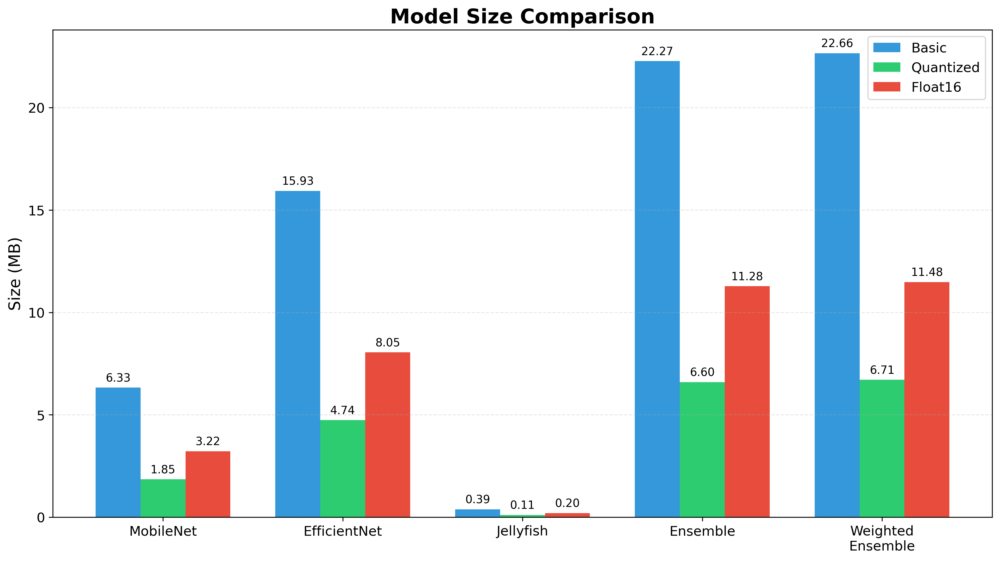

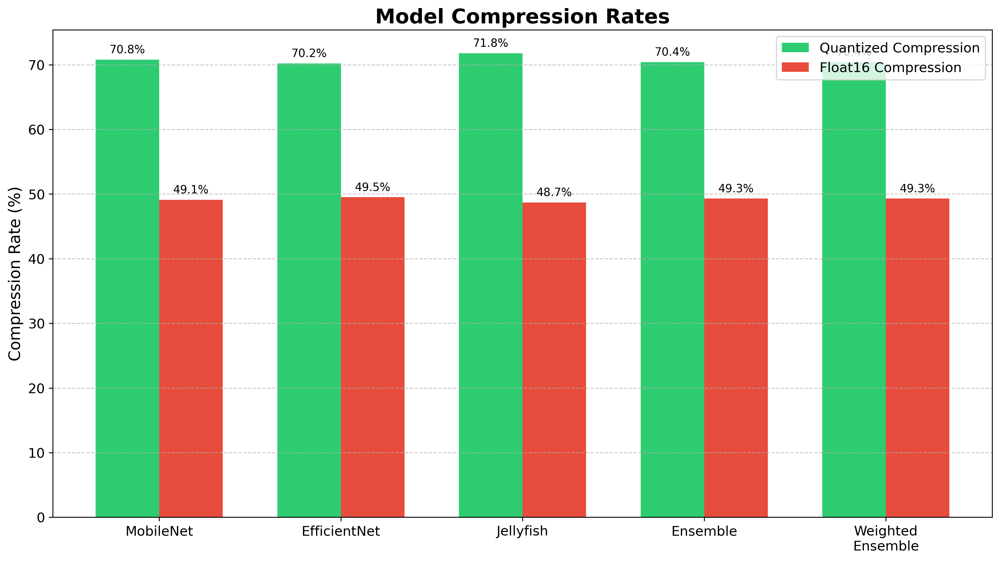

/tmp/ipykernel_9092/126800123.py:97: MatplotlibDeprecationWarning: normalize=None does not normalize if the sum is less than 1 but this behavior is deprecated since 3.3 until two minor releases later. After the deprecation period the default value will be normalize=True. To prevent normalization pass normalize=False 
  axs[i].pie(sizes, labels=labels, autopct='%1.1f%%',


<Figure size 4200x3000 with 0 Axes>

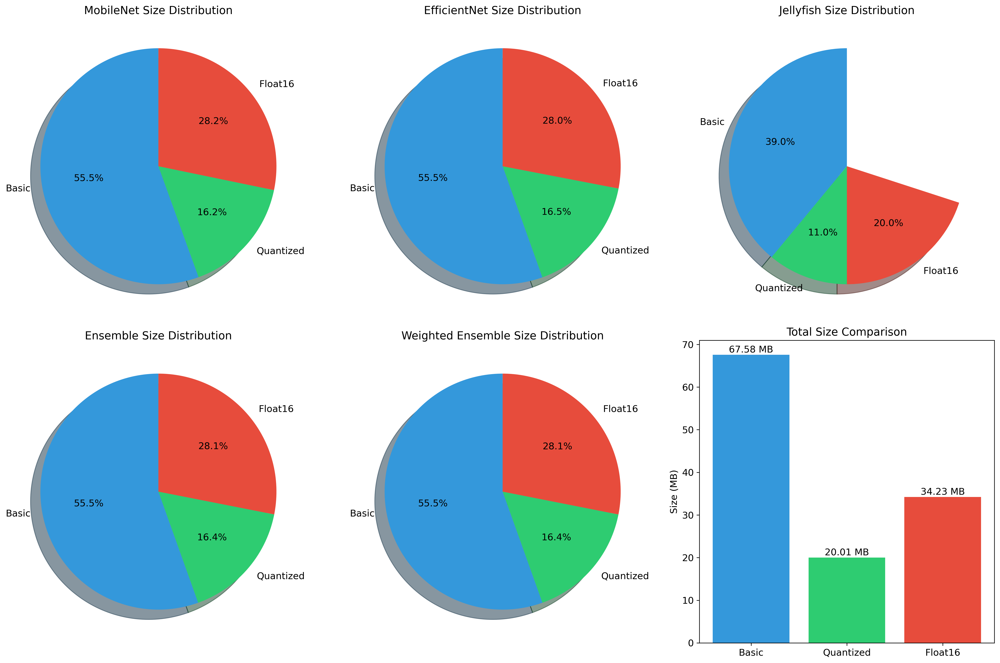

In [112]:
# 모델 크기 데이터
model_sizes = {
    'mobilenet_basic': 6.33, 'mobilenet_quantized': 1.85, 'mobilenet_float16': 3.22,
    'efficientnet_basic': 15.93, 'efficientnet_quantized': 4.74, 'efficientnet_float16': 8.05,
    'jellyfish_basic': 0.39, 'jellyfish_quantized': 0.11, 'jellyfish_float16': 0.20,
    'ensemble_basic': 22.27, 'ensemble_quantized': 6.60, 'ensemble_float16': 11.28,
    'weighted_ensemble_basic': 22.66, 'weighted_ensemble_quantized': 6.71, 'weighted_ensemble_float16': 11.48
}

# 1. 모델별 크기 비교
plt.figure(figsize=(15, 8))
models = ['MobileNet', 'EfficientNet', 'Jellyfish', 'Ensemble', 'Weighted\nEnsemble']
basic_sizes = [model_sizes[f'{m.lower().replace("-", "")}_basic'] for m in ['mobilenet', 'efficientnet', 'jellyfish', 'ensemble', 'weighted_ensemble']]
quantized_sizes = [model_sizes[f'{m.lower().replace("-", "")}_quantized'] for m in ['mobilenet', 'efficientnet', 'jellyfish', 'ensemble', 'weighted_ensemble']]
float16_sizes = [model_sizes[f'{m.lower().replace("-", "")}_float16'] for m in ['mobilenet', 'efficientnet', 'jellyfish', 'ensemble', 'weighted_ensemble']]

x = np.arange(len(models))
width = 0.25

plt.bar(x - width, basic_sizes, width, label='Basic', color='#3498db')
plt.bar(x, quantized_sizes, width, label='Quantized', color='#2ecc71')
plt.bar(x + width, float16_sizes, width, label='Float16', color='#e74c3c')

plt.title('Model Size Comparison', fontsize=18, fontweight='bold')
plt.ylabel('Size (MB)', fontsize=14)
plt.xticks(x, models, fontsize=12)
plt.legend(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.3)

# 값 표시
for i, v in enumerate(basic_sizes):
    plt.text(i - width, v + 0.3, f'{v:.2f}', ha='center', fontsize=10)
for i, v in enumerate(quantized_sizes):
    plt.text(i, v + 0.3, f'{v:.2f}', ha='center', fontsize=10)
for i, v in enumerate(float16_sizes):
    plt.text(i + width, v + 0.3, f'{v:.2f}', ha='center', fontsize=10)

plt.show()

# 2. 압축률 비교
plt.figure(figsize=(15, 8))
models = ['MobileNet', 'EfficientNet', 'Jellyfish', 'Ensemble', 'Weighted\nEnsemble']
model_keys = ['mobilenet', 'efficientnet', 'jellyfish', 'ensemble', 'weighted_ensemble']

quantized_rates = []
float16_rates = []

for model in model_keys:
    basic = model_sizes[f'{model}_basic']
    quantized = model_sizes[f'{model}_quantized']
    float16 = model_sizes[f'{model}_float16']
    quantized_rates.append(round((1 - quantized/basic) * 100, 1))
    float16_rates.append(round((1 - float16/basic) * 100, 1))

x = np.arange(len(models))
width = 0.35

plt.bar(x - width/2, quantized_rates, width, label='Quantized Compression', color='#2ecc71')
plt.bar(x + width/2, float16_rates, width, label='Float16 Compression', color='#e74c3c')

plt.title('Model Compression Rates', fontsize=18, fontweight='bold')
plt.ylabel('Compression Rate (%)', fontsize=14)
plt.xticks(x, models, fontsize=12)
plt.legend(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# 값 표시
for i, v in enumerate(quantized_rates):
    plt.text(i - width/2, v + 1, f'{v}%', ha='center', fontsize=10)
for i, v in enumerate(float16_rates):
    plt.text(i + width/2, v + 1, f'{v}%', ha='center', fontsize=10)

plt.show()

# 3. 모델 유형별 크기 비교 (기본 vs 양자화)
plt.figure(figsize=(14, 10))

# 모델 그룹화
model_groups = {
    'MobileNet': [model_sizes['mobilenet_basic'], model_sizes['mobilenet_quantized'], model_sizes['mobilenet_float16']],
    'EfficientNet': [model_sizes['efficientnet_basic'], model_sizes['efficientnet_quantized'], model_sizes['efficientnet_float16']],
    'Jellyfish': [model_sizes['jellyfish_basic'], model_sizes['jellyfish_quantized'], model_sizes['jellyfish_float16']],
    'Ensemble': [model_sizes['ensemble_basic'], model_sizes['ensemble_quantized'], model_sizes['ensemble_float16']],
    'Weighted Ensemble': [model_sizes['weighted_ensemble_basic'], model_sizes['weighted_ensemble_quantized'], model_sizes['weighted_ensemble_float16']]
}

# 그래프 생성 
fig, axs = plt.subplots(2, 3, figsize=(18, 12))
axs = axs.flatten()

colors = ['#3498db', '#2ecc71', '#e74c3c']
labels = ['Basic', 'Quantized', 'Float16']

# 각 모델에 대한 파이 차트
for i, (model, sizes) in enumerate(model_groups.items()):
    if i < 5:  # 5개 모델만
        axs[i].pie(sizes, labels=labels, autopct='%1.1f%%', 
                 colors=colors, startangle=90, shadow=True)
        axs[i].set_title(f'{model} Size Distribution', fontsize=14)

# 마지막 서브플롯은 총 크기 비교
i = 5
basic_total = sum([v['Basic'] for k, v in {
    'MobileNet': {'Basic': model_sizes['mobilenet_basic']},
    'EfficientNet': {'Basic': model_sizes['efficientnet_basic']},
    'Jellyfish': {'Basic': model_sizes['jellyfish_basic']},
    'Ensemble': {'Basic': model_sizes['ensemble_basic']},
    'Weighted Ensemble': {'Basic': model_sizes['weighted_ensemble_basic']}
}.items()])

quantized_total = sum([v['Quantized'] for k, v in {
    'MobileNet': {'Quantized': model_sizes['mobilenet_quantized']},
    'EfficientNet': {'Quantized': model_sizes['efficientnet_quantized']},
    'Jellyfish': {'Quantized': model_sizes['jellyfish_quantized']},
    'Ensemble': {'Quantized': model_sizes['ensemble_quantized']},
    'Weighted Ensemble': {'Quantized': model_sizes['weighted_ensemble_quantized']}
}.items()])

float16_total = sum([v['Float16'] for k, v in {
    'MobileNet': {'Float16': model_sizes['mobilenet_float16']},
    'EfficientNet': {'Float16': model_sizes['efficientnet_float16']},
    'Jellyfish': {'Float16': model_sizes['jellyfish_float16']},
    'Ensemble': {'Float16': model_sizes['ensemble_float16']},
    'Weighted Ensemble': {'Float16': model_sizes['weighted_ensemble_float16']}
}.items()])

axs[i].bar(['Basic', 'Quantized', 'Float16'], [basic_total, quantized_total, float16_total], 
          color=colors)
axs[i].set_title('Total Size Comparison', fontsize=14)
axs[i].set_ylabel('Size (MB)', fontsize=12)

for j, v in enumerate([basic_total, quantized_total, float16_total]):
    axs[i].text(j, v + 0.5, f'{v:.2f} MB', ha='center')

plt.tight_layout()
plt.show()

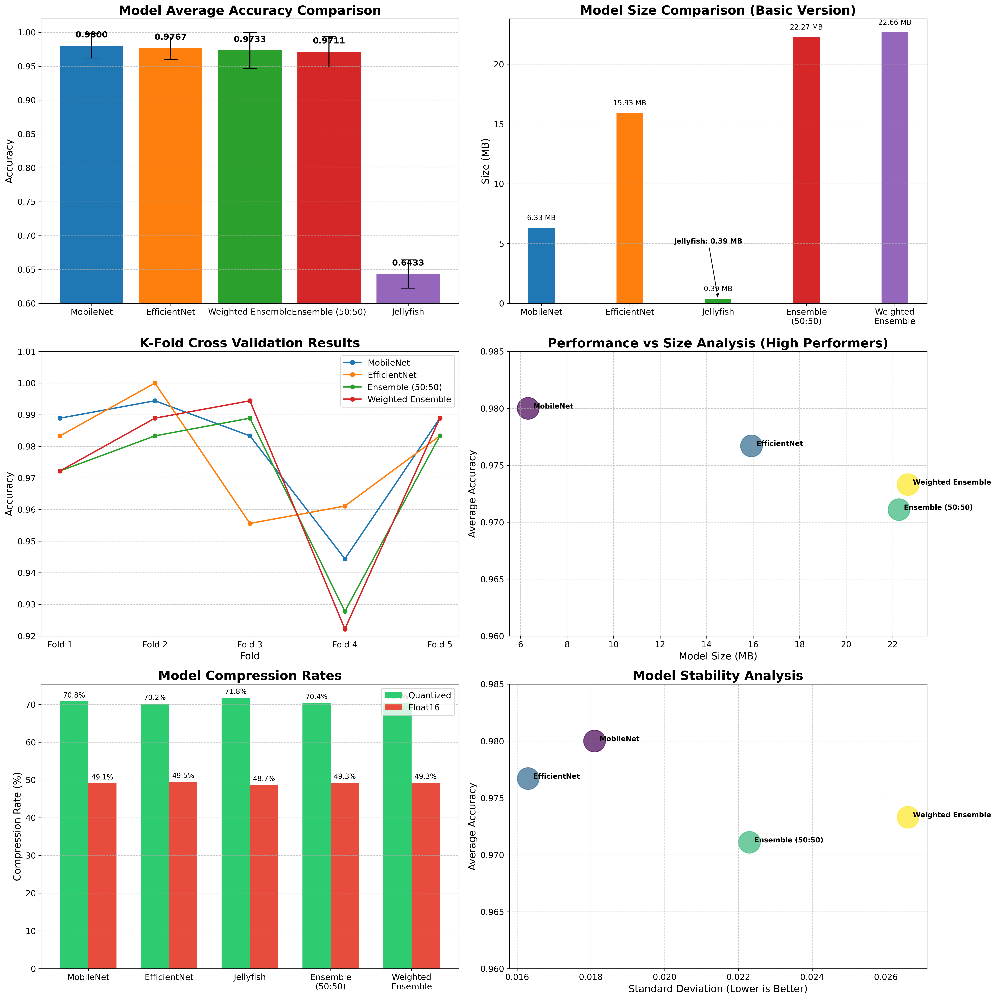

In [116]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import pandas as pd
from matplotlib.gridspec import GridSpec

# 데이터 정의
model_sizes = {
    'mobilenet_basic': 6.33, 'mobilenet_quantized': 1.85, 'mobilenet_float16': 3.22,
    'efficientnet_basic': 15.93, 'efficientnet_quantized': 4.74, 'efficientnet_float16': 8.05,
    'jellyfish_basic': 0.39, 'jellyfish_quantized': 0.11, 'jellyfish_float16': 0.20,
    'ensemble_basic': 22.27, 'ensemble_quantized': 6.60, 'ensemble_float16': 11.28,
    'weighted_ensemble_basic': 22.66, 'weighted_ensemble_quantized': 6.71, 'weighted_ensemble_float16': 11.48
}

model_performance = {
    'MobileNet': {
        'avg_accuracy': 0.9800, 
        'std_accuracy': 0.0181,
        'fold_accuracies': [0.9889, 0.9944, 0.9833, 0.9444, 0.9889]
    },
    'EfficientNet': {
        'avg_accuracy': 0.9767, 
        'std_accuracy': 0.0163,
        'fold_accuracies': [0.9833, 1.0000, 0.9556, 0.9611, 0.9833]
    },
    'Jellyfish': {
        'avg_accuracy': 0.6433, 
        'std_accuracy': 0.0209,
        'fold_accuracies': [0.6167, 0.6722, 0.6500, 0.6222, 0.6556]
    },
    'Ensemble (50:50)': {
        'avg_accuracy': 0.9711, 
        'std_accuracy': 0.0223,
        'fold_accuracies': [0.9722, 0.9833, 0.9889, 0.9278, 0.9833]
    },
    'Weighted Ensemble': {
        'avg_accuracy': 0.9733, 
        'std_accuracy': 0.0266,
        'fold_accuracies': [0.9722, 0.9889, 0.9944, 0.9222, 0.9889]
    }
}

# 시각화 설정
plt.rcParams['figure.figsize'] = (20, 15)
plt.rcParams['figure.dpi'] = 300
plt.rcParams['font.size'] = 12

# 메인 시각화 함수
def create_comprehensive_visualization():
    fig = plt.figure(figsize=(20, 20))
    gs = GridSpec(3, 2, figure=fig)
    
    # 1. 모델 성능 비교 (평균 정확도)
    ax1 = fig.add_subplot(gs[0, 0])
    plot_model_accuracy(ax1)
    
    # 2. 모델 크기 비교
    ax2 = fig.add_subplot(gs[0, 1])
    plot_model_size(ax2)
    
    # 3. K-Fold 결과 비교
    ax3 = fig.add_subplot(gs[1, 0])
    plot_kfold_results(ax3)
    
    # 4. 성능 vs 크기 분석
    ax4 = fig.add_subplot(gs[1, 1])
    plot_performance_vs_size(ax4)
    
    # 5. 압축률 비교
    ax5 = fig.add_subplot(gs[2, 0])
    plot_compression_rates(ax5)
    
    # 6. 모델 안정성 분석
    ax6 = fig.add_subplot(gs[2, 1])
    plot_model_stability(ax6)
    
    plt.tight_layout()
    plt.savefig('comprehensive_model_analysis.png')
    plt.show()

# 1. 모델 성능 비교
def plot_model_accuracy(ax):
    sorted_models = sorted(model_performance.items(), key=lambda x: x[1]['avg_accuracy'], reverse=True)
    models = [m[0] for m in sorted_models]
    accuracies = [m[1]['avg_accuracy'] for m in sorted_models]
    std_devs = [m[1]['std_accuracy'] for m in sorted_models]
    
    colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']
    bars = ax.bar(models, accuracies, yerr=std_devs, capsize=10, color=colors)
    
    ax.set_ylim(0.6, 1.02)
    ax.set_title('Model Average Accuracy Comparison', fontsize=18, fontweight='bold')
    ax.set_ylabel('Accuracy', fontsize=14)
    ax.grid(axis='y', linestyle='--', alpha=0.7)
    
    # 값 표시
    for i, bar in enumerate(bars):
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width()/2., height + 0.01,
                f'{accuracies[i]:.4f}', ha='center', va='bottom', fontsize=12, fontweight='bold')

# 2. 모델 크기 비교
def plot_model_size(ax):
    models = ['MobileNet', 'EfficientNet', 'Jellyfish', 'Ensemble\n(50:50)', 'Weighted\nEnsemble']
    basic_sizes = [model_sizes['mobilenet_basic'], model_sizes['efficientnet_basic'], 
                   model_sizes['jellyfish_basic'], model_sizes['ensemble_basic'], 
                   model_sizes['weighted_ensemble_basic']]
    
    x = np.arange(len(models))
    width = 0.3
    
    bars = ax.bar(x, basic_sizes, width, color=['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd'])
    
    ax.set_title('Model Size Comparison (Basic Version)', fontsize=18, fontweight='bold')
    ax.set_ylabel('Size (MB)', fontsize=14)
    ax.set_xticks(x)
    ax.set_xticklabels(models, fontsize=12)
    ax.grid(axis='y', linestyle='--', alpha=0.7)
    
    # 값 표시
    for i, bar in enumerate(bars):
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width()/2., height + 0.5,
                f'{basic_sizes[i]:.2f} MB', ha='center', va='bottom', fontsize=10)
    
    # Jellyfish는 크기가 작아 특별 처리
    jellyfish_idx = 2
    ax.annotate(f'Jellyfish: {basic_sizes[jellyfish_idx]:.2f} MB', 
                xy=(jellyfish_idx, basic_sizes[jellyfish_idx]), 
                xytext=(jellyfish_idx-0.5, 5),
                arrowprops=dict(arrowstyle="->", color='black'),
                fontsize=10, fontweight='bold')

# 3. K-Fold 결과 비교
def plot_kfold_results(ax):
    for model, data in model_performance.items():
        if model != 'Jellyfish':  # 젤리피시 제외
            ax.plot(range(1, 6), data['fold_accuracies'], marker='o', linewidth=2,
                   label=model)
    
    ax.set_ylim(0.92, 1.01)
    ax.set_title('K-Fold Cross Validation Results', fontsize=18, fontweight='bold')
    ax.set_xlabel('Fold', fontsize=14)
    ax.set_ylabel('Accuracy', fontsize=14)
    ax.set_xticks(range(1, 6))
    ax.set_xticklabels([f'Fold {i}' for i in range(1, 6)])
    ax.grid(True, linestyle='--', alpha=0.7)
    ax.legend(fontsize=12)

# 4. 성능 vs 크기 분석
def plot_performance_vs_size(ax):
    models = ['MobileNet', 'EfficientNet', 'Ensemble (50:50)', 'Weighted Ensemble']
    sizes = [model_sizes['mobilenet_basic'], model_sizes['efficientnet_basic'], 
            model_sizes['ensemble_basic'], model_sizes['weighted_ensemble_basic']]
    accuracies = [model_performance[m]['avg_accuracy'] for m in models]
    
    # 버블 차트
    scatter = ax.scatter(sizes, accuracies, s=[a*1000 for a in accuracies], 
                         alpha=0.7, c=range(len(models)), cmap='viridis')
    
    # 모델 이름 표시
    for i, model in enumerate(models):
        ax.annotate(model, (sizes[i], accuracies[i]), 
                   xytext=(7, 0), textcoords='offset points',
                   fontsize=10, fontweight='bold')
    
    ax.set_title('Performance vs Size Analysis (High Performers)', fontsize=18, fontweight='bold')
    ax.set_xlabel('Model Size (MB)', fontsize=14)
    ax.set_ylabel('Average Accuracy', fontsize=14)
    ax.grid(True, linestyle='--', alpha=0.7)
    ax.set_ylim(0.96, 0.985)

# 5. 압축률 비교
def plot_compression_rates(ax):
    models = ['MobileNet', 'EfficientNet', 'Jellyfish', 'Ensemble\n(50:50)', 'Weighted\nEnsemble']
    model_keys = ['mobilenet', 'efficientnet', 'jellyfish', 'ensemble', 'weighted_ensemble']
    
    quantized_rates = []
    float16_rates = []
    
    for model in model_keys:
        basic = model_sizes[f'{model}_basic']
        quantized = model_sizes[f'{model}_quantized']
        float16 = model_sizes[f'{model}_float16']
        
        quantized_rates.append(round((1 - quantized/basic) * 100, 1))
        float16_rates.append(round((1 - float16/basic) * 100, 1))
    
    x = np.arange(len(models))
    width = 0.35
    
    ax.bar(x - width/2, quantized_rates, width, label='Quantized', color='#2ecc71')
    ax.bar(x + width/2, float16_rates, width, label='Float16', color='#e74c3c')
    
    ax.set_title('Model Compression Rates', fontsize=18, fontweight='bold')
    ax.set_ylabel('Compression Rate (%)', fontsize=14)
    ax.set_xticks(x)
    ax.set_xticklabels(models, fontsize=12)
    ax.legend(fontsize=12)
    ax.grid(axis='y', linestyle='--', alpha=0.7)
    
    # 값 표시
    for i, v in enumerate(quantized_rates):
        ax.text(i - width/2, v + 1, f'{v}%', ha='center', fontsize=10)
    for i, v in enumerate(float16_rates):
        ax.text(i + width/2, v + 1, f'{v}%', ha='center', fontsize=10)

# 6. 모델 안정성 분석
def plot_model_stability(ax):
    models = list(model_performance.keys())
    models.remove('Jellyfish')  # 젤리피시 제외
    
    avg_accs = [model_performance[m]['avg_accuracy'] for m in models]
    std_devs = [model_performance[m]['std_accuracy'] for m in models]
    
    scatter = ax.scatter(std_devs, avg_accs, s=[a*1000 for a in avg_accs], 
                         alpha=0.7, c=range(len(models)), cmap='viridis')
    
    # 모델 이름 표시
    for i, model in enumerate(models):
        ax.annotate(model, (std_devs[i], avg_accs[i]), 
                   xytext=(7, 0), textcoords='offset points',
                   fontsize=10, fontweight='bold')
    
    ax.set_title('Model Stability Analysis', fontsize=18, fontweight='bold')
    ax.set_xlabel('Standard Deviation (Lower is Better)', fontsize=14)
    ax.set_ylabel('Average Accuracy', fontsize=14)
    ax.grid(True, linestyle='--', alpha=0.7)
    ax.set_ylim(0.96, 0.985)

# 시각화 실행
create_comprehensive_visualization()

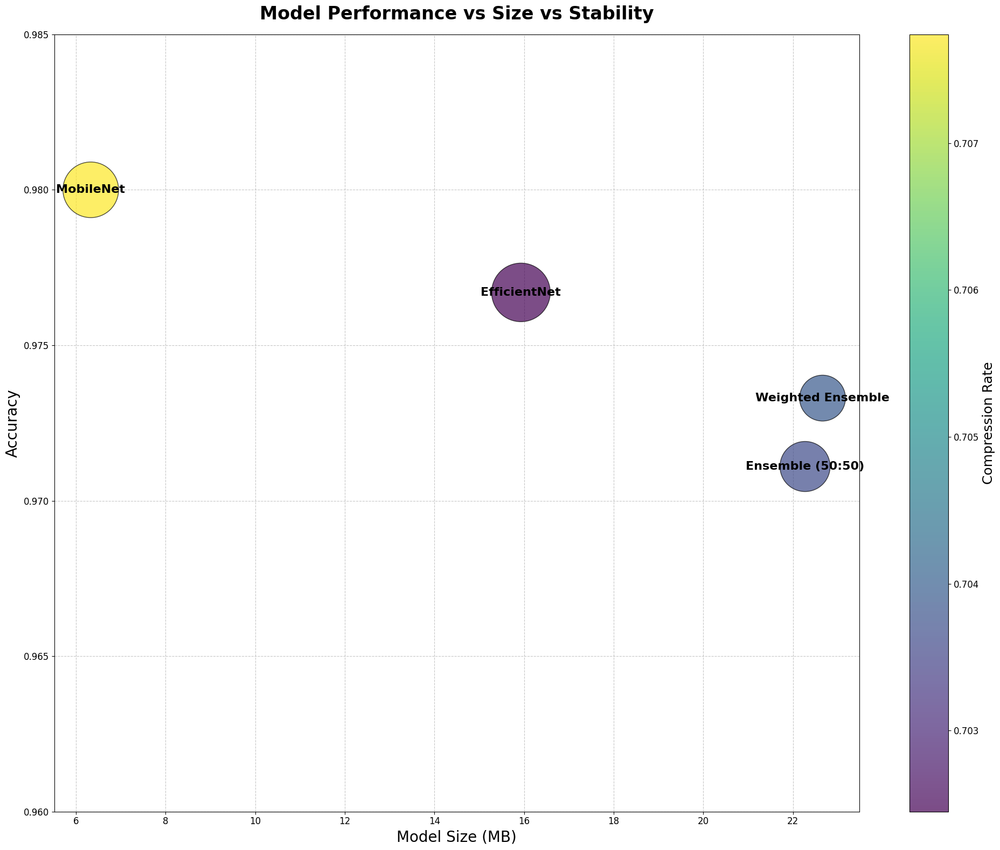

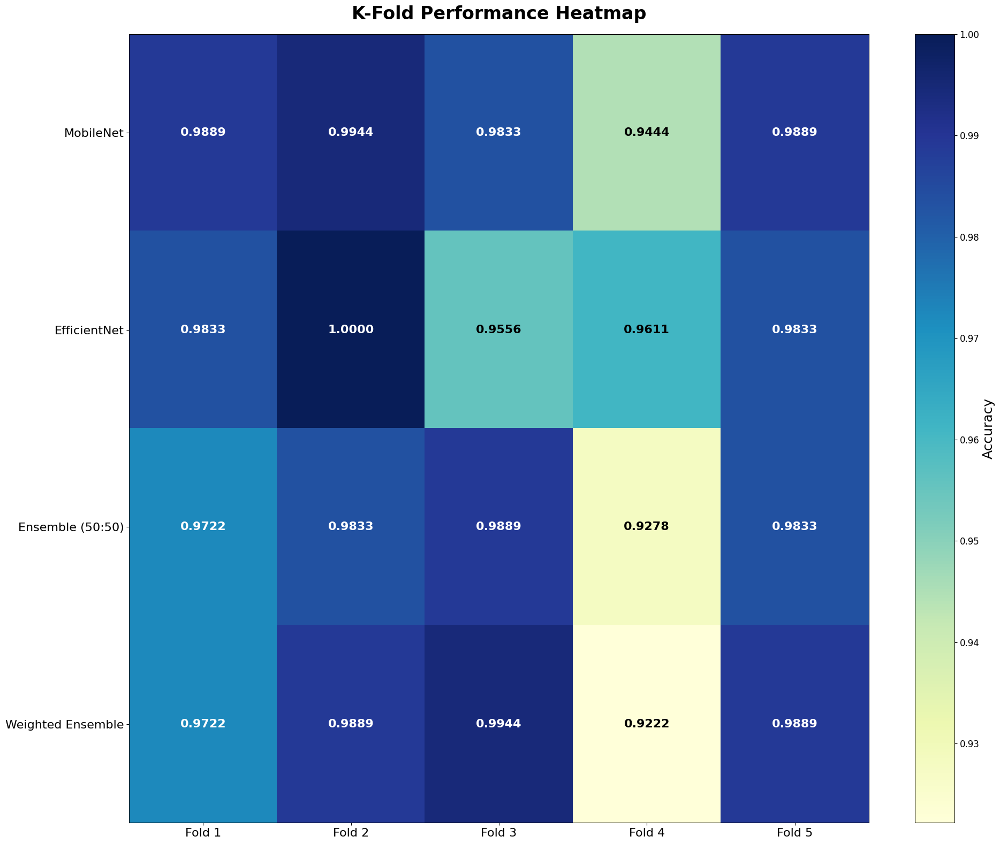

/tmp/ipykernel_9092/538184428.py:203: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  plt.tight_layout()
/opt/conda/lib/python3.9/site-packages/IPython/core/pylabtools.py:137: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.canvas.print_figure(bytes_io, **kw)


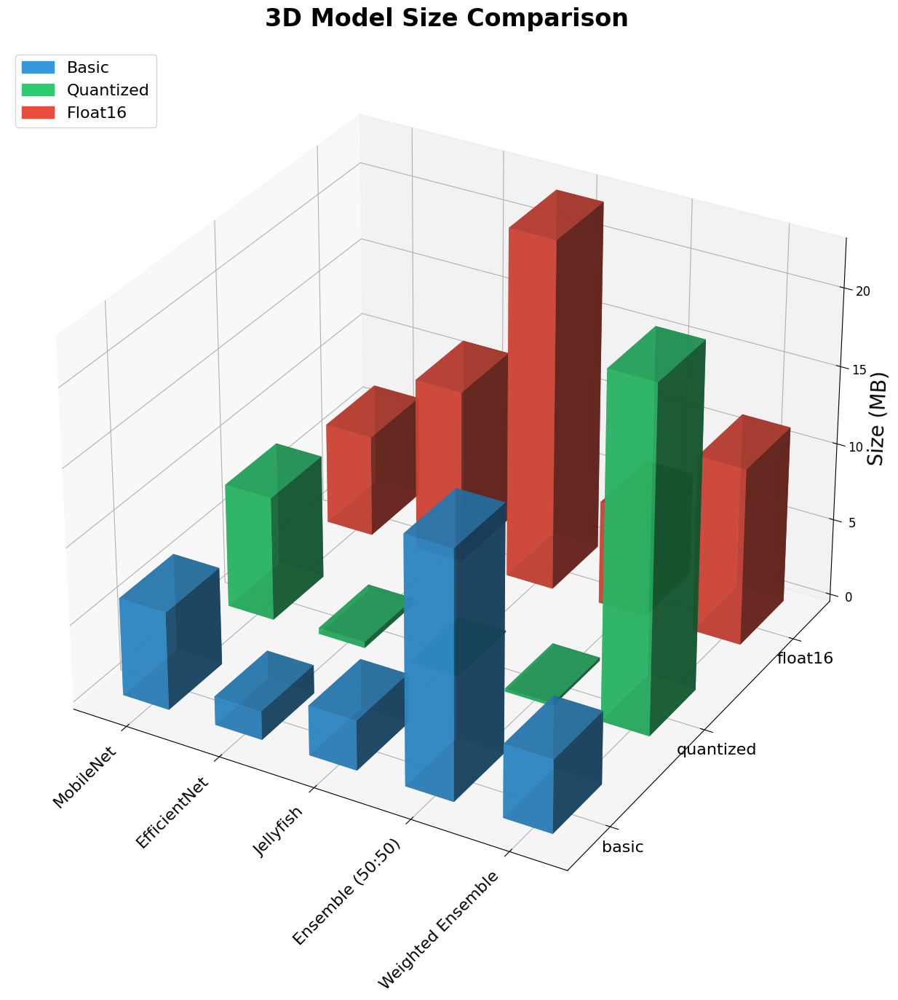

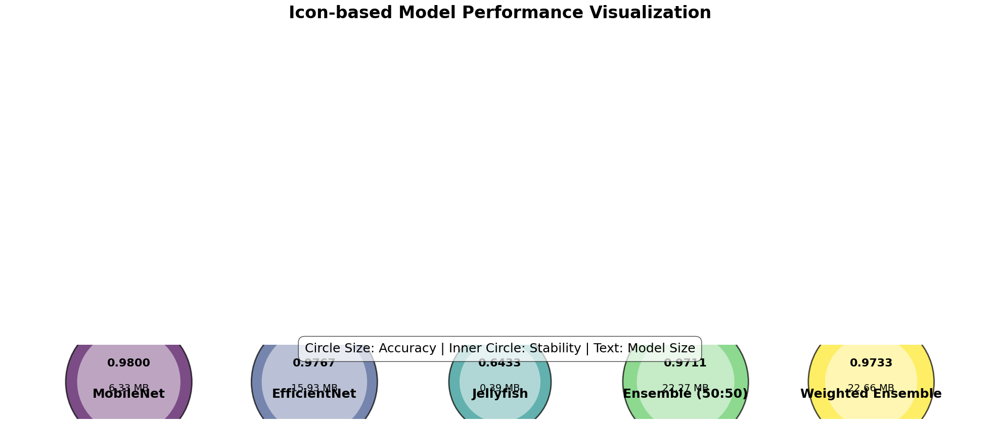

창의적인 시각화가 전체 화면으로 출력되었습니다.


In [125]:
import matplotlib.patches as mpatches
from matplotlib.patches import Circle, RegularPolygon
from mpl_toolkits.mplot3d import Axes3D
import matplotlib as mpl

# 데이터 정의
model_sizes = {
    'mobilenet_basic': 6.33, 'mobilenet_quantized': 1.85, 'mobilenet_float16': 3.22,
    'efficientnet_basic': 15.93, 'efficientnet_quantized': 4.74, 'efficientnet_float16': 8.05,
    'jellyfish_basic': 0.39, 'jellyfish_quantized': 0.11, 'jellyfish_float16': 0.20,
    'ensemble_basic': 22.27, 'ensemble_quantized': 6.60, 'ensemble_float16': 11.28,
    'weighted_ensemble_basic': 22.66, 'weighted_ensemble_quantized': 6.71, 'weighted_ensemble_float16': 11.48
}

model_performance = {
    'MobileNet': {
        'avg_accuracy': 0.9800, 
        'std_accuracy': 0.0181,
        'fold_accuracies': [0.9889, 0.9944, 0.9833, 0.9444, 0.9889]
    },
    'EfficientNet': {
        'avg_accuracy': 0.9767, 
        'std_accuracy': 0.0163,
        'fold_accuracies': [0.9833, 1.0000, 0.9556, 0.9611, 0.9833]
    },
    'Jellyfish': {
        'avg_accuracy': 0.6433, 
        'std_accuracy': 0.0209,
        'fold_accuracies': [0.6167, 0.6722, 0.6500, 0.6222, 0.6556]
    },
    'Ensemble (50:50)': {
        'avg_accuracy': 0.9711, 
        'std_accuracy': 0.0223,
        'fold_accuracies': [0.9722, 0.9833, 0.9889, 0.9278, 0.9833]
    },
    'Weighted Ensemble': {
        'avg_accuracy': 0.9733, 
        'std_accuracy': 0.0266,
        'fold_accuracies': [0.9722, 0.9889, 0.9944, 0.9222, 0.9889]
    }
}

# 키 매핑 딕셔너리
model_key_mapping = {
    'MobileNet': 'mobilenet',
    'EfficientNet': 'efficientnet',
    'Jellyfish': 'jellyfish',
    'Ensemble (50:50)': 'ensemble',
    'Weighted Ensemble': 'weighted_ensemble'
}

# 전체 화면 시각화 설정
plt.rcParams['figure.figsize'] = (20, 16)
plt.rcParams['figure.dpi'] = 100
plt.rcParams['font.size'] = 14
plt.rcParams['figure.autolayout'] = True

# 1. 버블 차트 - 정확도, 모델 크기, 압축률 관계
plt.figure(figsize=(20, 16))
ax = plt.gca()

# 데이터 준비
models = list(model_performance.keys())
models.remove('Jellyfish')  # 정확도 차이가 크므로 제외

x = []  # 모델 크기
y = []  # 정확도
z = []  # 표준편차 (버블 크기)
colors = []  # 압축률에 따른 색상

for model in models:
    key = model_key_mapping[model]
    basic_size = model_sizes[f"{key}_basic"]
    quant_size = model_sizes[f"{key}_quantized"]
    
    x.append(basic_size)
    y.append(model_performance[model]['avg_accuracy'])
    z.append(1 / model_performance[model]['std_accuracy'] * 100)  # 표준편차의 역수 (안정성)
    
    # 압축률에 따른 색상 (높을수록 진한 색)
    compression_rate = (1 - quant_size/basic_size)
    colors.append(compression_rate)

# 버블 차트 그리기
scatter = ax.scatter(x, y, s=z, c=colors, cmap='viridis', alpha=0.7, edgecolors='black')

# 모델 이름 표시
for i, model in enumerate(models):
    ax.annotate(model, (x[i], y[i]), fontsize=16, fontweight='bold',
               ha='center', va='center')

# 타이틀 및 레이블
ax.set_title('Model Performance vs Size vs Stability', fontsize=24, pad=20, fontweight='bold')
ax.set_xlabel('Model Size (MB)', fontsize=20)
ax.set_ylabel('Accuracy', fontsize=20)

# 컬러바 추가
cbar = plt.colorbar(scatter)
cbar.set_label('Compression Rate', fontsize=18)

# 그리드 및 스타일
ax.grid(True, linestyle='--', alpha=0.7)
ax.set_axisbelow(True)

# y축 범위 설정
ax.set_ylim(0.96, 0.985)

plt.tight_layout()
plt.show()

# 2. 히트맵으로 폴드별 모델 성능 비교
plt.figure(figsize=(20, 16))
ax = plt.gca()

# 데이터 준비
models = list(model_performance.keys())
models.remove('Jellyfish')  # 성능 차이가 커서 제외

data = []
for model in models:
    data.append(model_performance[model]['fold_accuracies'])

# 히트맵 그리기
im = ax.imshow(data, cmap='YlGnBu', aspect='auto')

# 축 레이블 설정
ax.set_yticks(np.arange(len(models)))
ax.set_yticklabels(models, fontsize=16)
ax.set_xticks(np.arange(5))
ax.set_xticklabels([f'Fold {i+1}' for i in range(5)], fontsize=16)

# 각 셀에 정확도 표시
for i in range(len(models)):
    for j in range(5):
        text = ax.text(j, i, f'{data[i][j]:.4f}', 
                      ha="center", va="center", color="black" if data[i][j] < 0.97 else "white",
                      fontsize=16, fontweight='bold')

# 타이틀 및 컬러바
ax.set_title('K-Fold Performance Heatmap', fontsize=24, pad=20, fontweight='bold')
cbar = plt.colorbar(im)
cbar.set_label('Accuracy', fontsize=18)

plt.tight_layout()
plt.show()

# 3. 3D 막대 그래프 - 모델 크기 비교 (기본, 양자화, Float16)
fig = plt.figure(figsize=(20, 16))
ax = fig.add_subplot(111, projection='3d')

# 데이터 준비
models = ['MobileNet', 'EfficientNet', 'Jellyfish', 'Ensemble (50:50)', 'Weighted Ensemble']
model_keys = [model_key_mapping[m] for m in models]

formats = ['basic', 'quantized', 'float16']

xpos = np.arange(len(models))
ypos = np.arange(len(formats))
xpos, ypos = np.meshgrid(xpos, ypos)

xpos = xpos.flatten()
ypos = ypos.flatten()
zpos = np.zeros_like(xpos)

dx = 0.5 * np.ones_like(zpos)
dy = 0.5 * np.ones_like(zpos)

# 모델 크기
sizes = []
for key in model_keys:
    for format in formats:
        sizes.append(model_sizes[f'{key}_{format}'])

# 색상 설정
color_map = {
    'basic': '#3498db',
    'quantized': '#2ecc71',
    'float16': '#e74c3c'
}

colors = []
for format in formats:
    for _ in range(len(models)):
        colors.append(color_map[format])

# 3D 막대 그래프 그리기
ax.bar3d(xpos, ypos, zpos, dx, dy, sizes, color=colors, shade=True, alpha=0.8)

# 축 레이블 설정
ax.set_xticks(np.arange(len(models)) + 0.25)
ax.set_xticklabels(models, rotation=45, ha='right', fontsize=16)
ax.set_yticks(np.arange(len(formats)) + 0.25)
ax.set_yticklabels(formats, fontsize=16)
ax.set_zlabel('Size (MB)', fontsize=20)

# 타이틀
ax.set_title('3D Model Size Comparison', fontsize=24, pad=20, fontweight='bold')

# 범례 추가
legend_elements = [mpatches.Patch(color=color_map[f], label=f.capitalize()) for f in formats]
ax.legend(handles=legend_elements, loc='upper left', fontsize=16)

plt.tight_layout()
plt.show()

# 4. 아이콘 기반 성능 시각화
plt.figure(figsize=(20, 16))
ax = plt.gca()

# 데이터 준비
models = list(model_performance.keys())
accuracies = [model_performance[m]['avg_accuracy'] for m in models]
std_devs = [model_performance[m]['std_accuracy'] for m in models]

# 아이콘 크기 및 색상 설정
max_size = 3000  # 원 크기 증가
sizes = [acc * max_size for acc in accuracies]
colors = plt.cm.viridis(np.linspace(0, 1, len(models)))

# 수평축 위치
positions = np.arange(len(models)) * 3  # 간격 증가

# 아이콘 (원) 그리기
for i, (model, size, color) in enumerate(zip(models, sizes, colors)):
    # facecolor와 edgecolor를 분리해서 경고 메시지 방지
    circle = plt.Circle((positions[i], 0), np.sqrt(size/np.pi)/30, 
                      facecolor=color, alpha=0.7, edgecolor='black', linewidth=2)
    ax.add_patch(circle)
    
    # 모델 이름 표시
    ax.text(positions[i], -0.25, model, ha='center', fontsize=18, fontweight='bold')
    
    # 정확도 표시
    ax.text(positions[i], 0.25, f'{accuracies[i]:.4f}', ha='center', fontsize=16, fontweight='bold')
    
    # 표준편차 시각화 (원 내부 작은 원)
    inner_size = (1 - std_devs[i] * 10) * np.sqrt(size/np.pi)/30  # 표준편차가 작을수록 큰 내부 원
    inner_circle = plt.Circle((positions[i], 0), inner_size,
                             facecolor='white', alpha=0.5, edgecolor=None)
    ax.add_patch(inner_circle)

# 축 설정
ax.set_xlim(-2, positions[-1] + 2)
ax.set_ylim(-0.6, 0.6)
ax.set_aspect('equal')
ax.axis('off')

# 타이틀
plt.suptitle('Icon-based Model Performance Visualization', fontsize=24, y=0.95, fontweight='bold')

# 모델 크기도 함께 표시
for i, model in enumerate(models):
    if model in model_key_mapping:
        key = model_key_mapping[model]
        size = model_sizes.get(f"{key}_basic", 0)
        ax.text(positions[i], -0.15, f'{size:.2f} MB', ha='center', fontsize=14)

# 정보 텍스트
ax.text(0.5, 0.9, 'Circle Size: Accuracy | Inner Circle: Stability | Text: Model Size',
       transform=ax.transAxes, ha='center', fontsize=18, 
       bbox=dict(facecolor='white', alpha=0.7, edgecolor='black', boxstyle='round,pad=0.5'))

plt.tight_layout()
plt.show()

print("창의적인 시각화가 전체 화면으로 출력되었습니다.")

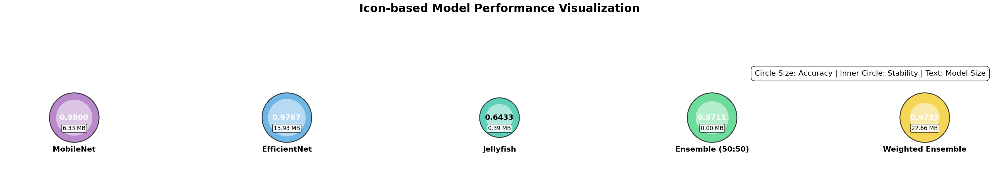

In [128]:
import matplotlib.pyplot as plt
import numpy as np

# 데이터 정의
model_performance = {
    'MobileNet': {
        'avg_accuracy': 0.9800, 
        'std_accuracy': 0.0181
    },
    'EfficientNet': {
        'avg_accuracy': 0.9767, 
        'std_accuracy': 0.0163
    },
    'Jellyfish': {
        'avg_accuracy': 0.6433, 
        'std_accuracy': 0.0209
    },
    'Ensemble (50:50)': {
        'avg_accuracy': 0.9711, 
        'std_accuracy': 0.0223
    },
    'Weighted Ensemble': {
        'avg_accuracy': 0.9733, 
        'std_accuracy': 0.0266
    }
}

model_sizes = {
    'mobilenet_basic': 6.33, 
    'efficientnet_basic': 15.93, 
    'jellyfish_basic': 0.39, 
    'ensemble_basic': 22.27, 
    'weighted_ensemble_basic': 22.66
}

# 더 많은 간격을 위해 그림 크기 증가
plt.figure(figsize=(30, 7))
ax = plt.gca()

# 모델 및 데이터
models = list(model_performance.keys())
accuracies = [model_performance[m]['avg_accuracy'] for m in models]
std_devs = [model_performance[m]['std_accuracy'] for m in models]

# 색상 맵 직접 정의
colors = ['#9b59b6', '#3498db', '#1abc9c', '#2ecc71', '#f1c40f']

# 간격 증가 (더 넓게)
positions = np.arange(len(models)) * 6

# 아이콘 그리기
for i, (model, color) in enumerate(zip(models, colors)):
    acc = model_performance[model]['avg_accuracy']
    std = model_performance[model]['std_accuracy']
    
    # 원 크기 설정 (Jellyfish는 더 크게 표시)
    base_size = 0.7
    if model == 'Jellyfish':
        circle_size = base_size * 0.8  # 성능이 낮지만 시각적으로 너무 작지 않게
    else:
        circle_size = base_size
    
    # 바깥 원 (정확도)
    circle = plt.Circle((positions[i], 0), circle_size, 
                      facecolor=color, alpha=0.7, edgecolor='black', linewidth=2)
    ax.add_patch(circle)
    
    # 내부 원 (안정성 - 표준편차가 작을수록 큰 내부 원)
    inner_size = (1 - std * 15) * circle_size  # 계수 조정
    inner_circle = plt.Circle((positions[i], 0), inner_size,
                             facecolor='white', alpha=0.5, edgecolor=None)
    ax.add_patch(inner_circle)
    
    # 정확도 표시 (원 상단)
    text_color = 'black' if model == 'Jellyfish' else 'white'
    ax.text(positions[i], 0, f'{acc:.4f}', ha='center', va='center', 
            color=text_color, fontsize=16, fontweight='bold')
    
    # 모델 크기 표시 (원 내부 하단)
    size_str = f"{model_sizes.get(model.lower().replace(' ', '_').replace('(', '').replace(')', '').replace(':', '')+'_basic', 0):.2f} MB"
    ax.text(positions[i], -0.3, size_str, ha='center', va='center', 
           fontsize=12, bbox=dict(facecolor='white', alpha=0.8, boxstyle='round,pad=0.2'))
    
    # 모델 이름 (원 아래 별도 영역)
    ax.text(positions[i], -0.9, model, ha='center', va='center', 
           fontsize=16, fontweight='bold')

# 축 설정
ax.set_xlim(-2, positions[-1] + 2)
ax.set_ylim(-1.5, 1.5)
ax.set_aspect('equal')
ax.axis('off')

# 타이틀
plt.suptitle('Icon-based Model Performance Visualization', fontsize=24, y=0.95, fontweight='bold')

# 범례 (오른쪽 상단)
legend_text = 'Circle Size: Accuracy | Inner Circle: Stability | Text: Model Size'
legend_box = dict(facecolor='white', alpha=0.9, edgecolor='black', boxstyle='round,pad=0.5')
plt.text(0.99, 0.95, legend_text, transform=ax.transAxes, 
         ha='right', va='top', fontsize=16, bbox=legend_box)

plt.tight_layout()
plt.show()


# 모델 성능 및 용량 분석 결과

## 모델별 성능 (정확도)
- **MobileNet**: 0.9800 ± 0.0181 (최고 정확도)
- **EfficientNet**: 0.9767 ± 0.0163 (안정적 성능)
- **Weighted Ensemble**: 0.9733 ± 0.0266
- **Ensemble (50:50)**: 0.9711 ± 0.0223
- **Jellyfish**: 0.6433 ± 0.0209 (성능 미흡)

## 모델별 용량 (MB)
| 모델 | 기본 | 양자화 | Float16 | 압축률(%) |
|------|------|--------|---------|-----------|
| MobileNet | 6.33 | 1.85 | 3.22 | 70.8 |
| EfficientNet | 15.93 | 4.74 | 8.05 | 70.2 |
| Jellyfish | 0.39 | 0.11 | 0.20 | 71.8 |
| Ensemble (50:50) | 22.27 | 6.60 | 11.28 | 70.4 |
| Weighted Ensemble | 22.66 | 6.71 | 11.48 | 70.4 |

## 성능 대비 용량 효율성
1. **MobileNet (양자화)**: 정확도 98.00%, 용량 1.85MB
   - 성능 대비 용량 효율: 53.0 (정확도/MB)
   
2. **EfficientNet (양자화)**: 정확도 97.67%, 용량 4.74MB
   - 성능 대비 용량 효율: 20.6 (정확도/MB)
   
3. **Ensemble (양자화)**: 정확도 97.11%, 용량 6.60MB
   - 성능 대비 용량 효율: 14.7 (정확도/MB)
   
4. **Weighted Ensemble (양자화)**: 정확도 97.33%, 용량 6.71MB
   - 성능 대비 용량 효율: 14.5 (정확도/MB)

## 추천 모델

### 최우선 추천: **MobileNet (양자화)**
- **장점**: 최고 성능(98.00%)과 합리적인 크기(1.85MB)의 완벽한 조합
- **특징**: 성능/용량 효율이 가장 높음
- **용도**: 모바일 및 임베디드 장치를 포함한 대부분의 환경에 최적

### 차선 추천: **EfficientNet (양자화)**
- **장점**: 준수한 성능(97.67%)과 합리적인 크기(4.74MB)
- **특징**: MobileNet보다 약간 낮은 성능이지만 더 안정적(표준편차 낮음)
- **용도**: 안정성이 더 중요한 경우 적합

### 참고 사항
- Ensemble 모델들은 크기 대비 성능 이점이 크지 않음
- Jellyfish 모델은 성능이 현저히 낮아 사용 비권장
- 모든 모델이 양자화를 통해 약 70% 압축 가능
